In [104]:
import time, sys
from typing import Type, List, Dict, Tuple, Set
import argparse
try:
    from sklearn.externals import joblib
    from sklearn.externals.joblib import parallel_backend, Parallel, delayed
except ImportError:
    import joblib
    from joblib import parallel_backend, Parallel, delayed
    
import pandas as pd
import json, ijson
import os, sys, uuid
from pykalman import KalmanFilter
from PIL import Image
import matplotlib.patheffects as path_effects

import math
import ast
import os
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from shapely.geometry import Polygon, Point
from shapely.geometry import Polygon
from matplotlib.backends.backend_pdf import PdfPages
from geopy.distance import geodesic, distance
from geopy import Point
from shapely.geometry import Point, Polygon as ShapelyPolygon
from matplotlib.patches import Polygon as MplPolygon

from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.metrics import accuracy_score, confusion_matrix
from datetime import datetime
import random

from matplotlib.patches import Polygon
import ast

from collections import defaultdict
import pyarrow.parquet as pq

import pickle
from ast import literal_eval

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.colors as mcolors

import matplotlib.image as mpimg

from tqdm.notebook import tqdm, trange
from scipy.optimize import minimize
from scipy.optimize import least_squares

from os import walk
from os import listdir
from os.path import isfile, join, isdir

import scipy.optimize as opt
from shapely.geometry import Polygon
from shapely.geometry import Polygon

from PIL import Image
from matplotlib.patches import Polygon

from sklearn import model_selection
from sklearn.pipeline import Pipeline
from sklearn.model_selection import train_test_split, cross_val_score, KFold
from sklearn.linear_model import LinearRegression, LogisticRegression, SGDClassifier
from sklearn.feature_selection import SelectKBest, mutual_info_classif
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, VotingClassifier, GradientBoostingClassifier, BaggingClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, ConfusionMatrixDisplay

import warnings
warnings.filterwarnings("ignore")

In [106]:
start =time.time()
CHANNELS = [37,38,39]
N_ESTIMATORS = 100
MISSING_VALUE = -100
DEBUG_LOGGING = False
S3_CACHING_BUCKET = 'cognosos-ml-data'

In [108]:
def train_variable(X_train, y_train_floor, y_train, save_models=False):
    
    floor_pipeline = Pipeline([
        ('rf', RandomForestClassifier(random_state=42))
    ])

    floor_pipeline.fit(X_train, y_train_floor)

    clf_floor = floor_pipeline.named_steps['rf']

    clf_rooms = {}

    selected_features = {}

    for floor_num, samples in X_train.groupby(y_train_floor):
        
        floor_labels = y_train[samples.index]

        non_all_neg_120_columns = samples.columns[~np.all(samples == -120, axis=0)]

        selected_samples = samples[non_all_neg_120_columns]

        classifier = RandomForestClassifier(n_estimators=200, random_state=100)

        classifier.fit(selected_samples, floor_labels)

        clf_rooms[str(floor_num)] = classifier

        selected_features[str(floor_num)] = selected_samples.columns.tolist()

    if save_models:
        model = {
        'selected_features': selected_features,
        'clf_rooms': clf_rooms,
        'clf_floor': clf_floor
        }
        joblib.dump(model, 'Hier_Features.joblib')
        
    return selected_features, clf_rooms, clf_floor

def predict_variable(X_test, clf_floor, clf_rooms, selected_features):
    
    predicted_floors = clf_floor.predict(X_test)

    predictions = []
    for floor_num, sample in zip(predicted_floors, X_test.values):
        classifier = clf_rooms[str(floor_num)]

        selected_names = selected_features[floor_num]

        selected_sample = sample[X_test.columns.isin(selected_names)].reshape(1, -1)

        predicted_room = classifier.predict(selected_sample)[0]
#         predicted_room = predicted_room.astype(str)
        predictions.append(predicted_room)

    return predictions, predicted_floors

In [110]:
def parse_scan_data_woc(scan: List[Dict]) -> Dict:
    # Parse each scan to get maximum reading for each MAC address in specified channels
    readings_by_mac_addr_and_channel = defaultdict(list)
    for beacon_reading in scan:
        if beacon_reading['channel'] in CHANNELS:
            mac_addr = beacon_reading['macHex']
            readings = beacon_reading['readings']
            readings_by_mac_addr_and_channel[mac_addr] += readings
    return {mac_addr: int(max(readings)) for mac_addr, readings in readings_by_mac_addr_and_channel.items() if readings}


def process_training(data_filepath: str) -> List[Dict]:
    X = []

    # parse it incrementally
    with open(data_filepath, 'r') as f:
        # reads the JSON incrementally
        objects = ijson.items(f, 'item') 

        print('Done loading JSON incrementally')

        for scan in objects:
            
            Zone_id = str(scan['zoneId'])
            Room_name = str(scan['zoneName'])
            parent_zone_id = str(scan['parentZoneId'])
            tagId = scan['tagId']
            timestamp = scan['rxAt']
            scan_readings: List[Dict] = scan['scandata']
            
            row = parse_scan_data_woc(scan_readings) 

            row.update({
                'Zone_id': Zone_id,
                'Room_name': Room_name,
                'parent_zone_id': parent_zone_id,
                'tagId': tagId,
                'timestamp': timestamp,
            })

            if row:
                X.append(row)

    print('Done processing data')

    return X

In [112]:
def extract_values(scan_data):

    if scan_data is None:
        return []
    return [
        {'macHex': entry['macHex'], 'channel': entry['channel'], 'readings': [entry['rssi'][0]]}
        for entry in scan_data if 'macHex' in entry and 'rssi' in entry
    ]

def parse_scan_data(scan: List[Dict]) -> Dict:

    readings_by_mac_addr_and_channel = defaultdict(list)
    for beacon_reading in scan:
        if beacon_reading['channel'] in CHANNELS:
            mac_addr = beacon_reading['macHex']
            readings = beacon_reading['readings']
            channel = beacon_reading['channel']
            readings_by_mac_addr_and_channel[f'{mac_addr}'] += readings#-{channel}
    return {mac_addr: max(readings) for mac_addr, readings in readings_by_mac_addr_and_channel.items() if len(readings) > 0 }

In [114]:
with open("UVAHEAUNIMEDCEN_SITEUVA_WH935_beacons_updated_REAL.json", "r") as f:   
    data = json.load(f)

beacon_df = pd.DataFrame(data["bleBeacons"])

beacon_df = beacon_df.rename(columns={
    "serialNumber": "Dec",
    "latitude": "y",
    "longitude": "x"
})[["Dec", "x", "y"]]
beacon_df["Mac"] = beacon_df["Dec"].astype(int).apply(lambda x: hex(x)[2:].zfill(12).lower())
# beacon_df.to_csv("Beacon_map.csv", index=False)
beacon_df.head(1)

,Dec,x,y,Mac
0,1995001537,-78.497136,38.030996,000076e94ec1


In [116]:
# data

In [118]:
# with open("geo/UVA_Health_Medical_Center_Walls.geojson") as f:
#     geojson_boundary = json.load(f)
# geojson_boundary

In [120]:
zones= pd.read_csv("UVA_zones.csv")
zones= zones.rename(columns={"ID":"Zone_id", "Zone Name": "Room_name"})
zones=zones[["Zone_id", "Room_name", "Room_Type", "Latitude", "Longitude"]]
zones.Zone_id= zones.Zone_id.astype(str)
zones.head(1)

,Zone_id,Room_name,Room_Type,Latitude,Longitude
0,37982,G224-1,Open,38.03102,-78.497523


In [122]:
with open("geo/UVAHEAUNIMEDCEN_SITEUVA_WH935-Ground Floor.geojson") as f:
    geojson_data = json.load(f)
# geojson_data

In [124]:
rows = []
for feature in geojson_data['features']:
    room_number = feature['properties']['RoomNumber']
    room_type = feature['properties'].get('RoomType', None)
    coords = feature['geometry']['coordinates'][0]  # first polygon ring
    
    # Flatten coordinates: x1,y1, x2,y2, ...
    coord_dict = {}
    for i, (x, y) in enumerate(coords, start=1):
        coord_dict[f'x{i}'] = x
        coord_dict[f'y{i}'] = y
    
    row = {'Room_name': room_number}
    row.update(coord_dict)
    rows.append(row)

df_rooms = pd.DataFrame(rows)
df_rooms.to_csv("Ground_truth.csv", index=False)
df_rooms.head(1)

,Room_name,x1,y1,x2,y2,x3,y3,x4,y4,x5,...,x20,y20,x21,y21,x22,y22,x23,y23,x24,y24
0,G224E,-78.497565,38.030929,-78.497565,38.030928,-78.497566,38.030928,-78.497562,38.030919,-78.497562,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [126]:
df_rooms.shape

(27, 49)

In [128]:
# beacon_df.to_csv("Beacon_Map_Original.csv", index=False)

### Try with some blocked beacon to test accuracy

In [131]:
anchor_point_df= pd.read_csv("Beacon_map_with_Block.csv")
anchor_point_df.head(1)

,Dec,x,y,Mac,Blocked
0,1995001537,-78.497136,38.030996,000076e94ec1,block


In [133]:
anchor_point_df[anchor_point_df.Blocked=="block"]["Mac"].unique()

array(['000076e94ec1', '000076e952c6', '000076e95467', '000076e957bc',
       '000076e957c0', '000076e95f0c', '000076e95f0e', '000076e960e5'],
      dtype=object)

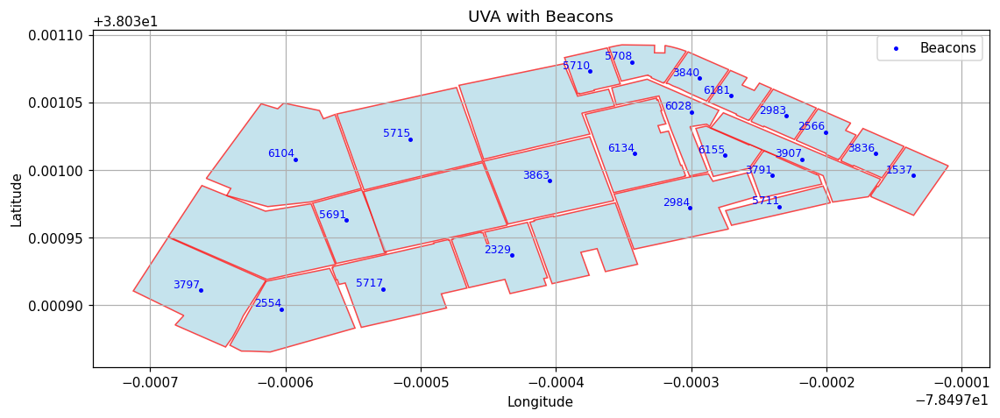

In [135]:
# anchor_point_df= anchor_point_df[anchor_point_df.Blocked!="block"]
# anchor_point_df= beacon_df.copy()

plt.close('all')
plt.rcParams['figure.dpi'] = 110

fig, ax = plt.subplots(figsize=(12, 12))

from matplotlib.patches import Polygon

# --- Draw rooms ---
for _, row in df_rooms.iterrows():
    coords = []
    for i in range(1, 24):  
        xcol, ycol = f"x{i}", f"y{i}"
        if xcol in row and ycol in row:
            x, y = row[xcol], row[ycol]
            if pd.notnull(x) and pd.notnull(y):
                try:
                    coords.append((float(x), float(y)))
                except ValueError:
                    continue
    if len(coords) >= 3:
        ax.add_patch(Polygon(coords, closed=True,
                     edgecolor='r',
                     facecolor='lightblue',
                     alpha=0.7,
                     zorder=1))


# --- Draw beacons ---
beacon_x = pd.to_numeric(anchor_point_df["x"], errors='coerce')
beacon_y = pd.to_numeric(anchor_point_df["y"], errors='coerce')
ax.scatter(beacon_x, beacon_y, marker="o", s=5,
           label="Beacons", color="blue", zorder=2)

for _, r in anchor_point_df.iterrows():
    try:
        bx = float(r["x"])
        by = float(r["y"])
        ax.text(bx, by, str(r["Dec"])[-4:], fontsize=8,
                ha="right", va="bottom", color="blue", zorder=3)
    except (ValueError, TypeError):
        continue

# --- Axis limits from both rooms and beacons ---
room_x = pd.to_numeric(df_rooms[[f"x{i}" for i in range(1,24)]].to_numpy().ravel(), errors='coerce')
room_y = pd.to_numeric(df_rooms[[f"y{i}" for i in range(1,24)]].to_numpy().ravel(), errors='coerce')

all_x = np.concatenate([room_x, beacon_x.to_numpy()])
all_y = np.concatenate([room_y, beacon_y.to_numpy()])
all_x = all_x[~np.isnan(all_x)]
all_y = all_y[~np.isnan(all_y)]

if len(all_x) > 1 and len(all_y) > 1:
    xmin, xmax = np.min(all_x), np.max(all_x)
    ymin, ymax = np.min(all_y), np.max(all_y)
    pad_x = max((xmax - xmin) * 0.05, 1e-7)
    pad_y = max((ymax - ymin) * 0.05, 1e-7)
    ax.set_xlim(xmin - pad_x, xmax + pad_x)
    ax.set_ylim(ymin - pad_y, ymax + pad_y)
else:
    ax.autoscale()
    ax.margins(0.05)

# --- Style ---
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.set_title("UVA with Beacons")
ax.set_aspect('equal', adjustable='box')
ax.grid(True)
ax.legend()

In [137]:
anchor_point_df.shape

(23, 5)

In [139]:
def create_digital_twin(Anchor_point_location_file, ground_truth_file_location, map_file_location):

    anchor_df = pd.read_csv(Anchor_point_location_file)
    anchor_df["x"] = anchor_df["x"].astype(int)
    anchor_df["y"] = anchor_df["y"].astype(int)
    macLists = anchor_df['Mac'].to_list()

    ground_truth_df = pd.read_csv(ground_truth_file_location)
    ground_truth_df["Zone_id"] = ground_truth_df["Zone_id"].astype(str)
    
    #create a empty map with 0s for future calculation
    map_ = np.zeros((65,28))

    plt.figure(figsize=(12, 6))
    
    image = Image.open(map_file_location)
    
    plt.scatter(anchor_df.x,anchor_df.y, color='blue', s=50, edgecolors='black', label='Beacons', marker='o', alpha=0.6)

#     plt.scatter(ground_truth_df["x"], ground_truth_df["y"], color='red', s=20, label='Ground Truth', marker='^')
#     for i, label in enumerate(ground_truth_df['Room_name']):  
#         plt.text(ground_truth_df['x'][i], ground_truth_df['y'][i], label, fontsize=9, color='w', ha='right', va='bottom')
    plt.imshow(image, extent=[0, 65, 0, 28], aspect='auto')

    plt.xlim(0, 65)
    plt.ylim(0, 28)

    plt.grid(True)
    plt.xticks([i for i in range(0, 65, 5)])
    plt.yticks([i for i in range(0, 28, 4)])
    plt.xlabel('x', fontsize=14)
    plt.ylabel('y', fontsize=14)
    plt.title("Beacon distribution in meters")
    plt.legend()
    plt.savefig('beacon_map_cognosos.png')

    return anchor_df, ground_truth_df, map_

In [141]:
def filter_valid_features(row, df1):

    valid_features = {}
    
    for mac in df1['Mac']:
       
        if mac in row.index and isinstance(row[mac], (int, float)) and row[mac] != -100:
            valid_features[mac] = row[mac]
    
    return valid_features

def convert_coordinates(coord_str):
    if isinstance(coord_str, str):
       
        try:
            coord_str = coord_str.strip("[]")
            elements = coord_str.split()
            return [float(elem) for elem in elements] 
        except ValueError:
            pass  

        try:
            coord_str = coord_str.replace(" ", ",")
            coord_str = coord_str.replace(",,", ",")
            coord_str = coord_str.strip(',')
            return ast.literal_eval(coord_str)
        except (ValueError, SyntaxError) as e:
            print(f"Error processing coordinate string: {coord_str}")
            return None
    else:
        return coord_str

In [143]:
def plot_building_with_zone_accuracy(
    df_rooms,
    results_df,
    pred_col="Predicted_Optimisation",
    result_rf=None,   
):
    # --- Build polygons for each room ---
    room_coords_dict = {}
    for _, row in df_rooms.iterrows():
        coords = []
        for i in range(1, 25):
            xcol, ycol = f"x{i}", f"y{i}"
            if xcol in row and ycol in row:
                x, y = row[xcol], row[ycol]
                if pd.notnull(x) and pd.notnull(y):
                    coords.append((float(x), float(y)))
        if len(coords) >= 3:
            room_coords_dict[row['Room_name']] = coords

    unique_rooms = results_df['Room_name'].unique()
    n_rows = math.ceil(len(unique_rooms) / 2)
    fig, axes = plt.subplots(n_rows, 2, figsize=(12, 3 * n_rows))
    axes = axes.flatten()
    
    summary_records = []

    # --- Precompute full building limits ---
    all_coords = np.array([pt for coords in room_coords_dict.values() for pt in coords])
    xmin, xmax = all_coords[:,0].min() - 0.00001, all_coords[:,0].max() + 0.00001
    ymin, ymax = all_coords[:,1].min() - 0.00001, all_coords[:,1].max() + 0.00001

    # --- If result_rf is provided, prepare lookup dict ---
    room_acc_dict = None
    if result_rf is not None and "Room_name" in result_rf and "Accuracy" in result_rf:
        room_acc_dict = dict(zip(result_rf['Room_name'], result_rf['Accuracy']))

    for i, r in enumerate(unique_rooms):
        ax = axes[i]
        ax.set_aspect('equal')
        ax.grid(False)  
        ax.set_xlim(xmin, xmax)
        ax.set_ylim(ymin, ymax)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xlabel('')
        ax.set_ylabel('')
        
        # --- Plot all polygons lightly ---
        for room_name, coords in room_coords_dict.items():
            if room_name == r:
                edge_color = 'red'
                face_color = 'none'  # transparent for current room
                linewidth = 3
            else:
                edge_color = 'black'
                face_color = 'lightgray'
                linewidth = 1
            ax.add_patch(MplPolygon(coords, closed=True,
                                    edgecolor=edge_color, facecolor=face_color,
                                    alpha=0.3, zorder=1, linewidth=linewidth))

        if r not in room_coords_dict:
            ax.set_title(f"{r} (no polygon)")
            continue

        # --- Get polygon for current zone ---
        polygon = ShapelyPolygon(room_coords_dict[r])
        if not polygon.is_valid:
            polygon = polygon.buffer(0)

        # --- Get predictions ---
        room_data = results_df[results_df['Room_name'] == r]
        pred_x, pred_y, inside_flags = [], [], []

        for coord in room_data[pred_col]:
            if isinstance(coord, str):
                coord = ast.literal_eval(coord)
            if coord is None or len(coord) != 2:
                continue
            lon, lat = float(coord[1]), float(coord[0])  # swap to lon/lat
            pred_x.append(lon)
            pred_y.append(lat)
            inside_flags.append(Point(lon, lat).within(polygon))

        # --- Scatter predictions ---
        ax.scatter(pred_x, pred_y,
                   c=['green' if f else 'blue' for f in inside_flags],
                   s=3, marker='o', zorder=5)
        
        # --- Scatter beacon locations (always required) ---
        ax.scatter(beacon_x, beacon_y,
                   marker="o",
                   s=15,
                   color="red",
                   label="Beacons",
                   zorder=3)

        # --- Accuracy ---
        inside_count = sum(inside_flags)
        total_points = len(inside_flags)
        acc = (inside_count / total_points * 100) if total_points else 0

        record = {
            "Room_name": r,
            "Total_Points": total_points,
            "Inside_Points": inside_count,
            "Accuracy": acc
        }

        # --- external accuracy if available ---
        ext_acc = room_acc_dict.get(r, None) if room_acc_dict else None
        if ext_acc is not None:
            record["LocationAI_Accuracy"] = ext_acc

        summary_records.append(record)

        # --- Pick label for pred_col ---
        if pred_col.lower().endswith("optimisation".lower()):
            pred_label = "Optimisation"
        elif pred_col.lower().endswith("mle".lower()):
            pred_label = "MLE"
        else:
            pred_label = pred_col  # fallback: use raw column name

        # --- Set title ---
        if ext_acc is not None:
            ax.set_title(f"{r} - {pred_label}: {acc:.1f}% | LocationAI: {ext_acc:.1f}%")
        else:
            ax.set_title(f"{r} - {pred_label}: {acc:.1f}%")

       
    # Remove unused axes
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()
    
    summary_df = pd.DataFrame(summary_records)

    # Calculate overall accuracy
    total_inside = summary_df['Inside_Points'].sum()
    total_points = summary_df['Total_Points'].sum()
    overall_accuracy = (total_inside / total_points * 100) if total_points > 0 else 0

    print(f"Overall Accuracy: {overall_accuracy:.2f}%")

    return summary_df


In [145]:
def read_MLE_data_survey_portal(df, ground_truth_df, anchor_point_df, export_unheard=False, export_path="unheard_anchor_points.csv"):

    # I ADD THIS TO Ensure MAC addresses are strings and zero-padded to length 12
    anchor_point_df['Mac'] = anchor_point_df['Mac'].astype(str).str.zfill(12)

    data_set_df = pd.DataFrame()
    merged_df = pd.merge(df, ground_truth_df, on=["Zone_id", 'Room_name'], how='inner').drop(['parent_zone_id'], axis=1)
    zones = df['Zone_id']
    heard_anchor_points = []

    for mac_addr in anchor_point_df['Mac']:
        if mac_addr in merged_df.columns:
            data_set_df[mac_addr] = merged_df[mac_addr]
            heard_anchor_points.append(mac_addr)

    heard_anchor_point_df = anchor_point_df[anchor_point_df['Mac'].isin(heard_anchor_points)].reset_index(drop=True)
    unheard_anchor_point_df = anchor_point_df[~anchor_point_df['Mac'].isin(heard_anchor_points)].reset_index(drop=True)

    heard_anchor_points_coord = heard_anchor_point_df[['x', 'y']].values

    data_set_df["Zone_id"] = merged_df["Zone_id"]
    data_set_df["Room_name"] = merged_df["Room_name"]
    data_set_df["tagId"] = merged_df["tagId"]
    data_set_df["timestamp"] = merged_df["timestamp"]
    if "channel" in merged_df.columns:
        data_set_df["channel"] = merged_df["channel"]
    
    data_set_df["x"] = merged_df["x"]
    data_set_df["y"] = merged_df["y"]

    return data_set_df, heard_anchor_points_coord, unheard_anchor_point_df

In [147]:
filepath = "data.json"
X1 = process_training(filepath)
df1 = pd.DataFrame(X1)
df1 = df1.fillna(MISSING_VALUE)  
    
float_cols = df1.select_dtypes(include=['float']).columns
df1[float_cols] = df1[float_cols].astype(np.int8)
df1['timestamp'] = pd.to_datetime(df1['timestamp'], utc=True, errors='coerce')
df1 = df1.sort_values(by='timestamp')

ordered_columns = ['timestamp', 'tagId', 'parent_zone_id', 'Zone_id', 'Room_name']

columns = [col for col in df1.columns if col not in ordered_columns]

new_column_order = columns + ordered_columns

df1 = df1.reindex(columns=new_column_order)
df1= df1.reset_index(drop=True)

Done loading JSON incrementally
Done processing data


In [149]:
mac_features = anchor_point_df['Mac'].tolist()

last_5_cols = df1.columns[-5:].tolist()

columns_to_keep = [col for col in df1.columns if col in mac_features or col in last_5_cols]

data_set_df = df1[columns_to_keep]
data_set_df.shape

(7025, 28)

In [151]:
data_set_df.head(1)

,000076e94ec1,000076e952c6,000076e95467,000076e95468,000076e9578f,000076e957bc,000076e957c0,000076e95803,000076e95f0c,000076e95f0f,...,000076e952ba,000076e95795,000076e95efb,000076e95f15,000076e96098,timestamp,tagId,parent_zone_id,Zone_id,Room_name
0,-100,-100,-100,-100,-100,-100,-100,-100,-85,-100,...,-50,-36,-61,-64,-53,2025-08-18 22:13:33.388026+00:00,2042196,37962,37976,G224A


### Drop some beacons to make consistence with pratical

In [154]:
beacon_df_mod= pd.read_csv("Beacon_map_mod.csv")
columns_to_drop= beacon_df_mod[beacon_df_mod.Remove=="remove"].Mac.tolist()
len(columns_to_drop)
# columns_to_drop

8

### Block some beacons in patiend rooms for the cases if no beacon is allowed in pariend room

In [157]:
block_beacon = anchor_point_df[anchor_point_df.Blocked=="block"]["Mac"].unique().tolist()
combined = list(set(block_beacon + columns_to_drop))
len(combined)

12

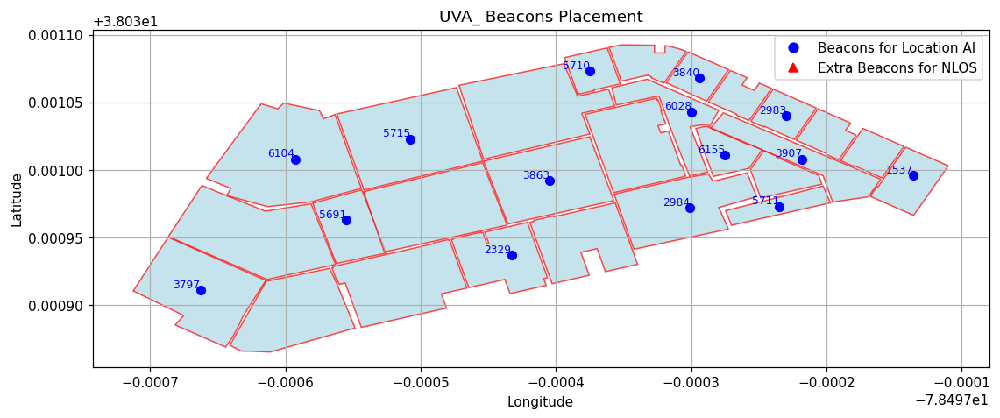

In [159]:
anchor_point_df1= anchor_point_df[~anchor_point_df.Mac.isin(columns_to_drop)]

plt.close('all')
plt.rcParams['figure.dpi'] = 110

fig, ax = plt.subplots(figsize=(12, 12))

from matplotlib.patches import Polygon

# --- Draw rooms ---
for _, row in df_rooms.iterrows():
    coords = []
    for i in range(1, 24):  
        xcol, ycol = f"x{i}", f"y{i}"
        if xcol in row and ycol in row:
            x, y = row[xcol], row[ycol]
            if pd.notnull(x) and pd.notnull(y):
                try:
                    coords.append((float(x), float(y)))
                except ValueError:
                    continue
    if len(coords) >= 3:
        ax.add_patch(Polygon(coords, closed=True,
                     edgecolor='r',
                     facecolor='lightblue',
                     alpha=0.7,
                     zorder=1))


# --- Draw beacons ---
beacon_x1 = pd.to_numeric(anchor_point_df1["x"], errors='coerce')
beacon_y1 = pd.to_numeric(anchor_point_df1["y"], errors='coerce')
ax.scatter(beacon_x1, beacon_y1, marker="o", s=40,
           label="Beacons", color="blue", zorder=2)

for _, r in anchor_point_df1.iterrows():
    try:
        bx = float(r["x"])
        by = float(r["y"])
        ax.text(bx, by, str(r["Dec"])[-4:], fontsize=8,
                ha="right", va="bottom", color="blue", zorder=3)
    except (ValueError, TypeError):
        continue

# --- Axis limits from both rooms and beacons ---
room_x = pd.to_numeric(df_rooms[[f"x{i}" for i in range(1,24)]].to_numpy().ravel(), errors='coerce')
room_y = pd.to_numeric(df_rooms[[f"y{i}" for i in range(1,24)]].to_numpy().ravel(), errors='coerce')

all_x = np.concatenate([room_x, beacon_x.to_numpy()])
all_y = np.concatenate([room_y, beacon_y.to_numpy()])
all_x = all_x[~np.isnan(all_x)]
all_y = all_y[~np.isnan(all_y)]

if len(all_x) > 1 and len(all_y) > 1:
    xmin, xmax = np.min(all_x), np.max(all_x)
    ymin, ymax = np.min(all_y), np.max(all_y)
    pad_x = max((xmax - xmin) * 0.05, 1e-7)
    pad_y = max((ymax - ymin) * 0.05, 1e-7)
    ax.set_xlim(xmin - pad_x, xmax + pad_x)
    ax.set_ylim(ymin - pad_y, ymax + pad_y)
else:
    ax.autoscale()
    ax.margins(0.05)

# --- Style ---
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
ax.set_title("UVA_ Beacons Placement")
ax.set_aspect('equal', adjustable='box')
ax.grid(True)
ax.legend()

from matplotlib.lines import Line2D

legend_handles = [
    Line2D([0], [0],
           marker='o', linestyle='None',
           markerfacecolor='blue', markeredgecolor='blue',
           markersize=7, label='Beacons for Location AI'),

    Line2D([0], [0],
           marker='^', linestyle='None',
           markerfacecolor='red', markeredgecolor='red',
           markersize=7, label='Extra Beacons for NLOS'),
]

ax.legend(handles=legend_handles, loc='upper right')

### Location AI

In [162]:
train_data, test_data = train_test_split(data_set_df.drop(columns= columns_to_drop), test_size=0.3, \
                                         random_state=42, \
                                         stratify=data_set_df["Zone_id"])

X_train = train_data[[col for col in train_data.columns if col.startswith("0")]]
y_train_floor = train_data['parent_zone_id'] 
y_train = train_data['Zone_id']

X_test = test_data[[col for col in train_data.columns if col.startswith("0")]] 
y_test_floor = test_data['parent_zone_id'] 
y_test = test_data['Zone_id'] 
train_data.shape, data_set_df.shape, X_train.shape

((4917, 20), (7025, 28), (4917, 15))

In [164]:
selected_features, clf_rooms, clf_floor = train_variable(X_train, y_train_floor, y_train, save_models = False)
predicted_rooms, predicted_floors = predict_variable(X_test, clf_floor, clf_rooms, selected_features)

In [165]:
score = accuracy_score(y_test, predicted_rooms)
print('Room Accuracy: {:.2f}%'.format(score * 100))

Room Accuracy: 91.32%


In [166]:
result_d = test_data[["Room_name", 'tagId', 'Zone_id']]\
    .merge(zones[["Zone_id", "Room_Type"]], on = "Zone_id", how="left")
result_d["Prediction"] = predicted_rooms
result_d["Accuracy"] = np.where(result_d.Zone_id == result_d.Prediction, 100, 0)
result_d.head(1)

,Room_name,tagId,Zone_id,Room_Type,Prediction,Accuracy
0,G225G,2038506,37985,Room,37985,100


In [167]:
zone_no_beacon= ['G224-2', 'G224-4', 'G224-6', 'G224G']
# zone_no_beacon= ['G224-2', 'G224-4', 'G224-6', 'G224G', 'G224-8', 'G224E','G225C', 'G225G','G225J','G225M']
result_d['Has_Beacon'] = result_d['Room_name'].apply(lambda x: "No" if x in zone_no_beacon else "Yes")
result_d.head(1)

,Room_name,tagId,Zone_id,Room_Type,Prediction,Accuracy,Has_Beacon
0,G225G,2038506,37985,Room,37985,100,Yes


In [168]:
result_d.groupby([ "Has_Beacon", "Room_Type"]).Accuracy.mean()

Has_Beacon  Room_Type
No          Open         86.496350
            Room         98.765432
Yes         Open         88.874172
            Room         93.887776
Name: Accuracy, dtype: float64

In [174]:
result_rf = pd.DataFrame(result_d.groupby("Room_name").Accuracy.mean()).reset_index()
result_d.groupby("Has_Beacon").Accuracy.mean()

Has_Beacon
No     89.295775
Yes    91.728465
Name: Accuracy, dtype: float64

In [176]:
result_d.groupby(["Room_Type"]).Accuracy.mean()

Room_Type
Open    88.241011
Room    94.253939
Name: Accuracy, dtype: float64

In [178]:
result_d.groupby(["Room_Type"]).Zone_id.nunique()

Room_Type
Open    12
Room    13
Name: Zone_id, dtype: int64

### Hybrid

In [41]:
nearby_rooms = ["G225C", "G224H", "G225G", "G224-2", "G225-C2", "G225-C4", "G225N"]

target_rooms = ["G225F"]

In [42]:
data_set_df_hybrid= data_set_df[(data_set_df["Room_name"].isin(nearby_rooms)) | (data_set_df["Room_name"].isin(target_rooms))]

train_data_hybrid, test_data_hybrid = train_test_split(data_set_df_hybrid, test_size=0.2, \
                                         random_state=42, \
                                         stratify=data_set_df_hybrid["Zone_id"])

X_train_hybrid= train_data_hybrid[[col for col in train_data_hybrid.columns if col.startswith("0")]]
y_train_hybrid= train_data_hybrid['Room_name']

X_test_hybrid= test_data_hybrid[[col for col in test_data_hybrid.columns if col.startswith("0")]] 
y_test_hybrid= test_data_hybrid['Room_name'] 

X_train_hybrid.shape, X_test_hybrid.shape, data_set_df.shape

((1673, 23), (419, 23), (7025, 28))

In [43]:
rf_model = RandomForestClassifier(
    n_estimators=200, 
    max_depth=None, 
    random_state=42,
    n_jobs=-1
)
rf_model.fit(X_train_hybrid, y_train_hybrid)

# Evaluate
accuracy = rf_model.score(X_test_hybrid, y_test_hybrid)
predicted_rooms= rf_model.predict(X_test_hybrid)
print("RF validation accuracy:", accuracy*100)

RF validation accuracy: 96.65871121718376


In [44]:
rf_features = [c for c in X_train_hybrid.columns if c not in ['Room_name','timestamp','tagId','Zone_id','x','y']]
len(rf_features)

23

In [45]:
result_h = test_data_hybrid[["Room_name", 'tagId', 'Zone_id']]
result_h["Prediction"] = predicted_rooms
result_h["Accuracy"] = np.where(result_h["Room_name"] == result_h.Prediction, 100, 0)

## REMOVE ALL ROWS < -99

In [47]:
beacon_cols = [col for col in df1.columns if str(col).startswith('0')]
rows_all_below_90 = df1[beacon_cols].lt(-99).all(axis=1)
df1 = df1[~rows_all_below_90]
df1.shape

(7025, 43)

In [48]:
# data_set_df_all, anchor_points_coord, unheard_anchor_point_df = read_MLE_data_survey_portal(df1, ground_truth_df, anchor_point_df)
# anchor_points_coord.shape

# *** MAKE SURE THAT ALL BEACONS ARE BEING HEARD

In [50]:
data_set_df.Room_name.nunique()

25

In [51]:
# anchor_point_df.head()

In [52]:
anchor_point_df.shape

(23, 5)

In [53]:
# Extract all room coordinates as a flat list [[lon, lat], ...]
room_coords_list = []

for _, row in df_rooms.iterrows():
    for i in range(1, 135):  # x1..x134, y1..y134
        x_col, y_col = f"x{i}", f"y{i}"
        if x_col in row and y_col in row:
            x, y = row[x_col], row[y_col]
            if pd.notnull(x) and pd.notnull(y):
                room_coords_list.append([x, y])

room_coords_array = np.array(room_coords_list)
# room_coords_array

## A. MLE

In [107]:
import numpy as np
import pandas as pd
from tqdm import tqdm
from scipy.optimize import minimize
from joblib import Parallel, delayed

# ---------------------------
# Utility functions
# ---------------------------

def euclidean_dist(point, points, height_diff=1.5):
    return np.sqrt(np.sum((points - point) ** 2, axis=1) + height_diff ** 2)

def generate_grid(center, resolution=5, radius=4):
    step = 1 / resolution
    x_vals = np.arange(center[0] - radius, center[0] + radius + step, step)
    y_vals = np.arange(center[1] - radius, center[1] + radius + step, step)
    xv, yv = np.meshgrid(x_vals, y_vals)
    return np.stack([xv.ravel(), yv.ravel()], axis=1)

def rssi_to_distance(rssi, A=-40, n=3.5, scale=0.8):
    return scale * np.exp((A - rssi) / (10 * n))

def compute_likelihood_weighted(grid_coords, anchor_coords, rssi_values, T, n, sigma_noise=4, anchor_weights=None):
    if anchor_weights is None:
        anchor_weights = np.ones_like(rssi_values)
    diff = grid_coords[:, None, :] - anchor_coords[None, :, :]
    dists = np.sqrt(np.sum(diff ** 2, axis=2) + 1.5**2)
    pred_rssi = T - 10 * n * np.log10(dists + 1e-5)
    residuals = pred_rssi - rssi_values
    weighted_residuals = (residuals / sigma_noise)**2 * anchor_weights
    likelihood = np.exp(-0.5 * weighted_residuals)
    return np.prod(likelihood, axis=1)

def find_mle_params(P_j, d_ij, init_guess=[-40, 3]):
    def squared_error(params, dists, rssi):
        T_i, n_p = params
        valid_mask = rssi != -100
        pred_rssi = T_i - 10 * n_p * np.log10(dists + 1e-5)
        return np.sum((pred_rssi[valid_mask] - rssi[valid_mask]) ** 2)
    bounds = [(-100, -30), (2, 6)]
    result = minimize(squared_error, init_guess, args=(d_ij, P_j),
                      method='L-BFGS-B', bounds=bounds)
    return result.x if result.success else init_guess

# ---------------------------
# Geo/Local conversion utilities
# ---------------------------

def local_coordinate_conversion(latlon, origin):
    """Convert lat/lon to local meters relative to origin."""
    lat, lon, _ = latlon
    origin_lat, origin_lon, _ = origin
    # Rough approximation using equirectangular projection
    R = 6378137  # Earth radius in meters
    x = (lon - origin_lon) * np.pi/180 * R * np.cos(origin_lat * np.pi/180)
    y = (lat - origin_lat) * np.pi/180 * R
    return x, y

def offset_geo_coordinate(origin_lat, origin_lon, x, y):
    """Convert local meters back to lat/lon."""
    R = 6378137
    lat = origin_lat + (y / R) * (180/np.pi)
    lon = origin_lon + (x / (R * np.cos(origin_lat * np.pi/180))) * (180/np.pi)
    return lat, lon

# ---------------------------
# Process one packet / row
# ---------------------------

def process_packet(row, anchor_point_df, rssi_threshold=-90):
    """Extract RSSI and anchor info for a single row."""
    macs = anchor_point_df['Mac'].values
    rssi_values = []
    anchor_coords = []
    for mac, x, y in zip(anchor_point_df['Mac'], anchor_point_df['x'], anchor_point_df['y']):
        if mac in row.index:
            val = row[mac]
            if isinstance(val, (int,float)) and val > rssi_threshold:
                rssi_values.append(val)
                anchor_coords.append([x,y])
    if len(rssi_values) == 0:
        return pd.DataFrame()
    return pd.DataFrame({'Mac': macs[:len(rssi_values)],
                         'rssi': rssi_values,
                         'x': [a[0] for a in anchor_coords],
                         'y': [a[1] for a in anchor_coords]})

# ---------------------------
# Main MLE Geo function
# ---------------------------

def run_mle_geo_fused(data_set_df, anchor_point_df, room_coords_array,
                      coarse_res=2, fine_res=5, fine_radius=3,
                      rssi_threshold=-90, strong_rssi_threshold=-75,
                      top_k_anchors=5, roi_margin=8, top_coarse_points=200,
                      topN_ratio=0.05, sigma_noise=4):
    
    results = []

    # Define origin of building for local conversion
    building_coords = np.array(room_coords_array)
    origin_lat = building_coords[:, 1].min()
    origin_lon = building_coords[:, 0].min()
    origin = [origin_lat, origin_lon, 0]

    # Ensure numeric coordinates
    anchor_point_df['x'] = pd.to_numeric(anchor_point_df['x'], errors='coerce')
    anchor_point_df['y'] = pd.to_numeric(anchor_point_df['y'], errors='coerce')
    anchor_point_df = anchor_point_df.dropna(subset=['x','y'])

    for idx, row in tqdm(data_set_df.iterrows(), total=len(data_set_df)):
        beacons_df = process_packet(row, anchor_point_df, rssi_threshold=rssi_threshold)
        if beacons_df.empty:
            continue

        # ---------------------------
        # Local coordinates in meters
        # ---------------------------
        local_coordinates = []
        for lat, lon, x_anchor, y_anchor in zip(beacons_df['y'], beacons_df['x'], beacons_df['x'], beacons_df['y']):
            x, y = local_coordinate_conversion([lat, lon, 0], origin)
            local_coordinates.append([x, y])
        local_coordinates = np.array(local_coordinates)
        data_rssi = beacons_df['rssi'].values

        # ---------------------------
        # Fused MLE logic
        # ---------------------------
        mask = data_rssi > rssi_threshold
        signal_strengths_selected = data_rssi[mask]
        dp_coords_selected = local_coordinates[mask]

        if len(signal_strengths_selected) < 1:
            signal_strengths_selected = data_rssi
            dp_coords_selected = local_coordinates

        strong_mask = signal_strengths_selected > strong_rssi_threshold
        if np.sum(strong_mask) < 2:
            dp_coords_selected = dp_coords_selected
            signal_strengths_selected = signal_strengths_selected
        else:
            dp_coords_selected = dp_coords_selected[strong_mask]
            signal_strengths_selected = signal_strengths_selected[strong_mask]

        min_rssi, max_rssi = np.min(signal_strengths_selected), np.max(signal_strengths_selected)
        anchor_weights = (signal_strengths_selected - min_rssi + 1) / (max_rssi - min_rssi + 1e-5)
        sorted_idx = np.argsort(-signal_strengths_selected)
        top_k = min(top_k_anchors, len(sorted_idx))
        top_coords = dp_coords_selected[sorted_idx[:top_k]]

        x_min, y_min = np.min(top_coords, axis=0)
        x_max, y_max = np.max(top_coords, axis=0)
        x_min = max(x_min - roi_margin, 0)
        x_max = max(x_max + roi_margin, np.max(local_coordinates[:,0]))
        y_min = max(y_min - roi_margin, 0)
        y_max = max(y_max + roi_margin, np.max(local_coordinates[:,1]))

        coarse_grid = np.stack(np.meshgrid(np.arange(x_min, x_max, 1/coarse_res),
                                           np.arange(y_min, y_max, 1/coarse_res)), axis=-1).reshape(-1,2)

        strongest_coord = top_coords[0]
        dists_for_fit = euclidean_dist(strongest_coord, dp_coords_selected)
        T_global, n_global = find_mle_params(signal_strengths_selected, dists_for_fit)

        coarse_likelihoods = compute_likelihood_weighted(
            coarse_grid, dp_coords_selected, signal_strengths_selected,
            T_global, n_global, sigma_noise, anchor_weights
        )

        top_indices = np.argpartition(coarse_likelihoods, -top_coarse_points)[-top_coarse_points:]
        top_candidates = coarse_grid[top_indices]

        fine_candidates, fine_likelihoods = [], []
        for center in top_candidates:
            fine_grid = generate_grid(center, resolution=fine_res, radius=fine_radius)
            likelihoods_fine = compute_likelihood_weighted(
                fine_grid, dp_coords_selected, signal_strengths_selected,
                T_global, n_global, sigma_noise, anchor_weights
            )
            fine_candidates.append(fine_grid)
            fine_likelihoods.append(likelihoods_fine)

        fine_candidates = np.vstack(fine_candidates)
        fine_likelihoods = np.hstack(fine_likelihoods)
        fine_likelihoods += 1e-12
        fine_likelihoods /= np.sum(fine_likelihoods)

        N = max(1, min(100, int(topN_ratio * len(fine_candidates))))
        top_idx = np.argpartition(fine_likelihoods, -N)[-N:]
        top_points = fine_candidates[top_idx]
        top_weights = fine_likelihoods[top_idx]
        top_weights /= np.sum(top_weights)
        pred_mle_local = np.average(top_points, axis=0, weights=top_weights)
        conf_mle = np.max(top_weights)

        # Convert back to lat/lon
        pred_geo_coordinates = offset_geo_coordinate(origin[0], origin[1], pred_mle_local[0], pred_mle_local[1])

        results.append({
            "Zone_id": row.get("Zone_id", None),
            "Room_name": row.get("Room_name", None),
            "Tag_id": row.get("tagId", None),
            "Predicted_MLE": [pred_geo_coordinates[0], pred_geo_coordinates[1]],
            "Confidence": conf_mle,
            "Original_Index": idx,
            "timestamp": row.get("timestamp", None)
        })

    return pd.DataFrame(results)


In [43]:
result_mle_new= run_mle_geo_fused(data_set_df, anchor_point_df, room_coords_array,
                      coarse_res=2, fine_res=5, fine_radius=3,
                      rssi_threshold=-90, strong_rssi_threshold=-75,
                      top_k_anchors=5, roi_margin=8, top_coarse_points=200,
                      topN_ratio=0.05, sigma_noise=4)

100%|███████████████████████████████████████| 7025/7025 [07:25<00:00, 15.78it/s]


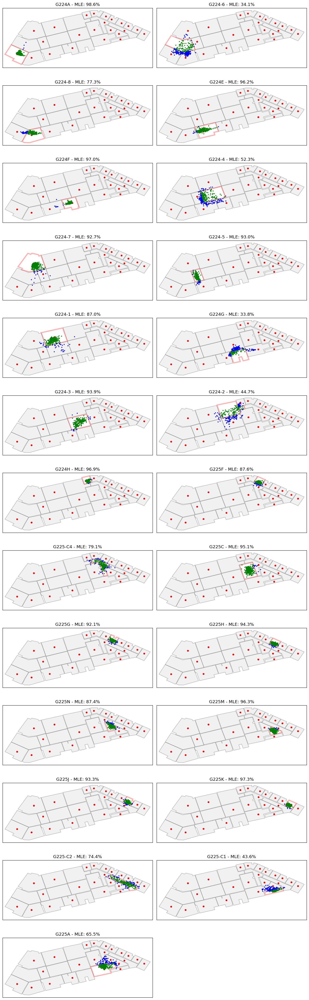

Overall Accuracy: 79.84%


,Room_name,Total_Points,Inside_Points,Accuracy
0,G224A,276,272,98.550725
1,G224-6,317,108,34.069401
2,G224-8,264,204,77.272727
3,G224E,289,278,96.193772
4,G224F,267,259,97.003745
5,G224-4,333,174,52.252252
6,G224-7,331,307,92.749245
7,G224-5,286,266,93.006993
8,G224-1,331,288,87.009063
9,G224G,269,91,33.828996


In [44]:
plot_building_with_zone_accuracy(df_rooms, result_mle_new, pred_col="Predicted_MLE")

## B. Optimisation

In [48]:
from geopy.distance import distance
from shapely.geometry import Point as ShapelyPoint

In [49]:
def rssi_to_distance(rssi, A=-40, n=3.5, scale=0.8): ## normal -40 and 3
    return scale * np.exp((A - rssi) / (10 * n))

def rssi_from_distance(distance, A=-40, n=3.5, scale=0.8):
    distance = np.maximum(distance, 1e-6)  
    return A - 10 * n * np.log(distance / scale)

def filter_rssi(row, beacon_positions, rssi_threshold=-90):
    return {
        mac: row[mac]
        for mac in beacon_positions.keys()
        if mac in row.index and isinstance(row[mac], (int, float)) and row[mac] > rssi_threshold
    }

def localization_error(tag_position, beacons, distances):
    estimated_distances = np.linalg.norm(beacons - tag_position, axis=1)
    sigma = np.std(distances) + 1e-3
    weights = np.exp(- (distances ** 2) / (2 * sigma ** 2))
    return np.sum(weights * (estimated_distances - distances) ** 2)

def generate_expansion_area(initial_guess, std_dev=0.5, radius=0.8, num_points=500, range_box=2):
    num_gauss = int(num_points * 0.4)
    num_box = int(num_points * 0.3)
    num_circle = num_points - num_gauss - num_box

    box_points = np.random.uniform(-range_box, range_box, size=(num_box, 2)) + initial_guess
    gauss_points = np.random.normal(0, std_dev, size=(num_gauss, 2)) + initial_guess

    r = radius * np.sqrt(np.random.uniform(0, 1, num_circle))
    theta = np.random.uniform(0, 2 * np.pi, num_circle)
    circ_points = np.column_stack((initial_guess[0] + r * np.cos(theta),
                                   initial_guess[1] + r * np.sin(theta)))
    return np.vstack((gauss_points, box_points, circ_points))

def calculate_total_error_to_all_beacons(best_position, beacon_coords):
    distances = np.linalg.norm(beacon_coords - best_position, axis=1)
    return np.sum(distances)

def trilateration(coords, distances):
    def fun(x, coords, distances):
        weights = 1 / (distances + 1e-5)
        return weights * (np.linalg.norm(coords - x, axis=1) - distances)
    x0 = np.mean(coords, axis=0)
    result = least_squares(fun, x0, args=(coords, distances))
    return result.x if result.success else x0

# -----------------------------
# Coordinate conversion
# -----------------------------
from geopy.distance import geodesic, distance

def latlon_to_local_xy(lat, lon, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    y_offset = geodesic((origin_lat, origin_lon), (lat, origin_lon)).meters
    x_offset = geodesic((origin_lat, origin_lon), (origin_lat, lon)).meters
    if lat < origin_lat:
        y_offset *= -1
    if lon < origin_lon:
        x_offset *= -1
    return x_offset, y_offset

def local_xy_to_latlon(x_m, y_m, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    origin_point = (origin_lat, origin_lon)  # <-- tuple for geopy

    # Move north/south
    point_north = distance(meters=y_m).destination(origin_point, bearing=0)
    # Move east/west from the new north point
    final_point = distance(meters=x_m).destination((point_north.latitude, point_north.longitude), bearing=90)

    return final_point.latitude, final_point.longitude

In [51]:
def run_localization_with_geo_fused_opt(
    data_set_df,
    anchor_point_df,
    room_coords_array,
    min_beacons=4,
    rssi_threshold=-90,
    expansion_radius=0.8,
    expansion_points=100,
    enable_refinement=True
):
    results = []
    has_timestamp = 'timestamp' in data_set_df.columns

    # -----------------------------
    # Compute origin
    # -----------------------------
    building_coords = np.array(room_coords_array)
    origin = [building_coords[:,0].min(), building_coords[:,1].min()]

    # -----------------------------
    # Convert anchors to local meters
    # -----------------------------
    anchor_point_df['x'] = pd.to_numeric(anchor_point_df['x'], errors='coerce')
    anchor_point_df['y'] = pd.to_numeric(anchor_point_df['y'], errors='coerce')
    anchor_point_df = anchor_point_df.dropna(subset=['x','y'])

    beacon_positions = {}
    for _, r in anchor_point_df.iterrows():
        x_m, y_m = latlon_to_local_xy(r['y'], r['x'], origin)
        beacon_positions[r['Mac']] = {'x': x_m, 'y': y_m}

    # -----------------------------
    # Iterate packets
    # -----------------------------
    for idx, row in tqdm(data_set_df.iterrows(), total=len(data_set_df)):

        rssi_values = dict(sorted(
            filter_rssi(row, beacon_positions, rssi_threshold).items(),
            key=lambda x: x[1], reverse=True
        ))

        if len(rssi_values) < min_beacons:
            continue

        beacon_coords = np.array([list(beacon_positions[b].values()) for b in rssi_values])
        distances = np.array([rssi_to_distance(r) for r in rssi_values.values()])

        # -----------------------------
        # Initial Guess (unchanged)
        # -----------------------------
        top_n = min(5, len(beacon_coords))
        initial_guess = trilateration(
            beacon_coords[:top_n],
            distances[:top_n]
        )

        # -----------------------------
        # 🔥 NEW OPTIMIZATION LOGIC 🔥
        # -----------------------------
        expansion_area = generate_expansion_area(
            initial_guess,
            radius=expansion_radius,
            num_points=expansion_points
        )

        quick_errors = np.array([
            localization_error(p, beacon_coords, distances)
            for p in expansion_area
        ])

        best_expansion = expansion_area[np.argsort(quick_errors)[:10]]

        best_err, best_pos = float("inf"), None
        for p in best_expansion:
            res = minimize(
                localization_error,
                p,
                args=(beacon_coords, distances),
                method='L-BFGS-B',
                options={'maxiter':100}
            )
            if res.success:
                err = np.sum(np.linalg.norm(beacon_coords - res.x, axis=1))
                if err < best_err:
                    best_err = err
                    best_pos = res.x

        if best_pos is None:
            best_pos = initial_guess

        # -----------------------------
        # Optional refinement (same logic)
        # -----------------------------
        pre_refined_pos = best_pos.copy()
        if enable_refinement:
            strong_idx = [i for i,r in enumerate(rssi_values.values()) if r > -75]
            if len(strong_idx) >= 3:
                res = minimize(
                    localization_error,
                    best_pos,
                    args=(beacon_coords[strong_idx], distances[strong_idx]),
                    method='L-BFGS-B',
                    options={'maxiter':100}
                )
                if res.success:
                    best_pos = res.x

        # -----------------------------
        # Convert back to GEO
        # -----------------------------
        final_lat, final_lon = local_xy_to_latlon(best_pos[0], best_pos[1], origin)
        pre_lat, pre_lon = local_xy_to_latlon(pre_refined_pos[0], pre_refined_pos[1], origin)
        init_lat, init_lon = local_xy_to_latlon(initial_guess[0], initial_guess[1], origin)

        results.append({
            "Zone_id": row.get("Zone_id"),
            "Room_name": row.get("Room_name"),
            "Tag_id": row.get("tagId"),
            "Predicted_Before_Refinement": [pre_lat, pre_lon],
            "Predicted_Optimisation": [final_lat, final_lon],
            "Initial_Guess": [init_lat, init_lon],
            "Refinement_Shift": np.linalg.norm(best_pos - pre_refined_pos),
            "Distance_From_Initial": np.linalg.norm(best_pos - initial_guess),
            "Original_Index": idx,
            "timestamp": row["timestamp"] if has_timestamp else None
        })

    return pd.DataFrame(results)


In [55]:
start_time = time.perf_counter() 

results_df = run_localization_with_geo_fused_opt(
    data_set_df=data_set_df, #.drop(columns= block_beacon),
    anchor_point_df=anchor_point_df, #[anchor_point_df.Blocked !="block"],
    room_coords_array= room_coords_array,  
    min_beacons=4,
    expansion_radius=1,
    expansion_points=200,
    enable_refinement=True
)

results_df.to_csv("Result_Final/Optimisation_Orginal.csv", index= False)

end_time = time.perf_counter() 

total_time = end_time - start_time
avg_time_per_row = total_time / len(df1)
print(avg_time_per_row)

100%|██████████████████████████████████████| 7025/7025 [01:04<00:00, 108.80it/s]


0.009200288167263105


## C. GEO FUSED MLE → OPT → FUSION

In [51]:
import numpy as np
import pandas as pd
from tqdm import tqdm
from scipy.optimize import minimize

# ---------------------------
# Utility functions
# ---------------------------
def euclidean_dist(point, points, height_diff=1.5):
    return np.sqrt(np.sum((points - point) ** 2, axis=1) + height_diff ** 2)

def generate_grid(center, resolution=5, radius=4):
    step = 1 / resolution
    x_vals = np.arange(center[0] - radius, center[0] + radius + step, step)
    y_vals = np.arange(center[1] - radius, center[1] + radius + step, step)
    xv, yv = np.meshgrid(x_vals, y_vals)
    return np.stack([xv.ravel(), yv.ravel()], axis=1)

def rssi_to_distance(rssi, A=-40, n=3.5, scale=0.8):
    return scale * np.exp((A - rssi) / (10 * n))

def filter_rssi(row, beacon_positions, rssi_threshold=-90):
    return {
        mac: row[mac]
        for mac in beacon_positions.keys()
        if mac in row.index and isinstance(row[mac], (int, float)) and row[mac] > rssi_threshold
    }

def localization_error(tag_position, beacons, distances):
    estimated_distances = np.linalg.norm(beacons - tag_position, axis=1)
    sigma = np.std(distances) + 1e-3
    weights = np.exp(- (distances ** 2) / (2 * sigma ** 2))
    return np.sum(weights * (estimated_distances - distances) ** 2)

def generate_expansion_area(initial_guess, std_dev=0.3, radius=0.5, num_points=50):
    num_gauss = int(num_points * 0.6)
    num_circle = num_points - num_gauss
    gauss_points = np.random.normal(0, std_dev, size=(num_gauss, 2)) + initial_guess
    r = radius * np.sqrt(np.random.uniform(0, 1, num_circle))
    theta = np.random.uniform(0, 2 * np.pi, num_circle)
    circ_points = np.column_stack((initial_guess[0] + r * np.cos(theta), initial_guess[1] + r * np.sin(theta)))
    return np.vstack((gauss_points, circ_points))

def compute_likelihood_weighted(grid_coords, anchor_coords, rssi_values, T, n, sigma_noise=4, anchor_weights=None):
    if anchor_weights is None:
        anchor_weights = np.ones_like(rssi_values)
    diff = grid_coords[:, None, :] - anchor_coords[None, :, :]
    dists = np.sqrt(np.sum(diff ** 2, axis=2) + 1.5**2)
    pred_rssi = T - 10 * n * np.log10(dists + 1e-5)
    residuals = pred_rssi - rssi_values
    weighted_residuals = (residuals / sigma_noise)**2 * anchor_weights
    likelihood = np.exp(-0.5 * weighted_residuals)
    return np.prod(likelihood, axis=1)

def find_mle_params(P_j, d_ij, init_guess=[-40, 3]):
    def squared_error(params, dists, rssi):
        T_i, n_p = params
        valid_mask = rssi != -100
        pred_rssi = T_i - 10 * n_p * np.log10(dists + 1e-5)
        return np.sum((pred_rssi[valid_mask] - rssi[valid_mask]) ** 2)
    bounds = [(-100, -30), (2, 6)]
    result = minimize(squared_error, init_guess, args=(d_ij, P_j),
                      method='L-BFGS-B', bounds=bounds)
    return result.x if result.success else init_guess

# ---------------------------
# GEO conversion functions
# ---------------------------
def latlon_to_local_xy(lat, lon, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    y_offset = (lat - origin_lat) * 111320  # rough meter conversion
    x_offset = (lon - origin_lon) * 40075000 * np.cos(np.radians(origin_lat)) / 360
    return x_offset, y_offset

def local_xy_to_latlon(x_m, y_m, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    lat = origin_lat + y_m / 111320
    lon = origin_lon + x_m * 360 / (40075000 * np.cos(np.radians(origin_lat)))
    return lat, lon

# ---------------------------
# Fused Localization with GEO
# ---------------------------
def fused_localization_geo_mle_opt(data_df, anchor_point_df, room_coords_array,
                                   sigma_noise=4, coarse_res=2, fine_res=5, fine_radius=3,
                                   rssi_threshold=-95, strong_rssi_threshold=-75,
                                   top_k_anchors=5, roi_margin=8, top_coarse_points=200, topN_ratio=0.05,
                                   epsilon=1e-12,
                                   expansion_radius=0.8, expansion_points=100,
                                   enable_refinement=True):
    
    results = []

    # Define origin from room coordinates
    room_coords_array = np.array(room_coords_array)
    origin = [room_coords_array[:,0].min(), room_coords_array[:,1].min()]

    # Convert anchors to local meters
    beacon_positions = {}
    anchor_coords_array = []
    for _, row_a in anchor_point_df.iterrows():
        x_m, y_m = latlon_to_local_xy(row_a['y'], row_a['x'], origin)
        beacon_positions[row_a['Mac']] = {'x': x_m, 'y': y_m}
        anchor_coords_array.append([x_m, y_m])
    anchor_coords_array = np.array(anchor_coords_array)
    anchor_macs = anchor_point_df['Mac'].values

    for idx, row in tqdm(data_df.iterrows(), total=len(data_df)):
        # Align RSSI with anchors
        rssis = np.array([row[mac] if mac in row else -100 for mac in anchor_macs], dtype=float)
        mask_mle = rssis > rssi_threshold
        signal_strengths = rssis[mask_mle]
        dp_coords = anchor_coords_array[mask_mle]

        if len(signal_strengths) < 1:
            signal_strengths = rssis
            dp_coords = anchor_coords_array

        # Strong RSSI selection
        strong_mask = signal_strengths > strong_rssi_threshold
        if np.sum(strong_mask) < 2:
            dp_coords_selected = dp_coords
            signal_strengths_selected = signal_strengths
        else:
            dp_coords_selected = dp_coords[strong_mask]
            signal_strengths_selected = signal_strengths[strong_mask]

        min_rssi, max_rssi = np.min(signal_strengths_selected), np.max(signal_strengths_selected)
        anchor_weights = (signal_strengths_selected - min_rssi + 1) / (max_rssi - min_rssi + 1e-5)
        sorted_idx = np.argsort(-signal_strengths_selected)
        top_k = min(top_k_anchors, len(sorted_idx))
        top_coords = dp_coords_selected[sorted_idx[:top_k]]

        # Define ROI
        x_min, y_min = np.min(top_coords, axis=0)
        x_max, y_max = np.max(top_coords, axis=0)
        x_min = max(x_min - roi_margin, 0)
        x_max = max(x_max + roi_margin, np.max(anchor_coords_array[:,0]))
        y_min = max(y_min - roi_margin, 0)
        y_max = max(y_max + roi_margin, np.max(anchor_coords_array[:,1]))

        # Coarse grid search
        coarse_grid = np.stack(np.meshgrid(np.arange(x_min, x_max, 1/coarse_res),
                                           np.arange(y_min, y_max, 1/coarse_res)), axis=-1).reshape(-1,2)

        strongest_coord = top_coords[0]
        dists_for_fit = euclidean_dist(strongest_coord, dp_coords_selected)
        T_global, n_global = find_mle_params(signal_strengths_selected, dists_for_fit)

        coarse_likelihoods = compute_likelihood_weighted(
            coarse_grid, dp_coords_selected, signal_strengths_selected,
            T_global, n_global, sigma_noise, anchor_weights
        )

        top_indices = np.argpartition(coarse_likelihoods, -top_coarse_points)[-top_coarse_points:]
        top_candidates = coarse_grid[top_indices]

        # Fine grid search
        fine_candidates, fine_likelihoods = [], []
        for center in top_candidates:
            fine_grid = generate_grid(center, resolution=fine_res, radius=fine_radius)
            likelihoods_fine = compute_likelihood_weighted(
                fine_grid, dp_coords_selected, signal_strengths_selected,
                T_global, n_global, sigma_noise, anchor_weights
            )
            fine_candidates.append(fine_grid)
            fine_likelihoods.append(likelihoods_fine)

        fine_candidates = np.vstack(fine_candidates)
        fine_likelihoods = np.hstack(fine_likelihoods)
        fine_likelihoods += epsilon
        fine_likelihoods /= np.sum(fine_likelihoods)

        N = max(1, min(100, int(topN_ratio * len(fine_candidates))))
        top_idx = np.argpartition(fine_likelihoods, -N)[-N:]
        top_points = fine_candidates[top_idx]
        top_weights = fine_likelihoods[top_idx]
        top_weights /= np.sum(top_weights)
        pred_mle = np.average(top_points, axis=0, weights=top_weights)
        conf_mle = np.max(top_weights)

        # ---------------------------
        # Optimization around MLE
        # ---------------------------
        rssi_values_opt = dict(sorted(filter_rssi(row, beacon_positions, rssi_threshold).items(),
                                      key=lambda x: x[1], reverse=True))
        if len(rssi_values_opt) < 3:
            beacon_coords_opt = anchor_coords_array
            distances_opt = np.ones(anchor_coords_array.shape[0])
        else:
            beacon_coords_opt = np.array([list(beacon_positions[b].values()) for b in rssi_values_opt.keys()])
            distances_opt = np.array([rssi_to_distance(rssi) for rssi in rssi_values_opt.values()])

        expansion_area = generate_expansion_area(pred_mle, radius=expansion_radius, num_points=expansion_points)
        quick_errors = np.array([localization_error(p, beacon_coords_opt, distances_opt) for p in expansion_area])
        filtered_expansion_area = expansion_area[np.argsort(quick_errors)[:10]]

        best_err, best_pos = float("inf"), None
        for point in filtered_expansion_area:
            res = minimize(localization_error, point, args=(beacon_coords_opt, distances_opt),
                           method='L-BFGS-B', options={'maxiter':100})
            if res.success:
                est_pos = res.x
                total_err = np.sum(np.linalg.norm(beacon_coords_opt - est_pos, axis=1))
                if total_err < best_err:
                    best_err = total_err
                    best_pos = est_pos
        pred_opt = best_pos
        conf_opt = 1 / (1 + best_err)

        # Optional refinement
        pre_refined_pos = pred_opt.copy()
        if enable_refinement:
            strong_rssi_indices = [i for i, rssi in enumerate(rssi_values_opt.values()) if rssi > -75]
            if len(strong_rssi_indices) >= 3:
                filtered_coords = beacon_coords_opt[strong_rssi_indices]
                filtered_distances = distances_opt[strong_rssi_indices]
                result = minimize(localization_error, pred_opt,
                                  args=(filtered_coords, filtered_distances),
                                  method='L-BFGS-B',
                                  options={'maxiter':100, 'gtol':1e-8, 'disp':False})
                if result.success:
                    pred_opt = result.x

        refinement_shift = np.linalg.norm(pred_opt - pre_refined_pos)

        # ---------------------------
        # Convert back to lat/lon
        # ---------------------------
        pred_mle_latlon = local_xy_to_latlon(pred_mle[0], pred_mle[1], origin)
        pred_opt_latlon = local_xy_to_latlon(pred_opt[0], pred_opt[1], origin)

        # ---------------------------
        # Fused results
        # ---------------------------
        alpha_dynamic = conf_mle / (conf_mle + conf_opt)
        pred_fused_fixed = 0.5 * np.array(pred_mle_latlon) + 0.5 * np.array(pred_opt_latlon)
        pred_fused_dynamic = alpha_dynamic * np.array(pred_mle_latlon) + (1-alpha_dynamic) * np.array(pred_opt_latlon)

        results.append({
            'original_index': idx,
            'Zone_id': row.get('Zone_id', np.nan),
            'Room_name': row.get('Room_name', np.nan),
            'Tag_id': row.get('tagId', np.nan),
            'timestamp': row.get('timestamp', np.nan),
            'Predicted_MLE': pred_mle_latlon,
            'Predicted_Optimisation': pred_opt_latlon,
            'Predicted_NLOS': pred_fused_fixed.tolist(),
            'Predicted_NLOS_Dynamic': pred_fused_dynamic.tolist(),
            'MLE_Confidence': conf_mle,
            'Opt_Confidence': conf_opt
        })

    return pd.DataFrame(results)


In [ ]:
start_time = time.perf_counter() 

results_fused = fused_localization_geo_mle_opt(
    data_df=data_set_df, #.drop(columns= block_beacon),
    anchor_point_df=anchor_point_df, #[anchor_point_df.Blocked !="block"],
    room_coords_array= room_coords_array
)

results_fused.to_csv("Result_Final/MLE_Optimisation_combined.csv", index= False)

end_time = time.perf_counter() 

total_time = end_time - start_time
avg_time_per_row = total_time / len(df1)
print(avg_time_per_row)

## Compare with Location AI

In [103]:
def plot_building_all_zones_LocAI(df_rooms, results_df1, results_df2,
                                            virtual_df=None, pred_col="Predicted_Optimisation"):

    room_coords_dict = {}
    for _, row in df_rooms.iterrows():
        coords = []
        for i in range(1, 25):
            xcol, ycol = f"x{i}", f"y{i}"
            if xcol in row and ycol in row:
                x, y = row[xcol], row[ycol]
                if pd.notnull(x) and pd.notnull(y):
                    coords.append((float(x), float(y)))
        if len(coords) >= 3:
            room_coords_dict[row["Room_name"]] = coords

    unique_rooms = df_rooms["Room_name"].unique()
    all_coords = np.array([pt for coords in room_coords_dict.values() for pt in coords])
    xmin, xmax = all_coords[:, 0].min() - 0.00001, all_coords[:, 0].max() + 0.00001
    ymin, ymax = all_coords[:, 1].min() - 0.00001, all_coords[:, 1].max() + 0.00001

    fig, ax = plt.subplots(figsize=(12, 8))
    ax.set_aspect("equal")
    ax.grid(False)
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.set_xticks([])
    ax.set_yticks([])

    summary_records = []

    for r in unique_rooms:
        if r not in room_coords_dict:
            continue

        coords = room_coords_dict[r]
        polygon = ShapelyPolygon(coords)
        if not polygon.is_valid:
            polygon = polygon.buffer(0)

        # --- Accuracy for df1 (compute as before) ---
        room_data1 = results_df1[results_df1["Room_name"] == r]
        inside_flags1 = []
        for coord in room_data1[pred_col] if not room_data1.empty else []:
            try:
                if isinstance(coord, str):
                    coord = ast.literal_eval(coord)
                if coord and len(coord) == 2:
                    lon, lat = float(coord[1]), float(coord[0])
                    inside_flags1.append(Point(lon, lat).within(polygon))
            except Exception:
                continue
        acc1 = (sum(inside_flags1) / len(inside_flags1) * 100) if inside_flags1 else None

        # --- Accuracy for df2 (already precomputed) ---
        match = results_df2[results_df2["Room_name"] == r]
        acc2 = float(match["Accuracy"].iloc[0]) if not match.empty else None

        summary_records.append({
            "Room_name": r,
            "Accuracy_df1": acc1,
            "Accuracy_df2": acc2
        })

        # --- Coloring ---
        facecolor = "none"
        if acc1 is not None and acc2 is not None:
            if round(acc1) > round(acc2):
                facecolor = "green"
            elif round(acc1) < round(acc2):
                facecolor = "blue"
            else:
                facecolor = "yellow"

        ax.add_patch(MplPolygon(coords, closed=True,
                                edgecolor="black", facecolor=facecolor,
                                linewidth=2.0, alpha=0.3, zorder=1))

        # --- Place text ---
        cx, cy = polygon.centroid.x, polygon.centroid.y
        if acc1 is not None and acc2 is not None:
            ax.text(cx, cy, f"{acc1:.1f}",
                    ha="right", va="center", fontsize=8,
                    color="blue", weight="bold", zorder=10,
                    path_effects=[path_effects.withStroke(linewidth=2, foreground="white")])

            ax.text(cx, cy, f"/{acc2:.1f}",
                    ha="left", va="center", fontsize=8,
                    color="green", weight="bold", zorder=10,
                    path_effects=[path_effects.withStroke(linewidth=2, foreground="white")])
        elif acc1 is not None:
            ax.text(cx, cy, f"{int(round(acc1))}",
                    ha="center", va="center", fontsize=9,
                    color="blue", weight="bold", zorder=10,
                    path_effects=[path_effects.withStroke(linewidth=2, foreground="white")])
        elif acc2 is not None:
            ax.text(cx, cy, f"{int(round(acc2))}",
                    ha="center", va="center", fontsize=9,
                    color="green", weight="bold", zorder=10,
                    path_effects=[path_effects.withStroke(linewidth=2, foreground="white")])

    # --- Real beacons ---
    if "beacon_x" in globals() and "beacon_y" in globals():
        ax.scatter(beacon_x, beacon_y, marker="^", s=70, color="red", label="Beacons", zorder=4)

#     # --- Virtual beacons ---
#     if virtual_df is not None and not virtual_df.empty:
#         ax.scatter(virtual_df["x"], virtual_df["y"],
#                    marker="^", s=30, color="red", label="Virtual Beacons", zorder=4)

    legend_handles = [
        mpatches.Patch(color="green", alpha=0.3, label="NLOS better"),
        mpatches.Patch(color="blue", alpha=0.3, label="Location AI better"),
#         mpatches.Patch(color="yellow", alpha=0.3, label="Equal accuracy"),
#         mpatches.Patch(color="red", label="Virtual Beacons"),
        mpatches.Patch(color="red", label="Beacons"),
    ]
    ax.legend(handles=legend_handles, loc="lower right")

    plt.title("UVA_ Accuracy Comparison between NLOS & Location AI", fontsize=12, weight="bold")
    plt.show()

#     return pd.DataFrame(summary_records)



In [106]:
def plot_building_all_zones_LocAI(
    df_rooms,
    results_df1,
    results_df2,
    virtual_df=None,
    pred_col="Predicted_Optimisation"
):
    import ast
    import numpy as np
    import matplotlib.pyplot as plt
    import matplotlib.patches as mpatches
    import matplotlib.patheffects as path_effects
    from shapely.geometry import Polygon as ShapelyPolygon, Point
    from matplotlib.patches import Polygon as MplPolygon

    # -----------------------------
    # Build room polygons
    # -----------------------------
    room_coords_dict = {}
    for _, row in df_rooms.iterrows():
        coords = []
        for i in range(1, 25):
            xcol, ycol = f"x{i}", f"y{i}"
            if xcol in row and ycol in row:
                x, y = row[xcol], row[ycol]
                if pd.notnull(x) and pd.notnull(y):
                    coords.append((float(x), float(y)))
        if len(coords) >= 3:
            room_coords_dict[row["Room_name"]] = coords

    unique_rooms = df_rooms["Room_name"].unique()
    all_coords = np.array([pt for coords in room_coords_dict.values() for pt in coords])
    xmin, xmax = all_coords[:, 0].min() - 0.00001, all_coords[:, 0].max() + 0.00001
    ymin, ymax = all_coords[:, 1].min() - 0.00001, all_coords[:, 1].max() + 0.00001

    fig, ax = plt.subplots(figsize=(12, 8))
    ax.set_aspect("equal")
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.grid(False)

    # -----------------------------
    # Beacon points
    # -----------------------------
    beacon_points = []
    if "beacon_x" in globals() and "beacon_y" in globals():
        beacon_points = [Point(x, y) for x, y in zip(beacon_x, beacon_y)]

    # -----------------------------
    # Plot rooms
    # -----------------------------
    for r in unique_rooms:
        if r not in room_coords_dict:
            continue

        coords = room_coords_dict[r]
        polygon = ShapelyPolygon(coords)
        if not polygon.is_valid:
            polygon = polygon.buffer(0)

        # Check beacon presence
        has_beacon = any(polygon.contains(bp) for bp in beacon_points)

        facecolor = "yellow" if not has_beacon else "none"

        ax.add_patch(
            MplPolygon(
                coords,
                closed=True,
                edgecolor="black",
                facecolor=facecolor,
                linewidth=2.0,
                alpha=0.4 if not has_beacon else 0.25,
                zorder=1
            )
        )

        # -----------------------------
        # Accuracy computation
        # -----------------------------
        acc1, acc2 = None, None

        room_data1 = results_df1[results_df1["Room_name"] == r]
        if not room_data1.empty:
            inside_flags = []
            for coord in room_data1[pred_col]:
                try:
                    if isinstance(coord, str):
                        coord = ast.literal_eval(coord)
                    lon, lat = float(coord[1]), float(coord[0])
                    inside_flags.append(Point(lon, lat).within(polygon))
                except Exception:
                    continue
            if inside_flags:
                acc1 = sum(inside_flags) / len(inside_flags) * 100

        room_data2 = results_df2[results_df2["Room_name"] == r]
        if not room_data2.empty:
            acc2 = float(room_data2["Accuracy"].iloc[0])

        # -----------------------------
        # Draw text: 89 / 90
        # -----------------------------
        cx, cy = polygon.centroid.x, polygon.centroid.y

        if acc1 is not None or acc2 is not None:
            left_text = f"{acc1:.0f}" if acc1 is not None else "--"
            right_text = f"{acc2:.0f}" if acc2 is not None else "--"

            ax.text(
                cx, cy,
                left_text,
                ha="right", va="center",
                fontsize=9, weight="bold",
                color="blue",
                path_effects=[path_effects.withStroke(linewidth=2, foreground="white")]
            )

            ax.text(
                cx, cy,
                f"/{right_text}",
                ha="left", va="center",
                fontsize=9, weight="bold",
                color="green",
                path_effects=[path_effects.withStroke(linewidth=2, foreground="white")]
            )

    # -----------------------------
    # Plot beacons
    # -----------------------------
    if beacon_points:
        ax.scatter(beacon_x, beacon_y, marker="^", s=30, color="red", label="Beacons", zorder=4)

    # -----------------------------
    # Legend
    # -----------------------------
    legend_handles = [
        mpatches.Patch(facecolor="yellow", edgecolor="black", alpha=0.4, label="Zone without Beacon"),
        mpatches.Patch(color="blue", label="NLOS"),
        mpatches.Patch(color="green", label="Location AI"),
        mpatches.Patch(color="red", label="Beacons"),
    ]

    ax.legend(handles=legend_handles, loc="lower right")

    plt.title("UVA – Zone Accuracy (Location AI / NLOS)", fontsize=12, weight="bold")
    plt.show()


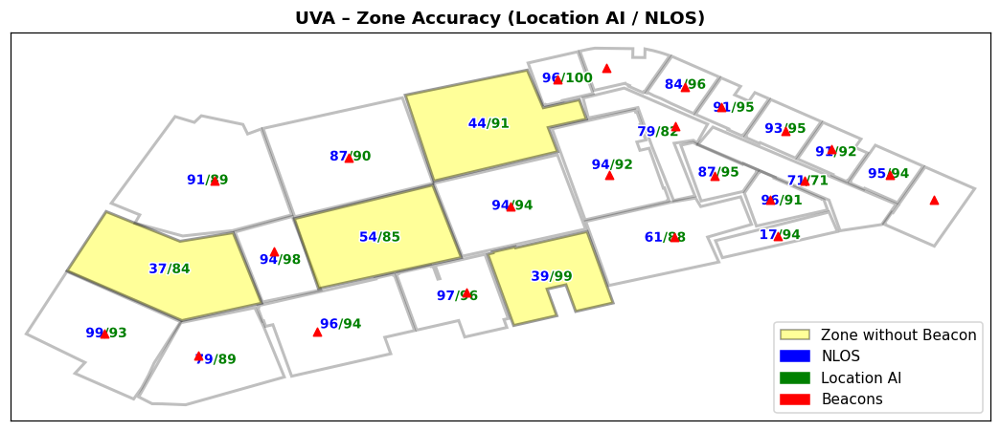

In [170]:
import matplotlib.patches as mpatches

plot_building_all_zones_LocAI(df_rooms, results_fused, result_rf,
                                            virtual_df=None, pred_col="Predicted_NLOS")

## D. Hybrid: NLOS + RF for target rooms

In [54]:
from shapely.geometry import Polygon

def build_room_geoms_from_df_rooms(df_rooms, room_col='Room_name', max_points=35):
    """
    Build room polygons and centroids from df_rooms.
    
    Returns:
        room_polygons_latlon : {room_name: Polygon(lon,lat)}
        room_centroids_latlon: {room_name: (lat, lon)}
    """
    room_polygons = {}
    room_centroids = {}

    for _, row in df_rooms.iterrows():
        coords = []
        for i in range(1, max_points+1):
            x_col = f"x{i}"
            y_col = f"y{i}"
            if x_col in row and y_col in row:
                x_val, y_val = row[x_col], row[y_col]
                if pd.notnull(x_val) and pd.notnull(y_val):
                    coords.append((x_val, y_val))  # shapely: (lon,lat)
        
        if len(coords) < 3:
            continue  # cannot form a polygon

        # ensure polygon is closed
        if coords[0] != coords[-1]:
            coords.append(coords[0])

        poly = Polygon(coords)
        if not poly.is_valid or poly.area == 0:
            continue

        room_name = str(row[room_col])
        room_polygons[room_name] = poly
        c = poly.centroid
        room_centroids[room_name] = (c.y, c.x)  # return as (lat, lon)

    return room_polygons, room_centroids


In [55]:
room_polygons_latlon, room_centroids_latlon = build_room_geoms_from_df_rooms(df_rooms)
# for r, c in room_centroids_latlon.items():
#     print(r, c)

In [108]:
import numpy as np
import pandas as pd
from shapely.geometry import Point, Polygon
from scipy.optimize import minimize
from tqdm import tqdm

# ---------------------------
# Utility functions
# ---------------------------
def euclidean_dist(point, points, height_diff=1.5):
    return np.sqrt(np.sum((points - point) ** 2, axis=1) + height_diff ** 2)

def generate_grid(center, resolution=5, radius=4):
    step = 1 / resolution
    x_vals = np.arange(center[0] - radius, center[0] + radius + step, step)
    y_vals = np.arange(center[1] - radius, center[1] + radius + step, step)
    xv, yv = np.meshgrid(x_vals, y_vals)
    return np.stack([xv.ravel(), yv.ravel()], axis=1)

def rssi_to_distance(rssi, A=-40, n=3.5, scale=0.8):
    return scale * np.exp((A - rssi) / (10 * n))

def filter_rssi(row, beacon_positions, rssi_threshold=-90):
    return {
        mac: row[mac]
        for mac in beacon_positions.keys()
        if mac in row.index and isinstance(row[mac], (int, float)) and row[mac] > rssi_threshold
    }

def localization_error(tag_position, beacons, distances):
    estimated_distances = np.linalg.norm(beacons - tag_position, axis=1)
    sigma = np.std(distances) + 1e-3
    weights = np.exp(- (distances ** 2) / (2 * sigma ** 2))
    return np.sum(weights * (estimated_distances - distances) ** 2)

def generate_expansion_area(initial_guess, std_dev=0.3, radius=0.5, num_points=50):
    num_gauss = int(num_points * 0.6)
    num_circle = num_points - num_gauss
    gauss_points = np.random.normal(0, std_dev, size=(num_gauss, 2)) + initial_guess
    r = radius * np.sqrt(np.random.uniform(0, 1, num_circle))
    theta = np.random.uniform(0, 2 * np.pi, num_circle)
    circ_points = np.column_stack((initial_guess[0] + r * np.cos(theta), initial_guess[1] + r * np.sin(theta)))
    return np.vstack((gauss_points, circ_points))

def compute_likelihood_weighted(grid_coords, anchor_coords, rssi_values, T, n, sigma_noise=4, anchor_weights=None):
    if anchor_weights is None:
        anchor_weights = np.ones_like(rssi_values)
    diff = grid_coords[:, None, :] - anchor_coords[None, :, :]
    dists = np.sqrt(np.sum(diff ** 2, axis=2) + 1.5**2)
    pred_rssi = T - 10 * n * np.log10(dists + 1e-5)
    residuals = pred_rssi - rssi_values
    weighted_residuals = (residuals / sigma_noise)**2 * anchor_weights
    likelihood = np.exp(-0.5 * weighted_residuals)
    return np.prod(likelihood, axis=1)

def find_mle_params(P_j, d_ij, init_guess=[-40, 3]):
    def squared_error(params, dists, rssi):
        T_i, n_p = params
        valid_mask = rssi != -100
        pred_rssi = T_i - 10 * n_p * np.log10(dists + 1e-5)
        return np.sum((pred_rssi[valid_mask] - rssi[valid_mask]) ** 2)
    bounds = [(-100, -30), (2, 6)]
    result = minimize(squared_error, init_guess, args=(d_ij, P_j),
                      method='L-BFGS-B', bounds=bounds)
    return result.x if result.success else init_guess

# ---------------------------
# GEO conversion functions
# ---------------------------
def latlon_to_local_xy(lat, lon, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    y_offset = (lat - origin_lat) * 111320  # meters
    x_offset = (lon - origin_lon) * 40075000 * np.cos(np.radians(origin_lat)) / 360
    return x_offset, y_offset

def local_xy_to_latlon(x_m, y_m, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    lat = origin_lat + y_m / 111320
    lon = origin_lon + x_m * 360 / (40075000 * np.cos(np.radians(origin_lat)))
    return lat, lon

def prepare_rssi_for_rf(row, rf_features, default_value=-100):
    return [row.get(f, default_value) for f in rf_features]

# ---------------------------
# Fused GEO Localization with RF
# ---------------------------
def fused_localization_geo_hybrid(
    data_df,
    anchor_point_df,
    room_polygons_latlon,
    room_centroids_latlon,
    rf_model,
    rf_features,
    target_rooms=target_rooms,
    border_threshold_m=3.0,
    prob_cutoff=0.6,
    sigma_noise=4,
    coarse_res=2,
    fine_res=5,
    fine_radius=3,
    rssi_threshold=-95,
    strong_rssi_threshold=-75,
    top_k_anchors=5,
    roi_margin=8,
    top_coarse_points=200,
    topN_ratio=0.05,
    expansion_radius=0.8,
    expansion_points=100,
    enable_refinement=True
):
    results = []

    # ---------------------------
    # Target rooms as set
    # ---------------------------
    if target_rooms is not None:
        target_rooms = set(map(str, target_rooms))

    # ---------------------------
    # Origin for local XY
    # ---------------------------
    origin_lat = anchor_point_df['y'].min()
    origin_lon = anchor_point_df['x'].min()
    origin = [origin_lon, origin_lat]

    # ---------------------------
    # Convert room polygons to local XY
    # ---------------------------
    room_polygons_xy = {}
    room_centroids_xy = {}
    for r_name, poly in room_polygons_latlon.items():
        coords_xy = [latlon_to_local_xy(lat, lon, origin) for lon, lat in poly.exterior.coords]
        poly_xy = Polygon(coords_xy)
        room_polygons_xy[r_name] = poly_xy
        room_centroids_xy[r_name] = np.array([poly_xy.centroid.x, poly_xy.centroid.y])

    # ---------------------------
    # Anchors → local XY
    # ---------------------------
    beacon_positions = {}
    anchor_coords_array = []
    for _, r in anchor_point_df.iterrows():
        x_m, y_m = latlon_to_local_xy(r["y"], r["x"], origin)
        beacon_positions[r["Mac"]] = {"x": x_m, "y": y_m}
        anchor_coords_array.append([x_m, y_m])
    anchor_coords_array = np.array(anchor_coords_array)
    anchor_macs = anchor_point_df["Mac"].values

    # ---------------------------
    # Main loop
    # ---------------------------
    for idx, row in tqdm(data_df.iterrows(), total=len(data_df)):

        rssis = np.array([row.get(mac, -100) for mac in anchor_macs], dtype=float)

        # ---------- MLE ----------
        mask = rssis > rssi_threshold
        sig = rssis[mask]
        coords = anchor_coords_array[mask]
        if len(sig) < 1:
            sig, coords = rssis, anchor_coords_array

        strong = sig > strong_rssi_threshold
        sig_sel = sig[strong] if np.sum(strong) >= 2 else sig
        coords_sel = coords[strong] if np.sum(strong) >= 2 else coords

        weights = (sig_sel - sig_sel.min() + 1) / (sig_sel.ptp() + 1e-5)
        top_coords = coords_sel[np.argsort(-sig_sel)[:top_k_anchors]]

        coarse_grid = generate_grid(np.mean(top_coords, axis=0), coarse_res, roi_margin)
        dfit = euclidean_dist(top_coords[0], coords_sel)
        T, n = find_mle_params(sig_sel, dfit)
        like = compute_likelihood_weighted(coarse_grid, coords_sel, sig_sel, T, n)
        best = coarse_grid[np.argsort(-like)[:top_coarse_points]]

        fine = np.vstack([generate_grid(c, fine_res, fine_radius) for c in best])
        fine_like = compute_likelihood_weighted(fine, coords_sel, sig_sel, T, n)
        fine_like = (fine_like + 1e-12) / np.sum(fine_like)
        N = max(1, int(topN_ratio * len(fine)))
        idx_top = np.argsort(-fine_like)[:N]
        pred_mle = np.average(fine[idx_top], axis=0, weights=fine_like[idx_top])

        # ---------- OPT ----------
        rssi_opt = filter_rssi(row, beacon_positions)
        if len(rssi_opt) == 0:
            beacon_xy = anchor_coords_array
            dist_opt = np.ones(anchor_coords_array.shape[0])
        else:
            beacon_xy = np.array([list(beacon_positions[b].values()) for b in rssi_opt])
            dist_opt = np.array([rssi_to_distance(v) for v in rssi_opt.values()])

        exp = generate_expansion_area(pred_mle, radius=expansion_radius, num_points=expansion_points)
        pred_opt = min(exp, key=lambda p: localization_error(p, beacon_xy, dist_opt))

        pred_fused = 0.5 * pred_mle + 0.5 * pred_opt

        # ---------- RF SNAP only if near target rooms ----------
        snapped_room = None
        corrected_xy = pred_fused.copy()
        p = Point(pred_fused)

        nearest_room, min_dist = None, float("inf")
        for r in room_polygons_xy:
            if target_rooms is not None and r not in target_rooms:
                continue  # <-- only consider target rooms
            poly = room_polygons_xy[r]
            d = p.distance(poly)
            if d < min_dist:
                min_dist, nearest_room = d, r

        if min_dist <= border_threshold_m and nearest_room is not None:
            rssi_vec = prepare_rssi_for_rf(row, rf_features)
            probs = rf_model.predict_proba([rssi_vec])[0]
            cls = rf_model.classes_[np.argmax(probs)]
            if np.max(probs) >= prob_cutoff:
                corrected_xy = room_centroids_xy[cls]
                snapped_room = cls

        # ---------- Convert to lat/lon ----------
        pred_hybrid_latlon = local_xy_to_latlon(corrected_xy[0], corrected_xy[1], origin)
        pred_nlos_latlon = local_xy_to_latlon(pred_fused[0], pred_fused[1], origin)
        pred_mle_latlon = local_xy_to_latlon(pred_mle[0], pred_mle[1], origin)
        pred_opt_latlon = local_xy_to_latlon(pred_opt[0], pred_opt[1], origin)

        results.append({
            'original_index': idx,
            'Zone_id': row.get('Zone_id', np.nan),
            'Room_name': row.get('Room_name', np.nan),
            'Tag_id': row.get('tagId', np.nan),
            'timestamp': row.get('timestamp', np.nan),
            'Predicted_MLE': pred_mle_latlon,
            'Predicted_Opt': pred_opt_latlon,
            'Predicted_NLOS': pred_nlos_latlon,
            'Predicted_Hybrid': pred_hybrid_latlon,
            'Snapped_Room': snapped_room
        })

    return pd.DataFrame(results)



In [144]:
start_time = time.perf_counter() 

results_hybrid = fused_localization_geo_hybrid(
    data_df=data_set_df, 
    anchor_point_df=anchor_point_df, 
    room_polygons_latlon=room_polygons_latlon,
    room_centroids_latlon=room_centroids_latlon,

    rf_model=rf_model, 
    rf_features= rf_features, 

)

results_hybrid.to_csv("Result_Final/NLOS_Hybrid.csv", index= False)

end_time = time.perf_counter() 

total_time = end_time - start_time
avg_time_per_row = total_time / len(df1)
print(avg_time_per_row)

100%|███████████████████████████████████████| 7025/7025 [11:35<00:00, 10.10it/s]


0.0989996004922419


In [186]:
results_hybrid= results_hybrid.merge(result_d[["Zone_id", "Room_Type", "Has_Beacon"]], \
                                     on="Zone_id", how="left")
results_hybrid.to_csv("Result_Final/NLOS_Hybrid.csv", index= False)

In [110]:
results_hybrid=pd.read_csv("Result_Final/NLOS_Hybrid.csv")
results_hybrid.head(1)

,original_index,Zone_id,Room_name,Tag_id,timestamp,Predicted_MLE,Predicted_Opt,Predicted_NLOS,Predicted_Hybrid,Snapped_Room,Room_Type,Has_Beacon
0,0,37976,G224A,2042196,2025-08-18 22:13:33.388026+00:00,"(38.030915350979996, -78.49766327876124)","(38.03091723300714, -78.49765563557227)","(38.03091629199357, -78.49765945716675)","(38.03091629199357, -78.49765945716675)",NaN,Open,Yes


In [111]:
results_hybrid.Snapped_Room.unique()

array([nan, 'G224H', 'G225F', 'G225-C4', 'G225C', 'G225G', 'G225N',
       'G225-C2'], dtype=object)

In [114]:
results_hybrid.columns

Index(['original_index', 'Zone_id', 'Room_name', 'Tag_id', 'timestamp',
       'Predicted_MLE', 'Predicted_Opt', 'Predicted_NLOS', 'Predicted_Hybrid',
       'Snapped_Room', 'Room_Type', 'Has_Beacon'],
      dtype='object')

In [116]:
def plot_all_zones_hybrid(
    df_rooms,
    results_df1,   # NLOS results (point predictions)
    results_df2,   # Location AI + Hybrid accuracies
    virtual_df=None,
    pred_col="Predicted_Opt",
    pred_col2="Predicted_Hybrid"
):
    import ast
    import numpy as np
    import pandas as pd
    import matplotlib.pyplot as plt
    import matplotlib.patches as mpatches
    import matplotlib.patheffects as path_effects
    from shapely.geometry import Polygon as ShapelyPolygon, Point
    from matplotlib.patches import Polygon as MplPolygon

    # =============================
    # Target & Nearby Rooms
    # =============================
    target_rooms = ["G225F"]

    nearby_rooms =['G225C', 'G224H', 'G225G', 'G224-2', 'G225-C2', 'G225-C4', "G225N"]

    # =============================
    # Build room polygons
    # =============================
    room_coords_dict = {}

    for _, row in df_rooms.iterrows():
        coords = []
        for i in range(1, 25):
            xcol, ycol = f"x{i}", f"y{i}"
            if xcol in row and ycol in row:
                x, y = row[xcol], row[ycol]
                if pd.notnull(x) and pd.notnull(y):
                    coords.append((float(x), float(y)))

        if len(coords) >= 3:
            room_coords_dict[row["Room_name"]] = coords

    unique_rooms = df_rooms["Room_name"].unique()

    all_coords = np.array(
        [pt for coords in room_coords_dict.values() for pt in coords]
    )

    xmin, xmax = all_coords[:, 0].min() - 0.00001, all_coords[:, 0].max() + 0.00001
    ymin, ymax = all_coords[:, 1].min() - 0.00001, all_coords[:, 1].max() + 0.00001

    fig, ax = plt.subplots(figsize=(12, 8))
    ax.set_aspect("equal")
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.grid(False)

    # =============================
    # Beacon points (if exist)
    # =============================
    beacon_points = []
    if "beacon_x" in globals() and "beacon_y" in globals():
        beacon_points = [Point(x, y) for x, y in zip(beacon_x, beacon_y)]

    # =============================
    # Plot rooms
    # =============================
    for r in unique_rooms:

        if r not in room_coords_dict:
            continue

        coords = room_coords_dict[r]
        polygon = ShapelyPolygon(coords)

        if not polygon.is_valid:
            polygon = polygon.buffer(0)

        # ---------------------------------
        # Beacon presence
        # ---------------------------------
        has_beacon = any(polygon.contains(bp) for bp in beacon_points)

        # ---------------------------------
        # Room coloring logic
        # ---------------------------------
        if r in target_rooms:
            facecolor = "yellow"
            alpha = 0.6
        
  
        elif not has_beacon:
            facecolor = "lightgrey"
            alpha = 0.4
        elif r in nearby_rooms:
            facecolor = "none"
            edgecolor = "black"       # red border
            linewidth = 2.5
            alpha = 1.0
        else:
            facecolor = "none"
            alpha = 0.25

        ax.add_patch(
            MplPolygon(
                coords,
                closed=True,
                edgecolor="black",
                facecolor=facecolor,
                linewidth=2.0,
                alpha=alpha,
                zorder=1
            )
        )

        # =============================
        # Accuracy Computation
        # =============================
        acc_nlos, acc_locai, acc_hybrid = None, None, None

        # -------- NLOS accuracy --------
        room_data1 = results_df1[results_df1["Room_name"] == r]
        if not room_data1.empty:
            inside_flags = []
            for coord in room_data1[pred_col]:
                try:
                    if isinstance(coord, str):
                        coord = ast.literal_eval(coord)
                    lat, lon = float(coord[0]), float(coord[1])
                    inside_flags.append(Point(lon, lat).within(polygon))
                except Exception:
                    continue

            if inside_flags:
                acc_nlos = sum(inside_flags) / len(inside_flags) * 100
                
        # -------- Hybrid accuracy --------
        room_data1 = results_df1[results_df1["Room_name"] == r]
        if not room_data1.empty:
            inside_flags = []
            for coord in room_data1[pred_col2]:
                try:
                    if isinstance(coord, str):
                        coord = ast.literal_eval(coord)
                    lat, lon = float(coord[0]), float(coord[1])
                    inside_flags.append(Point(lon, lat).within(polygon))
                except Exception:
                    continue

            if inside_flags:
                acc_hybrid = sum(inside_flags) / len(inside_flags) * 100        
            
        # -------- Location AI --------
        room_data2 = results_df2[results_df2["Room_name"] == r]
        if not room_data2.empty:
            if "Accuracy" in room_data2.columns:
                acc_locai = float(room_data2["Accuracy"].iloc[0])


        # =============================
        # Draw accuracy text

        cx, cy = polygon.centroid.x, polygon.centroid.y

        if acc_nlos is not None or acc_locai is not None or acc_hybrid is not None:

            txt_nlos = f"{acc_nlos:.0f}" if acc_nlos is not None else "--"
            txt_locai = f"{acc_locai:.0f}" if acc_locai is not None else "--"
            txt_hyb = f"{acc_hybrid:.0f}" if acc_hybrid is not None else "--"

            dx = (xmax - xmin) * 0.009  # horizontal spacing (scale-safe)

            # LocAI (left)
            ax.text(
                cx - dx, cy,
                txt_locai,
                ha="right", va="center",
                fontsize=9, # weight="bold",
                color="blue",
                path_effects=[path_effects.withStroke(linewidth=2, foreground="white")]
            )

            # nlos (center)
            ax.text(
                cx, cy,
                f"/{txt_nlos}",
                ha="center", va="center",
                fontsize=9, #weight="bold",
                color="green",
                path_effects=[path_effects.withStroke(linewidth=2, foreground="white")]
            )

            # Hybrid (right)
            ax.text(
                cx + dx, cy,
                f"/{txt_hyb}",
                ha="left", va="center",
                fontsize=9,
                color="purple",
                path_effects=[path_effects.withStroke(linewidth=2, foreground="white")]
            )


    # =============================
    # Plot beacons
    # =============================
    if beacon_points:
        ax.scatter(
            beacon_x,
            beacon_y,
            marker="^",
            s=20,
            color="red",
            label="Beacons",
            zorder=4
        )

    # =============================
    # Legend
    # =============================
    legend_handles = [
        mpatches.Patch(facecolor="yellow", edgecolor="black", label="Propar Room"),
        mpatches.Patch(facecolor="none", edgecolor="black", alpha=1, label="Nearby Rooms need Radiomap"),
        mpatches.Patch(facecolor="grey", edgecolor="black", alpha=0.4, label="Zone without Beacon"),
        mpatches.Patch(color="blue", label="Location AI"),
        mpatches.Patch(color="green", label="NLOS"),
        
        mpatches.Patch(color="purple", label="Hybrid"),
#         mpatches.Patch(color="red", label="Beacons"),
    ]

    ax.legend(handles=legend_handles, loc="lower right")

    plt.title(
        "UVA – Zone Accuracy: Location AI/ NLOS/ Hybrid",
        fontsize=12,
        weight="bold"
    )

    plt.show()


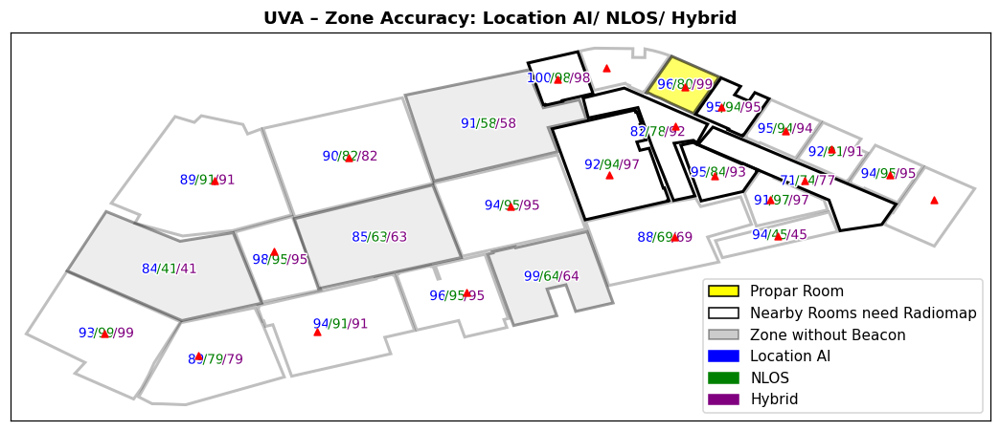

In [119]:
import matplotlib.patches as mpatches

plot_all_zones_hybrid(df_rooms, results_hybrid, result_rf,
                                virtual_df=None, pred_col="Predicted_NLOS", pred_col2="Predicted_Hybrid")

In [118]:
def compute_accuracy_with_beacon(results_df, df_rooms, pred_cols=["Predicted_NLOS","Predicted_Hybrid"]):
    import ast
    import pandas as pd
    from shapely.geometry import Polygon, Point

    # -------------------------------
    # Build room polygons from df_rooms
    # -------------------------------
    room_polygons = {}
    for _, row in df_rooms.iterrows():
        coords = []
        for i in range(1, 25):
            xcol, ycol = f"x{i}", f"y{i}"
            if xcol in row and ycol in row and pd.notnull(row[xcol]) and pd.notnull(row[ycol]):
                coords.append((float(row[xcol]), float(row[ycol])))  # (lon, lat)
        if len(coords) >= 3:
            room_polygons[row["Room_name"]] = Polygon(coords)

    # -------------------------------
    # Normalize Has_Beacon
    # -------------------------------
    results_df = results_df.copy()
    results_df["Has_Beacon_bool"] = results_df["Has_Beacon"].apply(
        lambda x: True if str(x).strip().lower() in ["yes","true"] else False
    )

    summary_rows = []

    # -------------------------------
    # Loop over Has_Beacon groups
    # -------------------------------
    for hb_val, hb_label in [(True,"Has_Beacon"), (False,"No_Beacon")]:
        hb_df = results_df[results_df["Has_Beacon_bool"] == hb_val]

        for pred_col in pred_cols:
            # Overall accuracy
            total = len(hb_df)
            correct = 0
            for _, row in hb_df.iterrows():
                try:
                    pred_coord = row[pred_col]
                    if isinstance(pred_coord, str):
                        pred_coord = ast.literal_eval(pred_coord)
                    if pred_coord is None:
                        continue
                    gt_room = row["Room_name"]
                    poly = room_polygons.get(gt_room)
                    if poly is None:
                        continue
                    # Shapely uses (x, y) = (lon, lat)
                    pt = Point(pred_coord[1], pred_coord[0])
                    if pt.within(poly):
                        correct += 1
                except:
                    continue

            summary_rows.append({
                "Has_Beacon": hb_label,
                "Level": "Overall",
                "Group": "All",
                "Method": pred_col,
                "Correct": correct,
                "Total": total,
                "Accuracy (%)": 100 * correct / max(1, total)
            })

            # Accuracy by Room_Type
            for room_type, sub_df in hb_df.groupby("Room_Type"):
                total_rt = len(sub_df)
                correct_rt = 0
                for _, row in sub_df.iterrows():
                    try:
                        pred_coord = row[pred_col]
                        if isinstance(pred_coord, str):
                            pred_coord = ast.literal_eval(pred_coord)
                        if pred_coord is None:
                            continue
                        gt_room = row["Room_name"]
                        poly = room_polygons.get(gt_room)
                        if poly is None:
                            continue
                        pt = Point(pred_coord[1], pred_coord[0])
                        if pt.within(poly):
                            correct_rt += 1
                    except:
                        continue

                summary_rows.append({
                    "Has_Beacon": hb_label,
                    "Level": "Room_Type",
                    "Group": room_type,
                    "Method": pred_col,
                    "Correct": correct_rt,
                    "Total": total_rt,
                    "Accuracy (%)": 100 * correct_rt / max(1, total_rt)
                })

    return pd.DataFrame(summary_rows)


In [234]:
compute_accuracy_with_beacon(results_hybrid, df_rooms, pred_cols=["Predicted_NLOS", "Predicted_Hybrid"])

,Has_Beacon,Level,Group,Method,Correct,Total,Accuracy (%)
0,Has_Beacon,Overall,All,Predicted_NLOS,425983,492009,86.580327
1,Has_Beacon,Room_Type,Open,Predicted_NLOS,177208,213555,82.980029
2,Has_Beacon,Room_Type,Room,Predicted_NLOS,248775,278454,89.341507
3,Has_Beacon,Overall,All,Predicted_Hybrid,435964,492009,88.608948
4,Has_Beacon,Room_Type,Open,Predicted_Hybrid,180435,213555,84.491115
5,Has_Beacon,Room_Type,Room,Predicted_Hybrid,255529,278454,91.767042
6,No_Beacon,Overall,All,Predicted_NLOS,59448,106060,56.051292
7,No_Beacon,Room_Type,Open,Predicted_NLOS,45516,84271,54.011463
8,No_Beacon,Room_Type,Room,Predicted_NLOS,13932,21789,63.940520
9,No_Beacon,Overall,All,Predicted_Hybrid,59448,106060,56.051292


In [232]:
results_hybrid.Has_Beacon.unique()

array(['Yes', 'No'], dtype=object)

In [235]:
results_hybrid.head(1)

,original_index,Zone_id,Room_name,Tag_id,timestamp,Predicted_MLE,Predicted_Opt,Predicted_NLOS,Predicted_Hybrid,Snapped_Room,Room_Type,Has_Beacon
0,0,37976,G224A,2042196,2025-08-18 22:13:33.388026+00:00,"(38.030915350979996, -78.49766327876124)","(38.03091723300714, -78.49765563557227)","(38.03091629199357, -78.49765945716675)","(38.03091629199357, -78.49765945716675)",NaN,Open,Yes


### Sliding 3

In [ ]:
import pandas as pd
import numpy as np
from ast import literal_eval

def safe_eval(x):
    if isinstance(x, str):
        return literal_eval(x)
    return x

def compute_centroid(points):
    xs, ys = zip(*points)
    return [np.mean(xs), np.mean(ys)]

def sliding_window_nlos_centroid(df, window_sizes=range(1, 11)):
    """
    Compute sliding-window centroids for Predicted_NLOS column only.

    Args:
        df (pd.DataFrame): Input DataFrame with columns ['Zone_id', 'Room_name', 'Tag_id', 'timestamp', 'Predicted_NLOS']
        window_sizes (iterable): list or range of window sizes to compute

    Returns:
        pd.DataFrame: centroid results per window size
    """
    df = df.copy()
    df['Predicted_NLOS'] = df['Predicted_NLOS'].apply(safe_eval)
    df = df.sort_values('timestamp').reset_index(drop=True)

    all_results = []
    group_cols = ['Zone_id', 'Room_name', 'Tag_id']

    for window_size in window_sizes:
        for group_keys, group in df.groupby(group_cols):
            group = group.sort_values('timestamp').reset_index(drop=True)
            n = len(group)

            for i in range(n):
                # Determine sliding window boundaries
                if i < window_size:
                    start, end = 0, i + 1
                else:
                    start, end = i - window_size + 1, i + 1

                window = group.iloc[start:end]
                nlos_points = list(window['Predicted_NLOS'])

                centroid = compute_centroid(nlos_points)

                all_results.append({
                    'Zone_id': group_keys[0],
                    'Room_name': group_keys[1],
                    'Tag_id': group_keys[2],
                    'timestamp': group.iloc[i]['timestamp'],
                    'Window_Size': window_size,
                    'Predicted_NLOS_Centroid': centroid
                })

    return pd.DataFrame(all_results)


In [ ]:
import numpy as np
import pandas as pd
from ast import literal_eval

def sliding_window_nlos_centroid_fast(df, window_sizes=range(1, 11)):
    df = df.copy()

    # Convert string to list only if needed
    if df['Predicted_NLOS'].dtype == object:
        df['Predicted_NLOS'] = df['Predicted_NLOS'].apply(
            lambda x: literal_eval(x) if isinstance(x, str) else x
        )

    # Split coordinates
    coords = pd.DataFrame(df['Predicted_NLOS'].tolist(), columns=['x', 'y'])
    df = pd.concat([df, coords], axis=1)

    df = df.sort_values('timestamp')

    group_cols = ['Zone_id', 'Room_name', 'Tag_id']
    results = []

    for w in window_sizes:
        temp = df.copy()
        temp['Window_Size'] = w

        temp['centroid_x'] = (
            temp.groupby(group_cols)['x']
            .rolling(window=w, min_periods=1)
            .mean()
            .reset_index(level=group_cols, drop=True)
        )

        temp['centroid_y'] = (
            temp.groupby(group_cols)['y']
            .rolling(window=w, min_periods=1)
            .mean()
            .reset_index(level=group_cols, drop=True)
        )

        temp['Predicted_NLOS_Centroid'] = temp[['centroid_x', 'centroid_y']].values.tolist()

        results.append(
            temp[
                group_cols + ['timestamp', 'Window_Size', 'Predicted_NLOS_Centroid']
            ]
        )

    return pd.concat(results, ignore_index=True)


In [ ]:
results_hybrid=pd.read_csv("Result_Final/NLOS_Hybrid.csv")
results_hybrid.head(1)

In [ ]:
centroid_result1 = sliding_window_nlos_centroid_fast(
    results_hybrid,
    window_sizes=range(3, 4)
)

centroid_result = centroid_result1.merge(
    results_hybrid[['Zone_id', 'Room_Type', 'Has_Beacon']],
    on='Zone_id',
    how='left'
)

centroid_result.head()


In [ ]:
# compute_accuracy_with_beacon(centroid_result, df_rooms, pred_cols=["Predicted_NLOS_Centroid"])

In [46]:
import pandas as pd
import numpy as np
import ast
import matplotlib.pyplot as plt
from shapely.geometry import Polygon as ShapelyPolygon, Point
from matplotlib.patches import Polygon as MplPolygon

def plot_building_all_zones(df_rooms, results_df, pred_col="Predicted_Optimisation", result_rf=None):
    # --- Build polygons for each room ---
    room_coords_dict = {}
    for _, row in df_rooms.iterrows():
        coords = []
        for i in range(1, 25):
            xcol, ycol = f"x{i}", f"y{i}"
            if xcol in row and ycol in row:
                x, y = row[xcol], row[ycol]
                if pd.notnull(x) and pd.notnull(y):
                    coords.append((float(x), float(y)))
        if len(coords) >= 3:
            room_coords_dict[row["Room_name"]] = coords

    # --- All rooms should come from df_rooms (not only predictions) ---
    unique_rooms = df_rooms["Room_name"].unique()

    # --- Precompute full building limits ---
    all_coords = np.array([pt for coords in room_coords_dict.values() for pt in coords])
    xmin, xmax = all_coords[:, 0].min() - 0.00001, all_coords[:, 0].max() + 0.00001
    ymin, ymax = all_coords[:, 1].min() - 0.00001, all_coords[:, 1].max() + 0.00001

    # --- Create single plot ---
    fig, ax = plt.subplots(figsize=(12, 8))
    ax.set_aspect("equal")
    ax.grid(False)
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.set_xticks([])
    ax.set_yticks([])

    # --- Assign unique colors to rooms ---
    cmap = plt.cm.get_cmap("tab20", len(unique_rooms))  # up to 20 unique colors
    summary_records = []

    for i, r in enumerate(unique_rooms):
        color = cmap(i)

        if r not in room_coords_dict:
            continue

        # --- Draw polygon ---
        coords = room_coords_dict[r]
        ax.add_patch(MplPolygon(coords, closed=True,
                                edgecolor=color, facecolor="none",
                                linewidth=2.5, alpha=0.9, zorder=1))

        polygon = ShapelyPolygon(coords)
        if not polygon.is_valid:
            polygon = polygon.buffer(0)

        # --- Get predictions (if exist for this room) ---
        room_data = results_df[results_df["Room_name"] == r] if "Room_name" in results_df.columns else pd.DataFrame()
        pred_x, pred_y, inside_flags = [], [], []

        for coord in room_data[pred_col] if not room_data.empty else []:
            try:
                if isinstance(coord, str):
                    coord = ast.literal_eval(coord)
                if coord is None or len(coord) != 2:
                    continue
                lon, lat = float(coord[1]), float(coord[0])  # swap
                pred_x.append(lon)
                pred_y.append(lat)
                inside_flags.append(Point(lon, lat).within(polygon))
            except Exception:
                continue

        # --- Accuracy ---
        inside_count = sum(inside_flags)
        total_points = len(inside_flags)
        acc = (inside_count / total_points * 100) if total_points else 0

        summary_records.append({
            "Room_name": r,
            "Total_Points": total_points,
            "Inside_Points": inside_count,
            "Accuracy": acc if total_points else None
        })

        # --- Place accuracy text (always, even if no points) ---
        cx, cy = polygon.centroid.x, polygon.centroid.y
        dx = (polygon.bounds[2] - polygon.bounds[0]) * 0.1  # offset ~5% of width
        dy = (polygon.bounds[3] - polygon.bounds[1]) * 0.05  # offset ~5% of height

        label = f"{acc:.0f}%" if total_points else ""
        ax.text(cx + dx, cy + dy, label, ha="center", va="center",
                fontsize=10, color="black", weight="bold", zorder=5)

    # --- Beacons (optional if defined globally) ---
    if "beacon_x" in globals() and "beacon_y" in globals():
        ax.scatter(beacon_x, beacon_y,
                   marker="^", s=50, color="red", label="Beacons", zorder=4)

    plt.title("UVA Accuracy (%)", fontsize=14, weight="bold")
    plt.show()

    return pd.DataFrame(summary_records)


In [47]:
def plot_building_all_zones(df_rooms, results_df, pred_col="Predicted_Optimisation", result_rf=None):
    # --- Build polygons for each room ---
    room_coords_dict = {}
    for _, row in df_rooms.iterrows():
        coords = []
        for i in range(1, 25):
            xcol, ycol = f"x{i}", f"y{i}"
            if xcol in row and ycol in row:
                x, y = row[xcol], row[ycol]
                if pd.notnull(x) and pd.notnull(y):
                    coords.append((float(x), float(y)))
        if len(coords) >= 3:
            room_coords_dict[row["Room_name"]] = coords

    # --- All rooms should come from df_rooms (not only predictions) ---
    unique_rooms = df_rooms["Room_name"].unique()

    # --- Precompute full building limits ---
    all_coords = np.array([pt for coords in room_coords_dict.values() for pt in coords])
    xmin, xmax = all_coords[:, 0].min() - 0.00001, all_coords[:, 0].max() + 0.00001
    ymin, ymax = all_coords[:, 1].min() - 0.00001, all_coords[:, 1].max() + 0.00001

    # --- Create single plot ---
    fig, ax = plt.subplots(figsize=(12, 8))
    ax.set_aspect("equal")
    ax.grid(False)
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.set_xticks([])
    ax.set_yticks([])

    # --- Assign unique colors to rooms ---
    cmap = plt.cm.get_cmap("tab20", len(unique_rooms))  # up to 20 unique colors
    summary_records = []

    for i, r in enumerate(unique_rooms):
        if r not in room_coords_dict:
            continue

        coords = room_coords_dict[r]
        polygon = ShapelyPolygon(coords)
        if not polygon.is_valid:
            polygon = polygon.buffer(0)

        # --- Check if room contains a beacon ---
        has_beacon = False
        if "beacon_x" in globals() and "beacon_y" in globals():
            for bx, by in zip(beacon_x, beacon_y):
                if Point(bx, by).within(polygon):
                    has_beacon = True
                    break

        # --- Draw polygon ---
        facecolor = "none" if has_beacon else plt.cm.tab20(i % 20)  # color only if no beacon
        ax.add_patch(MplPolygon(coords, closed=True,
                                edgecolor="black", facecolor=facecolor,
                                linewidth=2.0, alpha=0.9, zorder=1))

        # --- Get predictions ---
        room_data = results_df[results_df["Room_name"] == r] if "Room_name" in results_df.columns else pd.DataFrame()
        inside_flags = []
        for coord in room_data[pred_col] if not room_data.empty else []:
            try:
                if isinstance(coord, str):
                    coord = ast.literal_eval(coord)
                if coord and len(coord) == 2:
                    lon, lat = float(coord[1]), float(coord[0])  # swap
                    inside_flags.append(Point(lon, lat).within(polygon))
            except Exception:
                continue

        inside_count = sum(inside_flags)
        total_points = len(inside_flags)
        acc = (inside_count / total_points * 100) if total_points else 0

        summary_records.append({
            "Room_name": r,
            "Total_Points": total_points,
            "Inside_Points": inside_count,
            "Accuracy": acc if total_points else None
        })

        # --- Place accuracy text ---
        cx, cy = polygon.centroid.x, polygon.centroid.y
        dx = (polygon.bounds[2] - polygon.bounds[0]) * 0.1
        dy = (polygon.bounds[3] - polygon.bounds[1]) * 0.05
        label = f"{acc:.0f}%" if total_points else ""

        # highlight text if no beacon
        text_kwargs = dict(ha="center", va="center",
                           fontsize=10, zorder=5)
        if not has_beacon:
            text_kwargs["color"] = "white"
            text_kwargs["bbox"] = dict(facecolor="red", alpha=0.6, boxstyle="round,pad=0.2")
        else:
            text_kwargs["color"] = "black"

        ax.text(cx + dx, cy + dy, label, **text_kwargs)

    # --- Beacons (optional if defined globally) ---
    if "beacon_x" in globals() and "beacon_y" in globals():
        ax.scatter(beacon_x, beacon_y,
                   marker="^", s=50, color="red", label="Beacons", zorder=4)

    plt.title("UVA Accuracy (%)", fontsize=12, weight="bold")
    plt.show()

    return pd.DataFrame(summary_records)

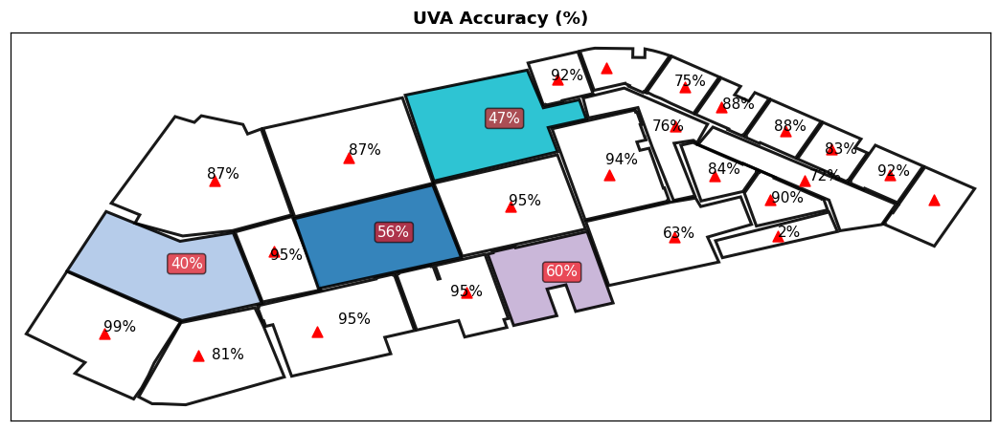

,Room_name,Total_Points,Inside_Points,Accuracy
0,G224E,289,275,95.155709
1,G225C,267,251,94.007491
2,G224F,267,253,94.756554
3,G224H,261,241,92.337165
4,G224-3,262,248,94.656489
5,G225F,259,195,75.289575
6,G225J,329,274,83.282675
7,G225M,267,239,89.513109
8,G225L,0,0,NaN
9,G224G,269,161,59.851301


In [48]:
plot_building_all_zones(df_rooms, result, pred_col="Predicted_Optimisation", result_rf=None)

### Virtual beacons

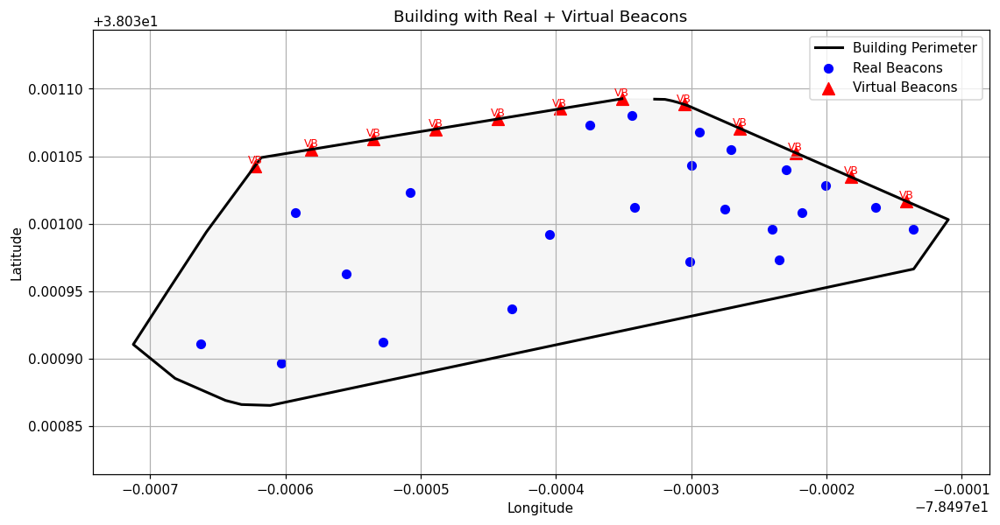

In [353]:
from scipy.spatial import ConvexHull
from geopy.distance import geodesic, distance

# 1. Convert lat/lon <-> local meters
# -------------------------------
def latlon_to_local_xy(lat, lon, origin):
    origin_lat, origin_lon = origin
    y_offset = geodesic((origin_lat, origin_lon), (lat, origin_lon)).meters
    x_offset = geodesic((origin_lat, origin_lon), (origin_lat, lon)).meters
    if lat < origin_lat:
        y_offset *= -1
    if lon < origin_lon:
        x_offset *= -1
    return x_offset, y_offset

def local_xy_to_latlon(x_m, y_m, origin):
    origin_lat, origin_lon = origin
    origin_point = (origin_lat, origin_lon)
    point_north = distance(meters=y_m).destination(origin_point, bearing=0)
    final_point = distance(meters=x_m).destination((point_north.latitude, point_north.longitude), bearing=90)
    return final_point.latitude, final_point.longitude

# 2. Prepare building coordinates in meters
# -------------------------------
all_rooms_coords_latlon = []
for _, row in df_rooms.iterrows():
    for i in range(1,24):
        xcol, ycol = f"x{i}", f"y{i}"
        if xcol in row and ycol in row:
            lat, lon = row[ycol], row[xcol]
            if pd.notnull(lat) and pd.notnull(lon):
                all_rooms_coords_latlon.append([lat, lon])

all_rooms_coords_latlon = np.array(all_rooms_coords_latlon)
origin = [all_rooms_coords_latlon[:,0].min(), all_rooms_coords_latlon[:,1].min()]

all_rooms_coords_m = np.array([latlon_to_local_xy(lat, lon, origin) 
                               for lat, lon in all_rooms_coords_latlon])

# 3. Convex hull for building perimeter
# -------------------------------
hull = ConvexHull(all_rooms_coords_m)
building_perimeter_m = all_rooms_coords_m[hull.vertices]

# 4. Place virtual beacons (~10) outside perimeter
# -------------------------------
def place_virtual_beacons(perimeter_coords, num_beacons=10, offset=0):
    coords = np.vstack([perimeter_coords, perimeter_coords[0]])
    dists = np.sqrt(np.sum(np.diff(coords, axis=0)**2, axis=1))
    cumdist = np.hstack([0, np.cumsum(dists)])
    total_length = cumdist[-1]
    target_dists = np.linspace(0, total_length, num_beacons+1)[:-1]

    virtual_beacons = []
    for td in target_dists:
        idx = np.searchsorted(cumdist, td) - 1
        t = (td - cumdist[idx]) / (cumdist[idx+1] - cumdist[idx])
        p = (1-t)*coords[idx] + t*coords[idx+1]

        edge_vec = coords[idx+1] - coords[idx]
        norm_len = np.linalg.norm(edge_vec)
        if norm_len < 1e-6:
            norm = np.array([0.0, 0.0])
        else:
            norm = np.array([-edge_vec[1], edge_vec[0]]) / norm_len

        virtual_point = p + offset * norm
        virtual_beacons.append(virtual_point)

    virtual_beacons = np.array(virtual_beacons)
    return virtual_beacons[~np.isnan(virtual_beacons).any(axis=1)]


virtual_beacons_m = place_virtual_beacons(building_perimeter_m, num_beacons=30, offset=0)
virtual_beacons_latlon = np.array([local_xy_to_latlon(x, y, origin) 
                                   for x, y in virtual_beacons_m])
df_virtual = pd.DataFrame(virtual_beacons_latlon, columns=["lat","lon"])
df_virtual["is_virtual"] = True
### This will create multi beacon around all periphery and then manully remove some so i can have a few beacon only
df_virtual.to_csv("virtual_beacon_30.csv", index=False)
### Remove some beacon from above file

df_virtual= df_virtual[
    (df_virtual["lat"] > 38.031) &
    (df_virtual["lon"] > -78.49763) &
    (df_virtual["lon"] < -78.4971)
].reset_index(drop=True)

# df_virtual=pd.read_csv("virtual_beacon.csv")
# -------------------------------
# 5. Plotting
# -------------------------------
plt.figure(figsize=(12,6))

# Building perimeter
building_perimeter_latlon = np.array([local_xy_to_latlon(x, y, origin) 
                                     for x, y in building_perimeter_m])
plt.plot(building_perimeter_latlon[:,1], building_perimeter_latlon[:,0], 'k-', lw=2, label='Building Perimeter')
plt.fill(building_perimeter_latlon[:,1], building_perimeter_latlon[:,0], color='lightgrey', alpha=0.2)

# Real beacons
plt.scatter(anchor_point_df["x"], anchor_point_df["y"], c='blue', s=40, marker='o', label='Real Beacons')

# Virtual beacons
plt.scatter(df_virtual["lon"], df_virtual["lat"], c='red', s=80, marker='^', label='Virtual Beacons')
for _, r in df_virtual.iterrows():
    plt.text(r["lon"], r["lat"], "VB", color='red', fontsize=8, ha='center', va='bottom')

plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Building with Real + Virtual Beacons")
plt.axis('equal')
plt.grid(True)
plt.legend()

In [354]:
def add_virtual_beacons(real_df, virtual_df, start_mac=100000000000, mac_step=1):
    """
    Convert virtual beacon lat/lon into x/y, assign random MACs,
    and combine with real beacons.
    """
    # Copy to avoid mutating input
    virtuals = virtual_df.copy()

    # Rename lat/lon → y/x
    virtuals = virtuals.rename(columns={"lat": "y", "lon": "x"})

    # Assign MACs
    existing_macs = set(real_df["Mac"].astype(str))
    macs = []
    mac_counter = start_mac

    for _ in range(len(virtuals)):
        mac = f"{mac_counter:012x}"  # hex-like MAC
        while mac in existing_macs:
            mac_counter += mac_step
            mac = f"{mac_counter:012x}"
        macs.append(mac)
        mac_counter += mac_step

    virtuals["Mac"] = macs
    virtuals["Type"] = "virtual"


    # Select the same structure as real_df
    virtuals = virtuals[["x", "y", "Mac", "Type"]]

    # Add missing 'Type' column in real_df if not exists
    if "Type" not in real_df.columns:
        real_df = real_df.copy()
        real_df["Type"] = "real"

    # Combine
    combined = pd.concat([real_df, virtuals], ignore_index=True)

    return combined, virtuals

In [355]:
df_virtual.shape

(12, 3)

In [356]:
anchor_point_df[anchor_point_df.Blocked !="block"].shape

(15, 5)

In [357]:
combined, virtuals= add_virtual_beacons(anchor_point_df[['x', 'y', 'Mac']], df_virtual)
# combined, virtuals= add_virtual_beacons(anchor_point_df[anchor_point_df.Blocked !="block"][['x', 'y', 'Mac']], \
#                                         df_virtual)
combined.tail(1)

,x,y,Mac,Type
34,-78.497305,38.031088,00174876e80b,virtual


In [358]:
combined.shape

(35, 4)

### Particle filter with virtual beacons 

In [359]:
def add_virtual_columns_to_data(data_df, virtual_df):
    """Ensure data_df has columns for each virtual beacon Mac (initially NaN)."""
    df = data_df.copy()
    for mac in virtual_df["Mac"].astype(str):
        if mac not in df.columns:
            df[mac] = -100
    return df

### Note that I sued :
    - exponenial for all caculation
    - theory log for calcuate the RSSI for virtual beacons
    
    the idea is I used exponential as it will bias toward the strong signals, givgn a better start for inital guess
    in contrast, for virtual beacons, I used log 10 or the theory one as it can compensate for RSSI variance and spatial effects. Also I want to add weaker effect for beacon further away, which will help particle filter (like a correction term)

In [361]:
### If we use the current function using natural log then the accuracy get worse, even worse than the 

def rssi_from_distance_mod(distance, A=-35, n=3, d0=1.0):
    distance = max(distance, 1e-6)
    return A - 10 * n * np.log10(distance / d0)

# -----------------------------
# Coordinate conversion
# -----------------------------
from geopy.distance import geodesic, distance

def latlon_to_local_xy(lat, lon, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    y_offset = geodesic((origin_lat, origin_lon), (lat, origin_lon)).meters
    x_offset = geodesic((origin_lat, origin_lon), (origin_lat, lon)).meters
    if lat < origin_lat:
        y_offset *= -1
    if lon < origin_lon:
        x_offset *= -1
    return x_offset, y_offset

def local_xy_to_latlon(x_m, y_m, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    origin_point = (origin_lat, origin_lon)  # <-- tuple for geopy

    # Move north/south
    point_north = distance(meters=y_m).destination(origin_point, bearing=0)
    # Move east/west from the new north point
    final_point = distance(meters=x_m).destination((point_north.latitude, point_north.longitude), bearing=90)

    return final_point.latitude, final_point.longitude

def static_hybrid_monte_carlo_with_geo_dynamic_virtual(
    data_df,
    beacon_df,
    room_coords_array,
    min_beacons=4,
    max_beacons=20,
    num_particles=500,
    sigma_noise=4,
    range_box=4,
    rssi_threshold=-90,
    circle_radius=1.5,
    refinement_rssi_threshold=-75,
    std_dev=1.0,
    resample_iterations=5,
    local_perturb=0.5,
    virtual_A=-40,
    virtual_n=3,
    virtual_clip=-90
):
    results = []
    has_timestamp = 'timestamp' in data_df.columns

    # -----------------------------
    # Origin from building + beacon coords
    # -----------------------------
    building_coords = np.array(room_coords_array)
    beacon_coords_all = beacon_df[['x', 'y']].to_numpy(dtype=float)
    all_coords = np.vstack([building_coords, beacon_coords_all])
    origin = [all_coords[:, 0].min(), all_coords[:, 1].min()]

    # -----------------------------
    # Convert beacons into local coords
    # -----------------------------
    beacon_positions = {}
    beacon_types = {}
    for _, row in beacon_df.iterrows():
        
        x_m, y_m = latlon_to_local_xy(float(row['y']), float(row['x']), origin)

        beacon_positions[row['Mac']] = np.array([x_m, y_m])
        beacon_types[row['Mac']] = row.get("Type", "real")  # 'real' or 'virtual'

    beacon_keys = list(beacon_positions.keys())
    beacon_coords = np.array([beacon_positions[b] for b in beacon_keys])
    beacon_types_arr = np.array([beacon_types[b] for b in beacon_keys])

    # -----------------------------
    # Loop over tag readings
    # -----------------------------
    for idx in tqdm(range(len(data_df))):
        row = data_df.iloc[idx].copy()  # work on a copy

        zone = row.get("Zone_id", None)
        room = row.get("Room_name", None)
        tagId = row.get("tagId", None)
        timestamp = row.get("timestamp", None) if has_timestamp else None

        # -----------------------------
        # Initial guess using real beacons only
        # -----------------------------
        real_mask = beacon_types_arr == "real"
        rssis_real = np.array([row.get(mac, np.nan) for i, mac in enumerate(beacon_keys) if real_mask[i]], dtype=float)
        coords_real = np.array([beacon_positions[mac] for i, mac in enumerate(beacon_keys) if real_mask[i]])

        valid_mask = (rssis_real > rssi_threshold) & ~np.isnan(rssis_real)
        if np.sum(valid_mask) < min_beacons:
            continue
        rssis_real = rssis_real[valid_mask]
        coords_real = coords_real[valid_mask]

        # Compute initial guess
        est_dists = rssi_to_distance(rssis_real)
        close_idx = np.where(est_dists <= circle_radius)[0]
        if len(close_idx) > 0:
            initial_guess = coords_real[close_idx[np.argmin(est_dists[close_idx])]]
        else:
            top_n = min(5, len(rssis_real))
            top_idx = np.argsort(-rssis_real)[:top_n]
            try:
                initial_guess = trilateration(coords_real[top_idx], rssi_to_distance(rssis_real[top_idx]))
            except:
                weights = np.clip(rssis_real[top_idx]-np.min(rssis_real[top_idx]),1,None)
                initial_guess = np.average(coords_real[top_idx], axis=0, weights=weights)
    
        # -----------------------------
        # Compute virtual beacon RSSIs dynamically from initial guess
        # -----------------------------
        for i, mac in enumerate(beacon_keys):
            if beacon_types_arr[i] == "virtual":
                
                dist = np.linalg.norm(beacon_positions[mac] - initial_guess)
                rssi = rssi_from_distance_mod(dist, A=virtual_A, n=virtual_n)
#                 rssi = rssi_from_distance(dist, A=virtual_A, n=virtual_n)
#                 print("Virtual beacon:", mac, "Distance:", dist, "RSSI before clip:", rssi)
                rssi = max(rssi, virtual_clip)
#                 print("RSSI after clip:", rssi)

                row[mac] = rssi  # inject virtual RSSI into the row
                
        # -----------------------------
        # Filter all RSSIs (real + virtual)
        # -----------------------------
        rssis_all = np.array([row.get(mac, np.nan) for mac in beacon_keys], dtype=float)
        mask = (rssis_all > rssi_threshold) & ~np.isnan(rssis_all)
        if np.sum(mask) < min_beacons:
            continue
        filtered_rssis = rssis_all[mask]
        filtered_coords = beacon_coords[mask]

        sorted_indices = np.argsort(-filtered_rssis)
        top_beacons_max = min(len(filtered_rssis), max_beacons)
        best_result = None

        # -----------------------------
        # Particle filter iterations (same as your original code)
        # -----------------------------
        for num_beacons in range(min_beacons, top_beacons_max+1):
            indices = sorted_indices[:num_beacons]
            rssi_subset = filtered_rssis[indices]
            coords_subset = filtered_coords[indices]

            particles = generate_expansion_area(initial_guess, num_points=num_particles,
                                                range_box=range_box, radius=circle_radius, std_dev=std_dev)

            for _ in range(resample_iterations):
                dists = np.linalg.norm(particles[:, None, :] - coords_subset[None, :, :], axis=2)
                rssi_pred = rssi_from_distance(dists)
                diffs = rssi_subset[None, :] - rssi_pred

                sigma_dynamic= 3
                weights = np.exp(-(diffs ** 2).sum(axis=1) / (2 * sigma_dynamic ** 2))
                weights = np.clip(weights, 1e-8, None)
                weights /= weights.sum()

                resample_idx = np.random.choice(len(particles), size=num_particles, p=weights)
                particles = particles[resample_idx]

                top_k = min(max(50, num_particles // 10), len(particles))
                top_idx = np.random.choice(len(particles), size=top_k, replace=False)
                perturbed = particles[top_idx] + np.random.normal(0, local_perturb, size=particles[top_idx].shape)
                particles = np.vstack((particles, perturbed))

            final_pos = np.mean(particles, axis=0)
            pre_refined_pos = final_pos.copy()

            strong_mask = rssi_subset > refinement_rssi_threshold
            if np.sum(strong_mask) >= 3:
                strong_coords = coords_subset[strong_mask]
                strong_rssi = rssi_subset[strong_mask]
                strong_dists = rssi_to_distance(strong_rssi)

                result = minimize(localization_error, final_pos,
                                  args=(strong_coords, strong_dists),
                                  method='L-BFGS-B',
                                  options={'maxiter':100, 'gtol':1e-8, 'disp':False})
                if result.success:
                    final_pos = result.x

            # Convert back to lat/lon
            pre_lat, pre_lon = local_xy_to_latlon(pre_refined_pos[0], pre_refined_pos[1], origin)
            final_lat, final_lon = local_xy_to_latlon(final_pos[0], final_pos[1], origin)
            init_lat, init_lon = local_xy_to_latlon(initial_guess[0], initial_guess[1], origin)

            best_result = {
                "Zone_id": zone,
                "Room_name": room,
                "Tag_id": tagId,
                "Predicted_Before_Refinement": [pre_lat, pre_lon],
                "Predicted_Optimisation": [final_lat, final_lon],
                "Initial_Guess": [init_lat, init_lon],
                "Refinement_Shift": np.linalg.norm(final_pos - pre_refined_pos),
                "Distance_From_Initial": np.linalg.norm(final_pos - initial_guess),
                "Beacons_Used": num_beacons,
            }
            if has_timestamp:
                best_result["timestamp"] = timestamp

        if best_result:
            results.append(best_result)

    return pd.DataFrame(results)


In [363]:
combined, virtuals= add_virtual_beacons(anchor_point_df[['x', 'y', 'Mac']], \
                                        df_virtual)

# combined, virtuals= add_virtual_beacons(anchor_point_df[anchor_point_df.Blocked !="block"][['x', 'y', 'Mac']], \
#                                         df_virtual)

In [364]:
# 1. Combine real and virtual beacons
# beacon_df_combined, virtual_df = add_virtual_beacons(anchor_point_df[anchor_point_df.Blocked !="block"][['x', 'y', 'Mac']], virtuals)
beacon_df_combined, virtual_df = add_virtual_beacons(beacon_df.copy(), virtuals)

# 2. Add virtual beacon columns to data_df
data_df1 = add_virtual_columns_to_data(data_set_df.copy(), virtual_df)
# data_df1 = add_virtual_columns_to_data(data_set_df.copy().drop(columns=block_beacon), virtual_df)
data_df1.shape, data_set_df.shape

((7025, 40), (7025, 28))

In [365]:
# 3. Run localisation
results = static_hybrid_monte_carlo_with_geo_dynamic_virtual(
    data_df=data_df1,
    beacon_df=beacon_df_combined.copy(),
    room_coords_array=room_coords_array
)

results.to_csv("Result_Final/Optimisation_Particle_Virtual_Beacon.csv", index= False)

100%|███████████████████████████████████████| 7025/7025 [04:07<00:00, 28.38it/s]


In [372]:
import matplotlib.patches as mpatches
import matplotlib.patheffects as path_effects

def plot_building_all_zones_virtual_compare(df_rooms, results_df1, results_df2,
                                            virtual_df=None, pred_col="Predicted_Optimisation"):
    # --- Build polygons for each room ---
    room_coords_dict = {}
    for _, row in df_rooms.iterrows():
        coords = []
        for i in range(1, 25):
            xcol, ycol = f"x{i}", f"y{i}"
            if xcol in row and ycol in row:
                x, y = row[xcol], row[ycol]
                if pd.notnull(x) and pd.notnull(y):
                    coords.append((float(x), float(y)))
        if len(coords) >= 3:
            room_coords_dict[row["Room_name"]] = coords

    unique_rooms = df_rooms["Room_name"].unique()

    all_coords = np.array([pt for coords in room_coords_dict.values() for pt in coords])
    xmin, xmax = all_coords[:, 0].min() - 0.00001, all_coords[:, 0].max() + 0.00001
    ymin, ymax = all_coords[:, 1].min() - 0.00001, all_coords[:, 1].max() + 0.00001

    fig, ax = plt.subplots(figsize=(12, 8))
    ax.set_aspect("equal")
    ax.grid(False)
    ax.set_xlim(xmin, xmax)
    ax.set_ylim(ymin, ymax)
    ax.set_xticks([])
    ax.set_yticks([])

    summary_records = []

    for r in unique_rooms:
        if r not in room_coords_dict:
            continue

        coords = room_coords_dict[r]
        polygon = ShapelyPolygon(coords)
        if not polygon.is_valid:
            polygon = polygon.buffer(0)

        # --- Accuracy for df1 ---
        room_data1 = results_df1[results_df1["Room_name"] == r]
        inside_flags1 = []
        for coord in room_data1[pred_col] if not room_data1.empty else []:
            try:
                if isinstance(coord, str):
                    coord = ast.literal_eval(coord)
                if coord and len(coord) == 2:
                    lon, lat = float(coord[1]), float(coord[0])
                    inside_flags1.append(Point(lon, lat).within(polygon))
            except Exception:
                continue
        acc1 = (sum(inside_flags1) / len(inside_flags1) * 100) if inside_flags1 else None

        # --- Accuracy for df2 ---
        room_data2 = results_df2[results_df2["Room_name"] == r]
        inside_flags2 = []
        for coord in room_data2[pred_col] if not room_data2.empty else []:
            try:
                if isinstance(coord, str):
                    coord = ast.literal_eval(coord)
                if coord and len(coord) == 2:
                    lon, lat = float(coord[1]), float(coord[0])
                    inside_flags2.append(Point(lon, lat).within(polygon))
            except Exception:
                continue
        acc2 = (sum(inside_flags2) / len(inside_flags2) * 100) if inside_flags2 else None

        summary_records.append({
            "Room_name": r,
            "Accuracy_df1": acc1,
            "Accuracy_df2": acc2
        })

        # --- Highlight polygon if accuracies differ ---

        facecolor = "none"
        if acc1 is not None and acc2 is not None:
            if round(acc1) > round(acc2):
                facecolor = "green"    # virtual better
            elif round(acc1) < round(acc2):
                facecolor = "blue"   # original better
            else:
                facecolor = "yellow"   # equal


        ax.add_patch(MplPolygon(coords, closed=True,
                                edgecolor="black", facecolor=facecolor,
                                linewidth=2.0, alpha=0.3, zorder=1))

        # --- Place accuracy text side by side ---
        cx, cy = polygon.centroid.x, polygon.centroid.y
        if acc1 is not None and acc2 is not None:
            ax.text(cx, cy, f"{acc1:.1f}",
                    ha="right", va="center", fontsize=8,
                    color="blue", weight="bold", zorder=10,
                    path_effects=[path_effects.withStroke(linewidth=2, foreground="white")])

            ax.text(cx, cy, f"/{acc2:.1f}",
                    ha="left", va="center", fontsize=8,
                    color="green", weight="bold", zorder=10,
                    path_effects=[path_effects.withStroke(linewidth=2, foreground="white")])

        elif acc1 is not None:
            ax.text(cx, cy, f"{int(round(acc1))}",
                    ha="center", va="center", fontsize=9,
                    color="blue", weight="bold", zorder=10,
                    path_effects=[path_effects.withStroke(linewidth=2, foreground="white")])
        elif acc2 is not None:
            ax.text(cx, cy, f"{int(round(acc2))}",
                    ha="center", va="center", fontsize=9,
                    color="green", weight="bold", zorder=10,
                    path_effects=[path_effects.withStroke(linewidth=2, foreground="white")])

    # --- Real beacons ---
    if "beacon_x" in globals() and "beacon_y" in globals():
        ax.scatter(beacon_x, beacon_y, marker="^", s=30, color="black", label="Beacons", zorder=4)

    # --- Virtual beacons ---
    if virtual_df is not None and not virtual_df.empty:
        ax.scatter(virtual_df["x"], virtual_df["y"],
                   marker="^", s=30, color="red", label="Virtual Beacons", zorder=4)

    legend_handles = [
        mpatches.Patch(color="green", alpha=0.3, label="Virtual better"),
        mpatches.Patch(color="blue", alpha=0.3, label="Original better"),
        mpatches.Patch(color="yellow", alpha=0.3, label="Equal accuracy"),
        mpatches.Patch(color="red", label="Virtual Beacons"),
        mpatches.Patch(color="black", label="Beacons"),
    ]
    ax.legend(handles=legend_handles, loc="lower right")


    plt.title("UVA_ Accuracy Comparison (%) After Adding Virtual Beacons", fontsize=12, weight="bold")
    plt.show()

#     return pd.DataFrame(summary_records)

In [484]:
results_df_monte= pd.read_csv("Result_Final/Optimisation_Orginal_Fast_extra_beacon.csv")
results= pd.read_csv("Result_Final/Optimisation_Monte_A40_n35_4_Virtual_Beacons_dynamic_12Virtuals.csv")
# results_df_monte

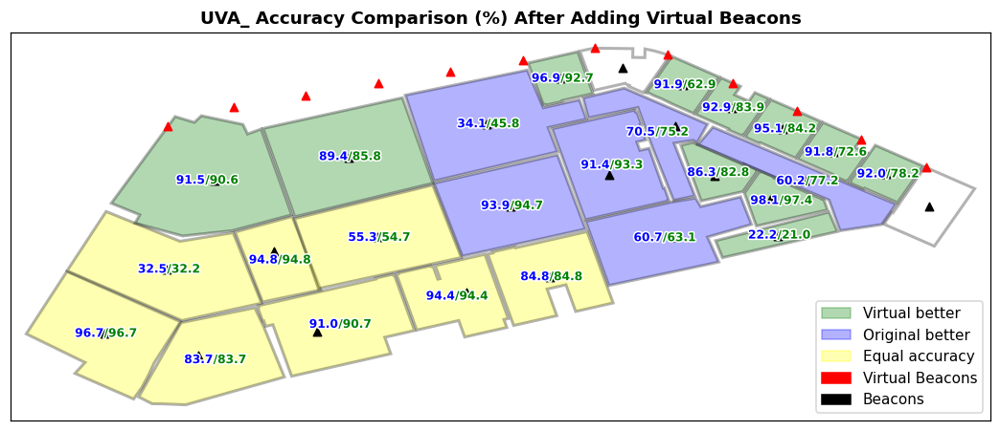

In [485]:
plot_building_all_zones_virtual_compare(df_rooms, results, results_df_monte,
                                          virtual_df=virtual_df)

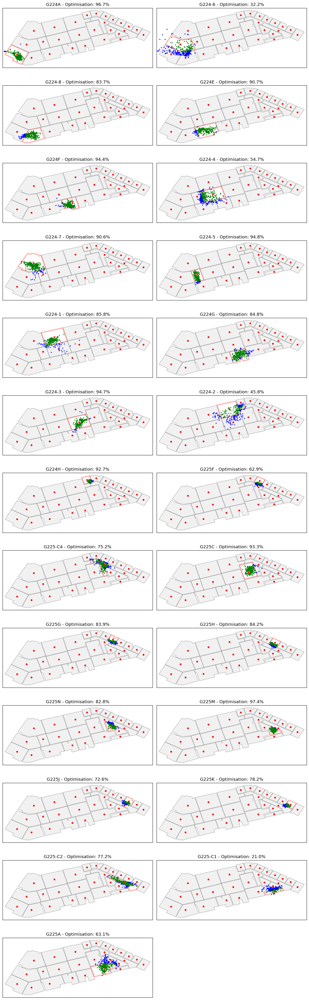

Overall Accuracy: 77.02%


,Room_name,Total_Points,Inside_Points,Accuracy
0,G224A,276,267,96.739130
1,G224-6,317,102,32.176656
2,G224-8,264,221,83.712121
3,G224E,289,262,90.657439
4,G224F,267,252,94.382022
5,G224-4,333,182,54.654655
6,G224-7,331,300,90.634441
7,G224-5,286,271,94.755245
8,G224-1,331,284,85.800604
9,G224G,269,228,84.758364


In [486]:
plot_building_with_zone_accuracy(df_rooms, results_df_monte, pred_col="Predicted_Optimisation")

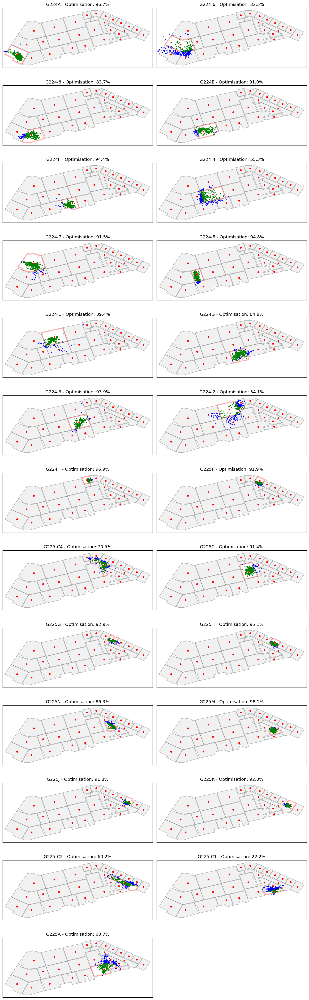

Overall Accuracy: 79.44%


,Room_name,Total_Points,Inside_Points,Accuracy
0,G224A,276,267,96.739130
1,G224-6,317,103,32.492114
2,G224-8,264,221,83.712121
3,G224E,289,263,91.003460
4,G224F,267,252,94.382022
5,G224-4,333,184,55.255255
6,G224-7,331,303,91.540785
7,G224-5,286,271,94.755245
8,G224-1,331,296,89.425982
9,G224G,269,228,84.758364


In [487]:
plot_building_with_zone_accuracy(df_rooms, results, pred_col="Predicted_Optimisation")

## Hybrid:
In this part we will try:

    - first run as normal for all real beacons
    
    - if the predciton is within a distnace from the perimeter then we create virtual beacon and rerun with both virtual and real ebacons

In [328]:
from shapely.geometry import Polygon, Point, LineString
from geopy.distance import geodesic, distance


def rssi_to_distance(rssi, A=-40, n=3.5, scale=0.8):
    return scale * np.exp((A - rssi) / (10 * n))

def rssi_from_distance(distance_m, A=-40, n=3.5, scale=0.8):
    distance_m = np.maximum(distance_m, 1e-6)
    return A - 10 * n * np.log(distance_m / scale)

def latlon_to_local_xy(lat, lon, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    y_offset = geodesic((origin_lat, origin_lon), (lat, origin_lon)).meters
    x_offset = geodesic((origin_lat, origin_lon), (origin_lat, lon)).meters
    if lat < origin_lat:
        y_offset *= -1
    if lon < origin_lon:
        x_offset *= -1
    return x_offset, y_offset

def local_xy_to_latlon(x_m, y_m, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    origin_point = (origin_lat, origin_lon)
    point_north = distance(meters=y_m).destination(origin_point, bearing=0)
    final_point = distance(meters=x_m).destination((point_north.latitude, point_north.longitude), bearing=90)
    return final_point.latitude, final_point.longitude

def trilateration(coords, distances):
    def fun(x, coords, distances):
        weights = 1 / (distances + 1e-5)
        return weights * (np.linalg.norm(coords - x, axis=1) - distances)
    x0 = np.mean(coords, axis=0)
    result = least_squares(fun, x0, args=(coords, distances))
    return result.x if result.success else x0

def generate_expansion_area(initial_guess, std_dev=0.5, radius=0.8, num_points=500, range_box=2):
    num_gauss = int(num_points * 0.4)
    num_box = int(num_points * 0.3)
    num_circle = num_points - num_gauss - num_box
    box_points = np.random.uniform(-range_box, range_box, size=(num_box, 2)) + initial_guess
    gauss_points = np.random.normal(0, std_dev, size=(num_gauss, 2)) + initial_guess
    r = radius * np.sqrt(np.random.uniform(0, 1, num_circle))
    theta = np.random.uniform(0, 2 * np.pi, num_circle)
    circ_points = np.column_stack((initial_guess[0] + r * np.cos(theta),
                                   initial_guess[1] + r * np.sin(theta)))
    return np.vstack((gauss_points, box_points, circ_points))

def localization_error(tag_position, beacons, distances):
    estimated_distances = np.linalg.norm(beacons - tag_position, axis=1)
    sigma = np.std(distances) + 1e-3
    weights = np.exp(- (distances ** 2) / (2 * sigma ** 2))
    return np.sum(weights * (estimated_distances - distances) ** 2)

# -----------------------------
# Utility: prepare building polygon in meters
# room_coords_array is assumed [[lon, lat], ...] 
# -----------------------------
def build_building_polygon_meters(room_coords_array, origin):
    building_coords = np.array(room_coords_array)
    # Convert each lon/lat to meters
    coords_m = np.array([latlon_to_local_xy(lat, lon, origin)
                         for lon, lat in building_coords])  
    
    from scipy.spatial import ConvexHull
    hull = ConvexHull(coords_m)
    perimeter_m = coords_m[hull.vertices]
    return Polygon(perimeter_m), perimeter_m

# -----------------------------
# Utility: generate K virtual beacons along the nearby wall (on the wall)
# -----------------------------
def make_virtuals_near_projection(building_poly_m, xy, n_virtual=3, span_m=6.0):
    """
    xy: (x,y) estimated pos in meters
    n_virtual: number of virtual beacons to place along wall around the nearest point
    span_m: total length along the perimeter to cover (meters), centered on the nearest point
    Returns: array shape (n,2) of wall points in meters
    """
    ext = building_poly_m.exterior
    proj_s = ext.project(Point(xy))             # curvilinear abscissa (meters along boundary)
    half = span_m/2.0

    s_values = np.linspace(proj_s - half, proj_s + half, n_virtual)
    # Wrap distances into [0, ext.length]
    L = ext.length
    s_values = np.mod(s_values, L)

    pts = []
    for s in s_values:
        p = ext.interpolate(s)
        pts.append([p.x, p.y])
    return np.array(pts)

# -----------------------------
# Core localizer for ONE row and a given beacon set
# (kept as close as possible to your logic)
# -----------------------------
def _run_localization_for_row(
    row,
    beacon_keys,
    beacon_coords,       # array Nx2 (meters) matching beacon_keys
    origin,
    num_particles=500,
    min_beacons=4,
    max_beacons=20,
    rssi_threshold=-90,
    circle_radius=1.5,
    refinement_rssi_threshold=-75,
    std_dev=1.0,
    resample_iterations=5,
    local_perturb=0.5,
    virtual_rssi_map=None # dict {mac: rssi} for virtual; None for real-only
):
    # 1) Build RSSI vector for this row
    rssis = []
    for i, mac in enumerate(beacon_keys):
        if virtual_rssi_map and mac in virtual_rssi_map:
            rssis.append(virtual_rssi_map[mac])
        else:
            rssis.append(row.get(mac, np.nan))
    rssis = np.array(rssis, dtype=float)

    # 2) Filter by threshold and NaN
    mask = (rssis > rssi_threshold) & ~np.isnan(rssis)
    if np.sum(mask) < min_beacons:
        return None  # insufficient signals

    filtered_rssis = rssis[mask]
    filtered_coords = beacon_coords[mask]
    sorted_indices = np.argsort(-filtered_rssis)
    top_beacons_max = min(len(filtered_rssis), max_beacons)

    # 3) Initial guess
    est_dists = rssi_to_distance(filtered_rssis)
    close_idx = np.where(est_dists <= circle_radius)[0]
    if len(close_idx) > 0:
        initial_guess = filtered_coords[close_idx[np.argmin(est_dists[close_idx])]]
    else:
        top_idx = sorted_indices[:min(5, len(sorted_indices))]
        try:
            initial_guess = trilateration(filtered_coords[top_idx], est_dists[top_idx])
        except:
            weights = np.clip(filtered_rssis[top_idx] - np.min(filtered_rssis[top_idx]), 1, None)
            initial_guess = np.average(filtered_coords[top_idx], axis=0, weights=weights)

    # 4) Particle iterations (sweep beacons count like your code)
    best_final_pos = None
    for num_beacons in range(min_beacons, top_beacons_max + 1):
        idxs = sorted_indices[:num_beacons]
        rssi_subset = filtered_rssis[idxs]
        coords_subset = filtered_coords[idxs]

        particles = generate_expansion_area(initial_guess, num_points=num_particles,
                                            range_box=4, radius=circle_radius, std_dev=std_dev)
        for _ in range(resample_iterations):
            dists = np.linalg.norm(particles[:, None, :] - coords_subset[None, :, :], axis=2)
            rssi_pred = rssi_from_distance(dists)
            diffs = rssi_subset[None, :] - rssi_pred
            sigma_dynamic = 3
            w = np.exp(-(diffs ** 2).sum(axis=1) / (2 * sigma_dynamic ** 2))
            w = np.clip(w, 1e-8, None)
            w /= w.sum()
            resample_idx = np.random.choice(len(particles), size=num_particles, p=w)
            particles = particles[resample_idx]

            # local perturbation
            top_k = min(max(50, num_particles // 10), len(particles))
            top_idx = np.random.choice(len(particles), size=top_k, replace=False)
            perturbed = particles[top_idx] + np.random.normal(0, local_perturb, size=particles[top_idx].shape)
            particles = np.vstack((particles, perturbed))

        final_pos = np.mean(particles, axis=0)
        # refinement (use strong signals)
        strong_mask = rssi_subset > refinement_rssi_threshold
        if np.sum(strong_mask) >= 3:
            try:
                result = minimize(localization_error, final_pos,
                                  args=(coords_subset[strong_mask], rssi_to_distance(rssi_subset[strong_mask])),
                                  method='L-BFGS-B',
                                  options={'maxiter': 100, 'gtol': 1e-8, 'disp': False})
                if result.success:
                    final_pos = result.x
            except:
                pass
        best_final_pos = final_pos  # keep latest (you were overwriting in the loop too)

    # 5) Convert to lat/lon for outputs
    final_lat, final_lon = local_xy_to_latlon(best_final_pos[0], best_final_pos[1], origin)
    init_lat, init_lon = local_xy_to_latlon(initial_guess[0], initial_guess[1], origin)

    out = {
        "final_pos_xy": best_final_pos,
        "initial_xy": initial_guess,
        "Predicted_Optimisation": [final_lat, final_lon],
        "Initial_Guess": [init_lat, init_lon],
    }
    return out

# -----------------------------
# Two-pass conditional virtual beacons
# -----------------------------
def static_hybrid_monte_carlo_two_pass(
    data_df,
    beacon_df,
    room_coords_array,
    num_particles=500,
    min_beacons=4,
    max_beacons=20,
    rssi_threshold=-90,
    circle_radius=1.5,
    refinement_rssi_threshold=-75,
    std_dev=1.0,
    resample_iterations=5,
    local_perturb=0.5,
    # virtual controls
    perimeter_threshold_m=5.0,   # if first-pass estimate within this distance to wall → add virtuals
    n_virtual_on_wall=10,
    virtual_span_m=15,
    virtual_rssi=-50
):
    results = []
    has_timestamp = ('timestamp' in data_df.columns)

    # --- origin from building coords (keep your convention) ---
    building_coords = np.array(room_coords_array)  # assumed [[lon,lat],...]
    origin = [building_coords[:,0].min(), building_coords[:,1].min()]

    # --- building polygon in meters ---
    building_poly_m, building_perimeter_m = build_building_polygon_meters(room_coords_array, origin)

    # --- real beacons → meters ---
    beacon_df = beacon_df.copy()
    beacon_df['x'] = pd.to_numeric(beacon_df['x'], errors='coerce')
    beacon_df['y'] = pd.to_numeric(beacon_df['y'], errors='coerce')
    beacon_df = beacon_df.dropna(subset=['x','y'])

    real_beacon_positions = {}
    for _, r in beacon_df.iterrows():
        x_m, y_m = latlon_to_local_xy(r['y'], r['x'], origin)  # y=lat, x=lon
        real_beacon_positions[r['Mac']] = {'x': x_m, 'y': y_m}

    real_keys = list(real_beacon_positions.keys())
    real_coords = np.array([list(real_beacon_positions[k].values()) for k in real_keys])

    # --- iterate rows ---
    for idx in tqdm(range(len(data_df))):
        row = data_df.iloc[idx]
        zone = row.get("Zone_id", None)
        room = row.get("Room_name", None)
        tagId = row.get("tagId", None)
        timestamp = row.get("timestamp", None) if has_timestamp else None

        # PASS 1: real only
        first = _run_localization_for_row(
            row, real_keys, real_coords, origin,
            num_particles, min_beacons, max_beacons,
            rssi_threshold, circle_radius,
            refinement_rssi_threshold, std_dev,
            resample_iterations, local_perturb,
            virtual_rssi_map=None
        )
        if first is None:
            # not enough beacons; skip
            continue

        first_xy = first["final_pos_xy"]
        # distance to wall
        dist_to_wall = building_poly_m.exterior.distance(Point(first_xy[0], first_xy[1]))

        second_used = False
        final_xy = first_xy
        final_lat, final_lon = first["Predicted_Optimisation"]
        initial_lat, initial_lon = first["Initial_Guess"]

        # If near wall, add virtuals ON THAT WALL and re-run
        if dist_to_wall <= perimeter_threshold_m:
            virtual_xy = make_virtuals_near_projection(
                building_poly_m, first_xy, n_virtual=n_virtual_on_wall, span_m=virtual_span_m
            )
            # Build augmented beacon set (real + virtual)
            aug_positions = dict(real_beacon_positions)
            virtual_keys = []
            for i, (vx, vy) in enumerate(virtual_xy):
                mac = f"VIRTUAL_{i}"
                aug_positions[mac] = {'x': vx, 'y': vy}
                virtual_keys.append(mac)

            aug_keys = list(aug_positions.keys())
            aug_coords = np.array([list(aug_positions[k].values()) for k in aug_keys])
            virtual_rssi_map = {k: virtual_rssi for k in virtual_keys}

            second = _run_localization_for_row(
                row, aug_keys, aug_coords, origin,
                num_particles, min_beacons, max_beacons,
                rssi_threshold, circle_radius,
                refinement_rssi_threshold, std_dev,
                resample_iterations, local_perturb,
                virtual_rssi_map=virtual_rssi_map
            )
            if second is not None:
                second_used = True
                final_xy = second["final_pos_xy"]
                final_lat, final_lon = second["Predicted_Optimisation"]
                initial_lat, initial_lon = second["Initial_Guess"]

        # package result
        res = {
            "Zone_id": zone,
            "Room_name": room,
            "Tag_id": tagId,
            "Predicted_Optimisation": [final_lat, final_lon],
            "Initial_Guess": [initial_lat, initial_lon],
            "Used_Virtuals": second_used,
            "Dist_To_Wall_FirstPass_m": float(dist_to_wall),
        }
        if has_timestamp:
            res["timestamp"] = timestamp
        results.append(res)

    return pd.DataFrame(results)


In [329]:
result= static_hybrid_monte_carlo_two_pass(
    data_set_df,
    beacon_df,
    room_coords_array)

100%|███████████████████████████████████████| 7025/7025 [03:52<00:00, 30.26it/s]


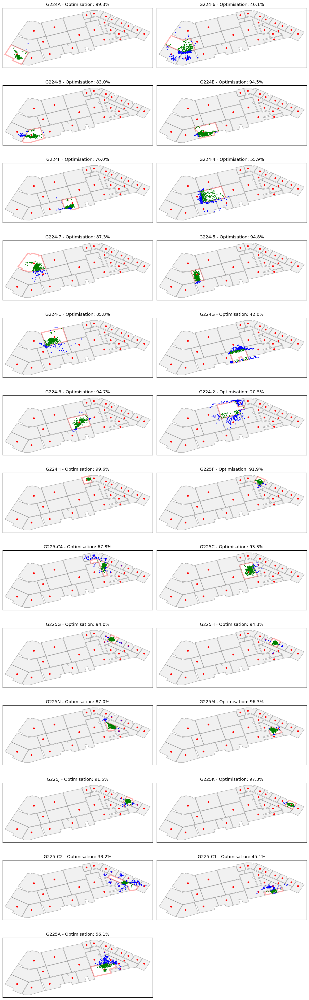

Overall Accuracy: 76.90%


,Room_name,Total_Points,Inside_Points,Accuracy
0,G224A,276,274,99.275362
1,G224-6,317,127,40.063091
2,G224-8,264,219,82.954545
3,G224E,289,273,94.463668
4,G224F,267,203,76.029963
5,G224-4,333,186,55.855856
6,G224-7,331,289,87.311178
7,G224-5,286,271,94.755245
8,G224-1,331,284,85.800604
9,G224G,269,113,42.007435


In [330]:
plot_building_with_zone_accuracy(df_rooms, result, pred_col="Predicted_Optimisation")

In [331]:
res = result[result.Used_Virtuals==True]

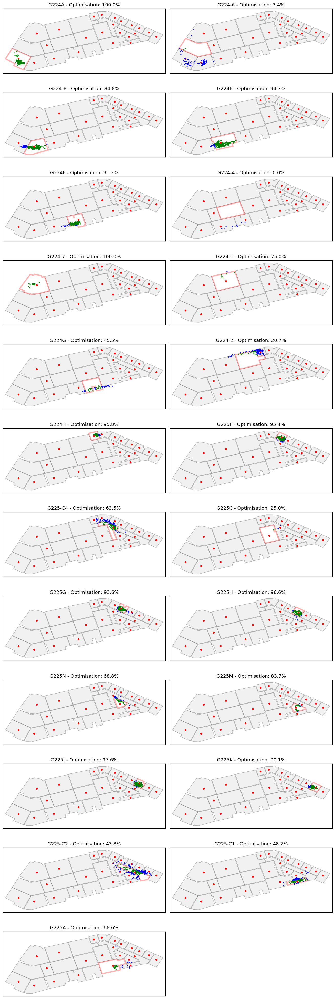

Overall Accuracy: 80.52%


,Room_name,Total_Points,Inside_Points,Accuracy
0,G224A,269,269,100.000000
1,G224-6,87,3,3.448276
2,G224-8,250,212,84.800000
3,G224E,282,267,94.680851
4,G224F,260,237,91.153846
5,G224-4,9,0,0.000000
6,G224-7,43,43,100.000000
7,G224-1,8,6,75.000000
8,G224G,55,25,45.454545
9,G224-2,121,25,20.661157


In [327]:
plot_building_with_zone_accuracy(df_rooms, res, pred_col="Predicted_Optimisation")

### New

In [133]:
import numpy as np
import pandas as pd
from tqdm import tqdm
from scipy.optimize import minimize, least_squares
from geopy.distance import geodesic, distance

# -----------------------------
# RSSI ↔ distance
# -----------------------------
def rssi_to_distance(rssi, A=-40, n=3.5, scale=0.8):
    return scale * np.exp((A - rssi) / (10 * n))

def rssi_from_distance(distance, A=-40, n=3.5, scale=0.8):
    distance = np.maximum(distance, 1e-6)
    return A - 10 * n * np.log(distance / scale)

# -----------------------------
# Coordinate conversion
# -----------------------------
def latlon_to_local_xy(lat, lon, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    y_offset = geodesic((origin_lat, origin_lon), (lat, origin_lon)).meters
    x_offset = geodesic((origin_lat, origin_lon), (origin_lat, lon)).meters
    if lat < origin_lat:
        y_offset *= -1
    if lon < origin_lon:
        x_offset *= -1
    return x_offset, y_offset

def local_xy_to_latlon(x_m, y_m, origin):
    origin_lat, origin_lon = origin[1], origin[0]
    origin_point = (origin_lat, origin_lon)
    point_north = distance(meters=y_m).destination(origin_point, bearing=0)
    final_point = distance(meters=x_m).destination((point_north.latitude, point_north.longitude), bearing=90)
    return final_point.latitude, final_point.longitude

# -----------------------------
# Trilateration & error
# -----------------------------
def trilateration(coords, distances):
    def fun(x, coords, distances):
        weights = 1 / (distances + 1e-5)
        return weights * (np.linalg.norm(coords - x, axis=1) - distances)
    x0 = np.mean(coords, axis=0)
    result = least_squares(fun, x0, args=(coords, distances))
    return result.x if result.success else x0

def localization_error(tag_position, beacons, distances):
    estimated_distances = np.linalg.norm(beacons - tag_position, axis=1)
    sigma = np.std(distances) + 1e-3
    weights = np.exp(- (distances ** 2) / (2 * sigma ** 2))
    return np.sum(weights * (estimated_distances - distances) ** 2)

# -----------------------------
# Particle generation
# -----------------------------
def generate_expansion_area(initial_guess, std_dev=0.5, radius=0.8, num_points=500, range_box=2):
    num_gauss = int(num_points * 0.4)
    num_box = int(num_points * 0.3)
    num_circle = num_points - num_gauss - num_box
    box_points = np.random.uniform(-range_box, range_box, size=(num_box, 2)) + initial_guess
    gauss_points = np.random.normal(0, std_dev, size=(num_gauss, 2)) + initial_guess
    r = radius * np.sqrt(np.random.uniform(0, 1, num_circle))
    theta = np.random.uniform(0, 2 * np.pi, num_circle)
    circ_points = np.column_stack((initial_guess[0] + r * np.cos(theta),
                                   initial_guess[1] + r * np.sin(theta)))
    return np.vstack((gauss_points, box_points, circ_points))

# -----------------------------
# Cluster penalty
# -----------------------------
def cluster_penalty(beacon_coords):
    """Penalize clusters by distance variance (small std = clustered)"""
    if len(beacon_coords) < 2:
        return np.ones(len(beacon_coords))
    dists = np.linalg.norm(beacon_coords[:, None, :] - beacon_coords[None, :, :], axis=2)
    cluster_factor = np.mean(dists, axis=1)
    cluster_factor = cluster_factor / (np.max(cluster_factor) + 1e-6)
    return cluster_factor

# -----------------------------
# Optimal beacon selection
# -----------------------------
def optimal_beacon_selection(rssi_values, beacon_coords, max_beacons=8):
    selected_idx = []
    remaining_idx = list(range(len(rssi_values)))
    if not remaining_idx:
        return []
    strongest_idx = np.argmax(rssi_values)
    selected_idx.append(strongest_idx)
    remaining_idx.remove(strongest_idx)
    while len(selected_idx) < max_beacons and remaining_idx:
        best_idx = None
        best_score = -np.inf
        for idx in remaining_idx:
            candidate = selected_idx + [idx]
            coords_subset = beacon_coords[candidate]
            gdop = np.std(np.linalg.norm(coords_subset - np.mean(coords_subset, axis=0), axis=1))
            score = rssi_values[idx] / (gdop + 1e-6)
            if score > best_score:
                best_score = score
                best_idx = idx
        if best_idx is None:
            break
        selected_idx.append(best_idx)
        remaining_idx.remove(best_idx)
    return selected_idx

# -----------------------------
# Main hybrid Monte Carlo
# -----------------------------
def static_hybrid_monte_carlo_with_geo_enhanced(
    data_df,
    beacon_df,
    room_coords_array,
    min_beacons=4,
    max_beacons=20,
    num_particles=500,
    sigma_noise=4,
    range_box=4,
    rssi_threshold=-90,
    circle_radius=1.5,
    refinement_rssi_threshold=-75,
    std_dev=1.0,
    resample_iterations=5,
    local_perturb=0.5
):
    results = []
    has_timestamp = 'timestamp' in data_df.columns

    # Origin
    building_coords = np.array(room_coords_array)
    origin = [building_coords[:,0].min(), building_coords[:,1].min()]

    # Convert beacon coords
    beacon_df['x'] = pd.to_numeric(beacon_df['x'], errors='coerce')
    beacon_df['y'] = pd.to_numeric(beacon_df['y'], errors='coerce')
    beacon_df = beacon_df.dropna(subset=['x','y'])

    beacon_positions = {}
    for _, row in beacon_df.iterrows():
        x_m, y_m = latlon_to_local_xy(row['y'], row['x'], origin)
        beacon_positions[row['Mac']] = {'x': x_m, 'y': y_m}

    beacon_keys = list(beacon_positions.keys())
    beacon_coords = np.array([list(beacon_positions[b].values()) for b in beacon_keys])

    for idx in tqdm(range(len(data_df))):
        row = data_df.iloc[idx]
        zone = row.get("Zone_id", None)
        room = row.get("Room_name", None)
        tagId = row.get("tagId", None)
        timestamp = row.get("timestamp", None) if has_timestamp else None

        rssis = np.array([row.get(mac, np.nan) for mac in beacon_keys], dtype=float)
        mask = (rssis > rssi_threshold) & ~np.isnan(rssis)
        if np.sum(mask) < min_beacons:
            continue

        filtered_rssis = rssis[mask]
        filtered_coords = beacon_coords[mask]

        # Sort strongest
        sorted_indices = np.argsort(-filtered_rssis)
        top_beacons_max = min(len(filtered_rssis), max_beacons)

        # Initial guess
        est_dists = rssi_to_distance(filtered_rssis)
        close_idx = np.where(est_dists <= circle_radius)[0]
        if len(close_idx) > 0:
            initial_guess = filtered_coords[close_idx[np.argmin(est_dists[close_idx])]]
        else:
            top_init_n = min(5, len(sorted_indices))
            top_idx = sorted_indices[:top_init_n]
            top_coords = filtered_coords[top_idx]
            top_rssi = filtered_rssis[top_idx]
            top_dists = rssi_to_distance(top_rssi)
            try:
                initial_guess = trilateration(top_coords, top_dists)
            except:
                weights = np.clip(top_rssi - np.min(top_rssi), 1, None)
                initial_guess = np.average(top_coords, axis=0, weights=weights)

        best_result = None

        # Particle filter iterations
        for num_beacons in range(min_beacons, top_beacons_max+1):
            indices = sorted_indices[:num_beacons]
            rssi_subset = filtered_rssis[indices]
            coords_subset = filtered_coords[indices]

            # Optimal beacon selection to avoid clusters
            selected_idx = optimal_beacon_selection(rssi_subset, coords_subset, max_beacons=num_beacons)
            if not selected_idx:
                continue
            rssi_subset = rssi_subset[selected_idx]
            coords_subset = coords_subset[selected_idx]

            particles = generate_expansion_area(initial_guess, num_points=num_particles,
                                                range_box=range_box, radius=circle_radius, std_dev=std_dev)

            for _ in range(resample_iterations):
                dists = np.linalg.norm(particles[:, None, :] - coords_subset[None, :, :], axis=2)
                rssi_pred = rssi_from_distance(dists)
                diffs = rssi_subset[None, :] - rssi_pred

                # Cluster penalty
                cluster_w = cluster_penalty(coords_subset)
                diffs = diffs * cluster_w  # broadcast along beacon axis

                sigma_dynamic = 3
                weights = np.exp(-(diffs ** 2).sum(axis=1) / (2*sigma_dynamic**2))
                weights = np.clip(weights, 1e-8, None)
                weights /= weights.sum()

                try:
                    resample_idx = np.random.choice(len(particles), size=len(particles), p=weights)
                except ValueError:
                    resample_idx = np.arange(len(particles))
                particles = particles[resample_idx]

                top_k = min(max(50, len(particles)//10), len(particles))
                top_idx = np.random.choice(len(particles), size=top_k, replace=False)
                perturbed = particles[top_idx] + np.random.normal(0, local_perturb, size=(top_k,2))
                particles = np.vstack((particles, perturbed))

            final_pos = np.mean(particles, axis=0)
            pre_refined_pos = final_pos.copy()

            # Refinement
            strong_mask = rssi_subset > refinement_rssi_threshold
            if np.sum(strong_mask) >= 3:
                strong_coords = coords_subset[strong_mask]
                strong_rssi = rssi_subset[strong_mask]
                strong_dists = rssi_to_distance(strong_rssi)
                result = minimize(localization_error, final_pos, args=(strong_coords, strong_dists),
                                  method='L-BFGS-B', options={'maxiter':100,'gtol':1e-8,'disp':False})
                if result.success:
                    final_pos = result.x

            pre_lat, pre_lon = local_xy_to_latlon(pre_refined_pos[0], pre_refined_pos[1], origin)
            final_lat, final_lon = local_xy_to_latlon(final_pos[0], final_pos[1], origin)
            init_lat, init_lon = local_xy_to_latlon(initial_guess[0], initial_guess[1], origin)

            best_result = {
                "Zone_id": zone,
                "Room_name": room,
                "Tag_id": tagId,
                "Predicted_Before_Refinement": [pre_lat, pre_lon],
                "Predicted_Optimisation": [final_lat, final_lon],
                "Initial_Guess": [init_lat, init_lon],
                "Refinement_Shift": np.linalg.norm(final_pos - pre_refined_pos),
                "Distance_From_Initial": np.linalg.norm(final_pos - initial_guess),
                "Beacons_Used": len(selected_idx),
            }
            if has_timestamp:
                best_result["timestamp"] = timestamp

        if best_result:
            results.append(best_result)

    return pd.DataFrame(results)


In [134]:
results_enhanced= static_hybrid_monte_carlo_with_geo_enhanced(
    data_set_df,
    beacon_df,
    room_coords_array)

100%|███████████████████████████████████████| 7025/7025 [03:39<00:00, 32.03it/s]


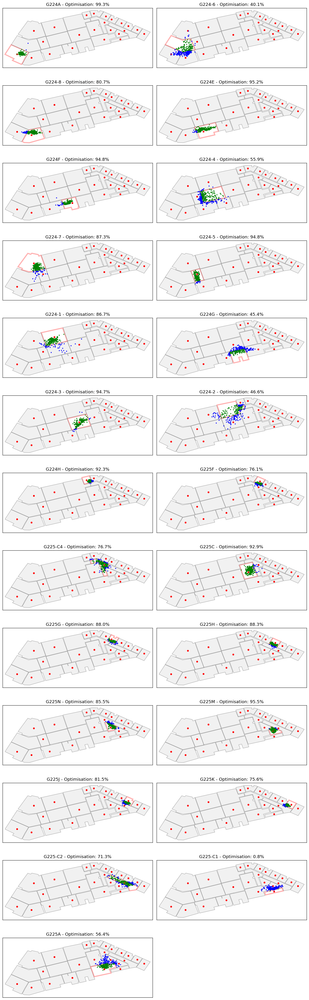

Overall Accuracy: 75.93%


In [135]:
res1= plot_building_with_zone_accuracy(df_rooms, results_enhanced, pred_col="Predicted_Optimisation")

In [136]:
def static_hybrid_monte_carlo_with_geo_sparse_fallback(
    data_df,
    beacon_df,
    room_coords_array,
    min_beacons=4,
    max_beacons=20,
    num_particles=500,
    sigma_noise=4,
    range_box=4,
    rssi_threshold=-90,
    circle_radius=1.5,
    refinement_rssi_threshold=-75,
    std_dev=1.0,
    resample_iterations=5,
    local_perturb=0.5,
    min_beacons_sparse=6  # threshold for sparse fallback
):
    results = []
    has_timestamp = 'timestamp' in data_df.columns

    # -----------------------------
    # Origin from building coords
    # -----------------------------
    building_coords = np.array(room_coords_array)
    origin = [building_coords[:,0].min(), building_coords[:,1].min()]

    # -----------------------------
    # Convert beacons into local coords
    # -----------------------------
    beacon_df['x'] = pd.to_numeric(beacon_df['x'], errors='coerce')
    beacon_df['y'] = pd.to_numeric(beacon_df['y'], errors='coerce')
    beacon_df = beacon_df.dropna(subset=['x', 'y'])

    beacon_positions = {}
    for _, row in beacon_df.iterrows():
        x_m, y_m = latlon_to_local_xy(row['y'], row['x'], origin)  # y=lat, x=lon
        beacon_positions[row['Mac']] = {'x': x_m, 'y': y_m}

    beacon_keys = list(beacon_positions.keys())
    beacon_coords = np.array([list(beacon_positions[b].values()) for b in beacon_keys])

    # -----------------------------
    # Loop over tag readings
    # -----------------------------
    for idx in tqdm(range(len(data_df))):
        row = data_df.iloc[idx]
        zone = row.get("Zone_id", None)
        room = row.get("Room_name", None)
        tagId = row.get("tagId", None)
        timestamp = row.get("timestamp", None) if has_timestamp else None

        rssis = np.array([row.get(mac, np.nan) for mac in beacon_keys], dtype=float)
        mask = (rssis > rssi_threshold) & ~np.isnan(rssis)
        if np.sum(mask) < min_beacons:
            continue

        filtered_rssis = rssis[mask]
        filtered_coords = beacon_coords[mask]

        sorted_indices = np.argsort(-filtered_rssis)
        top_beacons_max = min(len(filtered_rssis), max_beacons)

        # -----------------------------
        # Initial guess
        # -----------------------------
        est_dists = rssi_to_distance(filtered_rssis)
        close_idx = np.where(est_dists <= circle_radius)[0]

        if len(close_idx) > 0:
            close_coords = filtered_coords[close_idx]
            close_dists = est_dists[close_idx]
            initial_guess = close_coords[np.argmin(close_dists)]
        else:
            # Sparse/fallback logic
            if len(filtered_rssis) <= min_beacons_sparse:
                # Use strongest beacon as initial guess
                strongest_idx = np.argmax(filtered_rssis)
                initial_guess = filtered_coords[strongest_idx]
            else:
                top_init_n = min(5, len(sorted_indices))
                top_idx = sorted_indices[:top_init_n]
                top_coords = filtered_coords[top_idx]
                top_rssi = filtered_rssis[top_idx]
                top_dists = rssi_to_distance(top_rssi)
                try:
                    initial_guess = trilateration(top_coords, top_dists)
                except:
                    weights = np.clip(top_rssi - np.min(top_rssi), 1, None)
                    initial_guess = np.average(top_coords, axis=0, weights=weights)

        best_result = None

        # -----------------------------
        # Particle filter iterations
        # -----------------------------
        for num_beacons in range(min_beacons, top_beacons_max + 1):
            indices = sorted_indices[:num_beacons]
            rssi_subset = filtered_rssis[indices]
            coords_subset = filtered_coords[indices]

            particles = generate_expansion_area(initial_guess, num_points=num_particles,
                                                range_box=range_box, radius=circle_radius, std_dev=std_dev)

            for _ in range(resample_iterations):
                dists = np.linalg.norm(particles[:, None, :] - coords_subset[None, :, :], axis=2)
                rssi_pred = rssi_from_distance(dists)
                diffs = rssi_subset[None, :] - rssi_pred

                sigma_dynamic = 3
                weights = np.exp(-(diffs ** 2).sum(axis=1) / (2 * sigma_dynamic ** 2))
                weights = np.clip(weights, 1e-8, None)
                weights /= weights.sum()

                resample_idx = np.random.choice(len(particles), size=num_particles, p=weights)
                particles = particles[resample_idx]

                top_k = min(max(50, num_particles // 10), len(particles))
                top_idx = np.random.choice(len(particles), size=top_k, replace=False)
                perturbed = particles[top_idx] + np.random.normal(0, local_perturb, size=particles[top_idx].shape)
                particles = np.vstack((particles, perturbed))

            final_pos = np.mean(particles, axis=0)
            pre_refined_pos = final_pos.copy()

            # -----------------------------
            # Refinement
            # -----------------------------
            strong_mask = rssi_subset > refinement_rssi_threshold
            if np.sum(strong_mask) >= 3:
                strong_coords = coords_subset[strong_mask]
                strong_rssi = rssi_subset[strong_mask]
                strong_dists = rssi_to_distance(strong_rssi)

                result = minimize(localization_error, final_pos,
                                  args=(strong_coords, strong_dists),
                                  method='L-BFGS-B',
                                  options={'maxiter': 100, 'gtol': 1e-8, 'disp': False})
                if result.success:
                    final_pos = result.x

            # Convert to lat/lon
            pre_lat, pre_lon = local_xy_to_latlon(pre_refined_pos[0], pre_refined_pos[1], origin)
            final_lat, final_lon = local_xy_to_latlon(final_pos[0], final_pos[1], origin)
            init_lat, init_lon = local_xy_to_latlon(initial_guess[0], initial_guess[1], origin)

            best_result = {
                "Zone_id": zone,
                "Room_name": room,
                "Tag_id": tagId,
                "Predicted_Before_Refinement": [pre_lat, pre_lon],
                "Predicted_Optimisation": [final_lat, final_lon],
                "Initial_Guess": [init_lat, init_lon],
                "Refinement_Shift": np.linalg.norm(final_pos - pre_refined_pos),
                "Distance_From_Initial": np.linalg.norm(final_pos - initial_guess),
                "Beacons_Used": num_beacons,
            }
            if has_timestamp:
                best_result["timestamp"] = timestamp

        if best_result:
            results.append(best_result)

    return pd.DataFrame(results)


In [137]:
results_enhanced= static_hybrid_monte_carlo_with_geo_sparse_fallback(
    data_set_df,
    beacon_df,
    room_coords_array)

100%|███████████████████████████████████████| 7025/7025 [02:32<00:00, 45.98it/s]


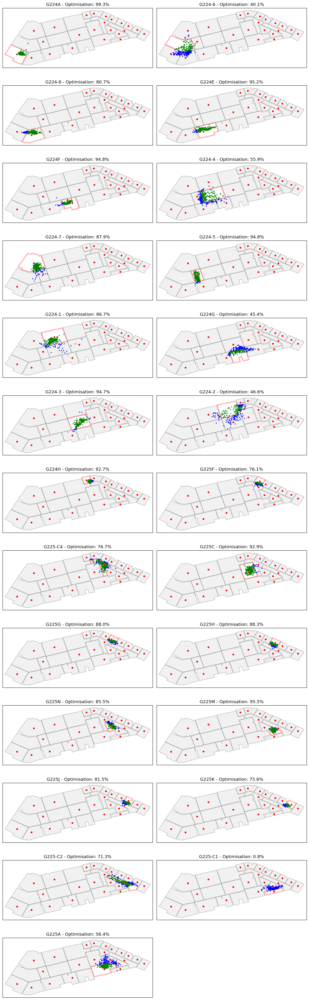

Overall Accuracy: 75.97%


In [139]:
res1= plot_building_with_zone_accuracy(df_rooms, results_enhanced, pred_col="Predicted_Optimisation")

In [148]:
results_enhanced= static_hybrid_monte_carlo_with_geo(
    data_set_df,
    beacon_df,
    room_coords_array)

100%|███████████████████████████████████████| 7025/7025 [03:34<00:00, 32.69it/s]


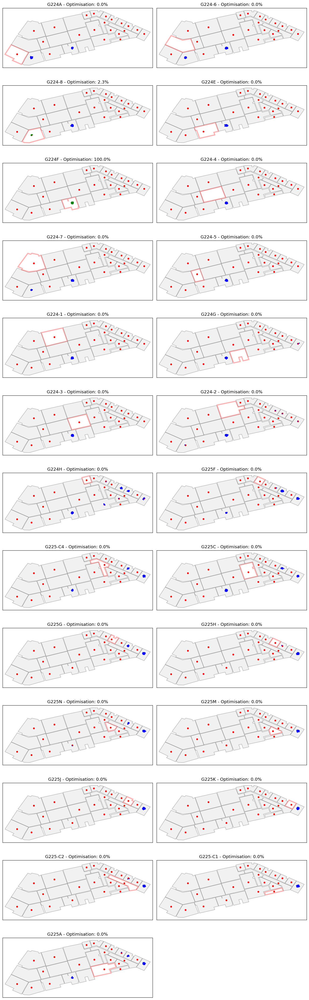

Overall Accuracy: 3.89%


In [149]:
res1= plot_building_with_zone_accuracy(df_rooms, results_enhanced, pred_col="Predicted_Optimisation")

In [ ]:
results_df_monte["timestamp"] = pd.to_datetime(results_df_monte["timestamp"])

# Sort by Zone_id first, then by timestamp
df_sorted = results_df_monte.sort_values(by=["Zone_id", "timestamp"], ascending=[True, True])

# Reset index if you want a clean dataframe
df_sorted = df_sorted.reset_index(drop=True)

## 3 dp: sliding window of 3 using mean have the hghest accuracy

try different like kalman, particle, mean median, max, weight... but only mean and particle is the best with accuracy 84.9%

In [ ]:
def fuse_three_packets(data_df, method="max"):
    """
    Fuse 3 consecutive packets into one by grouping per Zone + Tag + sliding window of 3.
    RSSI fusion can be 'max', 'median', or 'mean'.
    """
    fused_rows = []

    # Group by zone + tag
    for (zone, tag), group in data_df.groupby(["Zone_id", "tagId"]):
        group = group.sort_values("timestamp")

        # Slide window of size 2
        for i in range(len(group) - 4):
            window = group.iloc[i:i+5]

            fused_row = window.iloc[0].copy()  # copy metadata
            for col in data_df.columns:
                if col not in ['timestamp', 'tagId', 'parent_zone_id', 'Zone_id', 'Room_name']:
                    values = window[col].values
                    valid = values[values > -100]  # ignore missing RSSIs
                    
                    if len(valid) == 0:
                        fused_row[col] = -100
                    else:
                        if method == "max":
                            fused_row[col] = valid.max()
                        elif method == "median":
                            fused_row[col] = np.median(valid)
                        elif method == "mean":
                            fused_row[col] = valid.mean()
                        else:
                            raise ValueError("method must be 'max', 'median', or 'mean'")

            # timestamp → middle one
            fused_row["timestamp"] = window.iloc[1]["timestamp"]
            fused_rows.append(fused_row)

    return pd.DataFrame(fused_rows)

In [ ]:
# Try max fusion
fused_df = fuse_three_packets(data_set_df, method="mean")

# median fusion 
# fused_df = fuse_three_packets(data_set_df, method="median")

results_opt = run_localization_with_geo(
    data_set_df=fused_df,
    anchor_point_df=beacon_df,
    room_coords_array=room_coords_array
)
results_opt.to_csv("Result_Final/Optimisation_Fast_3dp_mean.csv", index= False)

100%|███████████████████████████████████████| 6625/6625 [38:13<00:00,  2.89it/s]


### Using particle in single data

In [ ]:
# Try max fusion (robust to fading)
fused_df = fuse_three_packets(data_set_df, method="mean")

# Or try median fusion (robust to spikes)
# fused_df = fuse_three_packets(data_set_df, method="median")

results = static_hybrid_monte_carlo_with_geo(
    data_df=fused_df,
    beacon_df=beacon_df,
    room_coords_array=room_coords_array,
    num_particles=5000
)


100%|███████████████████████████████████████| 6225/6225 [12:16<00:00,  8.45it/s]


In [ ]:
results.to_csv("Result_Final/Optimisation_Monte_5dp_mean.csv", index= False)

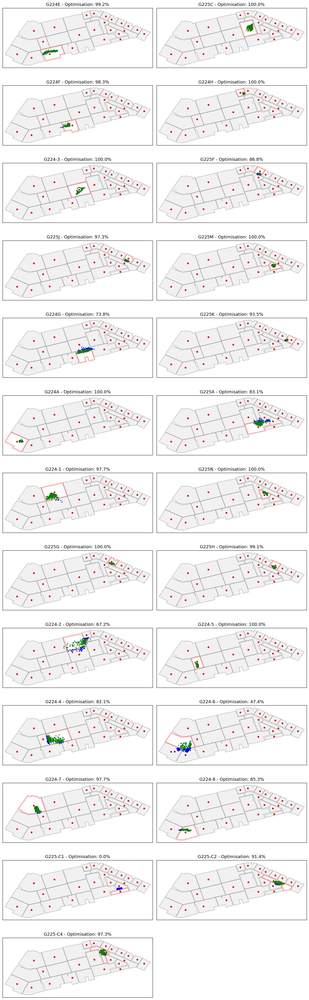

Overall Accuracy: 87.94%


In [ ]:
res= plot_building_with_zone_accuracy(df_rooms, results, pred_col="Predicted_Optimisation")

In [ ]:
res_3= res.merge(zones[["Room_name", "Room_Type"]], on ="Room_name", how="left")

zone_no_beacon= ['G224-2', 'G224-4', 'G224-6', 'G224G']
res_3['Has_Beacon'] = res_3['Room_name'].apply(lambda x: "No" if x in zone_no_beacon else "Yes")

res_3.groupby(["Room_Type", 'Has_Beacon']).Accuracy.mean()

Room_Type  Has_Beacon
Open       No            55.176190
           Yes           81.368576
Room       No            54.022989
           Yes           90.889219
Name: Accuracy, dtype: float64

### Res particle has the same accuracy as mean

In [ ]:

#   PARTICLE FUSION (with weighted RSSI + time decay)
# ==================================================
def particle_fusion_weighted(data_df, beacon_df, room_coords_array,
                             window_size=3, num_particles=3000,
                             rssi_method="weighted", time_decay=False, **kwargs):
    fused_results = []

    has_timestamp = 'timestamp' in data_df.columns
    has_room_name = 'Room_name' in data_df.columns
    has_zone_id = 'Zone_id' in data_df.columns

    # Group by tag + zone
    for (zone, tag), group in data_df.groupby(["Zone_id", "tagId"]):
        group = group.sort_values("timestamp").reset_index(drop=True)

        for i in range(len(group) - window_size + 1):
            window = group.iloc[i:i+window_size]

            # Fuse RSSI for this window
            fused_row = window.iloc[1].copy()  # middle packet metadata
            for col in data_df.columns:
                if col not in ['timestamp', 'tagId', 'Zone_id', 'Room_name']:
                    values = pd.to_numeric(window[col], errors="coerce").values
                    valid_mask = values > -100
                    valid = values[valid_mask]

                    if len(valid) == 0:
                        fused_row[col] = -100
                        continue

                    if rssi_method == "max":
                        fused_row[col] = valid.max()
                    elif rssi_method == "median":
                        fused_row[col] = np.median(valid)
                    elif rssi_method == "mean":
                        fused_row[col] = valid.mean()
                    elif rssi_method == "weighted":
                        weights = valid - valid.min() + 1e-6
                        if time_decay:
                            timestamps = pd.to_datetime(window["timestamp"].values)
                            timestamps = timestamps.values.astype('datetime64[ns]').astype(np.int64)
                            time_weights = timestamps[valid_mask] - timestamps[valid_mask].min()
                            time_weights = time_weights / (time_weights.max() + 1e-6) + 1
                            weights *= time_weights
                        fused_row[col] = np.sum(valid * weights) / np.sum(weights)
                    else:
                        raise ValueError("rssi_method must be 'max', 'median', 'mean', or 'weighted'")

            # Run particle filter on fused packet
            row_df = pd.DataFrame([fused_row])
            result_df = static_hybrid_monte_carlo_with_geo(
                data_df=row_df, beacon_df=beacon_df, room_coords_array=room_coords_array,
                num_particles=num_particles, **kwargs
            )

            if result_df.empty:
                continue

            fused_results.append(result_df.iloc[0].to_dict())

    return pd.DataFrame(fused_results)

In [ ]:
res_particle = particle_fusion_weighted(data_set_df, beacon_df, room_coords_array)

100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 20.96it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  9.21it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 11.86it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  8.61it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  9.14it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  9.93it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 10.89it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 13.58it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 11.73it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.85it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 13.18it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.73it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 27.27it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 27.17it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.51it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 14.06it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  9.74it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.46it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 11.84it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.40it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 11.25it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 10.35it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 18.17it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 16.13it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 16.39it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 24.32it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 15.48it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 19.22it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 27.50it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 13.31it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 14.14it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 11.96it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 10.37it/s]


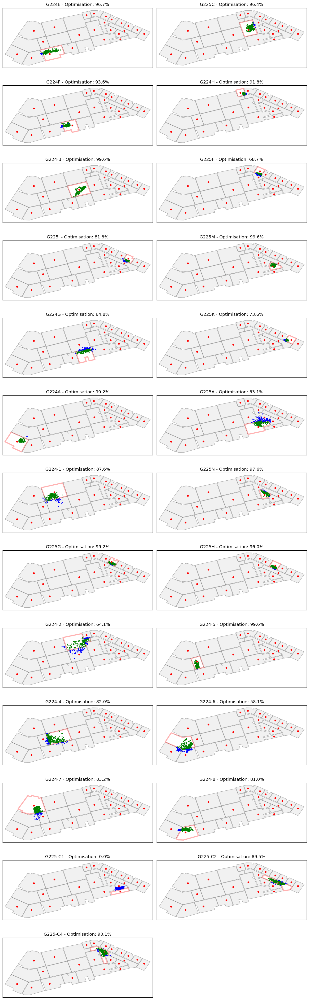

Overall Accuracy: 82.19%


,Room_name,Total_Points,Inside_Points,Accuracy
0,G224E,273,264,96.703297
1,G225C,251,242,96.414343
2,G224F,251,235,93.625498
3,G224H,245,225,91.836735
4,G224-3,246,245,99.593496
5,G225F,243,167,68.724280
6,G225J,313,256,81.789137
7,G225M,251,250,99.601594
8,G224G,253,164,64.822134
9,G225K,246,181,73.577236


In [ ]:
plot_building_with_zone_accuracy(df_rooms, res_particle, pred_col="Predicted_Optimisation")

In [ ]:
import numpy as np
import pandas as pd

class Kalman1D:
    def __init__(self, process_var=1.0, meas_var=4.0, initial_value=None):
        self.process_var = process_var  # Q: process variance
        self.meas_var = meas_var        # R: measurement variance
        self.posteri_estimate = initial_value
        self.posteri_error_estimate = 1.0

    def update(self, measurement):
        if self.posteri_estimate is None:
            self.posteri_estimate = measurement  # initialize with first measurement
            return self.posteri_estimate
        # Prediction step
        priori_estimate = self.posteri_estimate
        priori_error_estimate = self.posteri_error_estimate + self.process_var

        # Measurement update
        kalman_gain = priori_error_estimate / (priori_error_estimate + self.meas_var)
        self.posteri_estimate = priori_estimate + kalman_gain * (measurement - priori_estimate)
        self.posteri_error_estimate = (1 - kalman_gain) * priori_error_estimate
        return self.posteri_estimate



def particle_fusion_kalman(data_df, beacon_df, room_coords_array,
                            window_size=3, num_particles=3000,
                            time_decay=False, **kwargs):
    fused_results = []

    # Initialize Kalman filters for each beacon column
    kalman_filters = {}
    beacon_cols = [c for c in data_df.columns if c not in ['timestamp', 'tagId', 'Zone_id', 'Room_name']]
    for col in beacon_cols:
        kalman_filters[col] = Kalman1D(process_var=0.1, meas_var=2.0)

    # Group by tag + zone
    for (zone, tag), group in data_df.groupby(["Zone_id", "tagId"]):
        group = group.sort_values("timestamp").reset_index(drop=True)

        for i in range(len(group) - window_size + 1):
            window = group.iloc[i:i+window_size]

            fused_row = window.iloc[1].copy()  # middle packet metadata

            for col in beacon_cols:
                values = pd.to_numeric(window[col], errors="coerce").values
                valid_mask = values > -100
                valid = values[valid_mask]

                if len(valid) == 0:
                    fused_row[col] = -100
                    continue

                # Apply Kalman filter to each measurement
                smoothed_values = np.array([kalman_filters[col].update(v) for v in valid])

                # Simple mean over the smoothed values
                fused_row[col] = smoothed_values.mean()

            # Run particle filter on fused packet
            row_df = pd.DataFrame([fused_row])
            result_df = static_hybrid_monte_carlo_with_geo(
                data_df=row_df, beacon_df=beacon_df, room_coords_array=room_coords_array,
                num_particles=num_particles, **kwargs
            )

            if not result_df.empty:
                fused_results.append(result_df)

    if fused_results:
        return pd.concat(fused_results, ignore_index=True)
    else:
        return pd.DataFrame()


In [ ]:
result_kallman = particle_fusion_kalman(data_set_df, beacon_df, room_coords_array)

100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 18.56it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  8.26it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.74it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  9.37it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  9.74it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00,  9.51it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 10.79it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 13.39it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.66it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.78it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.79it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.93it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 26.70it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 24.30it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.42it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 14.74it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 10.30it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.24it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 11.30it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.70it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 11.43it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 10.12it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 17.93it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 16.66it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 16.83it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 23.52it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 15.77it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 18.34it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 27.30it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 12.47it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 13.95it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 11.23it/s]


100%|█████████████████████████████████████████████| 1/1 [00:00<00:00, 10.17it/s]


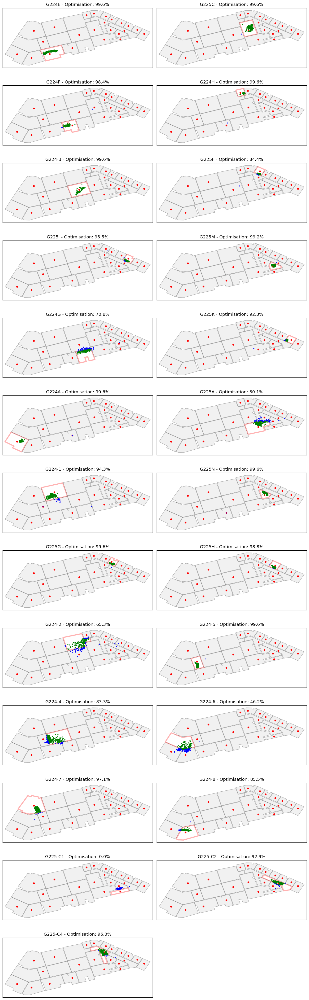

Overall Accuracy: 87.09%


,Room_name,Total_Points,Inside_Points,Accuracy
0,G224E,273,272,99.633700
1,G225C,251,250,99.601594
2,G224F,251,247,98.406375
3,G224H,245,244,99.591837
4,G224-3,246,245,99.593496
5,G225F,243,205,84.362140
6,G225J,313,299,95.527157
7,G225M,251,249,99.203187
8,G224G,253,179,70.750988
9,G225K,246,227,92.276423


In [ ]:
plot_building_with_zone_accuracy(df_rooms, result_kallman, pred_col="Predicted_Optimisation")

### Voting 5

In [49]:
def safe_eval(x):
    if isinstance(x, str):
        return literal_eval(x)
    return x

def compute_centroid(points):
    xs, ys = zip(*points)
    return [np.mean(xs), np.mean(ys)]

def compute_centroids_by_window(result, window_sizes=range(5, 6)):
    result = result.copy()

    # Always safely evaluate these
#     result['Predicted_MLE'] = result['Predicted_MLE'].apply(safe_eval)
#     result['Ground_Truth'] = result['Ground_Truth'].apply(safe_eval)
    result['Predicted_Optimisation'] = result['Predicted_Optimisation'].apply(safe_eval)

    # Check for fused
    has_fused = 'Predicted_Fused' in result.columns
    if has_fused:
        result['Predicted_Fused'] = result['Predicted_Fused'].apply(safe_eval)

    all_results = []

    for window_size in window_sizes:
        for (zone_id, room_name), group in result.groupby(['Zone_id', 'Room_name']):
            group = group.reset_index(drop=True)
            for i in range(len(group) - window_size + 1):
                window = group.iloc[i:i+window_size]

#                 mle_points = list(window['Predicted_MLE'])
                optimisation_points = list(window['Predicted_Optimisation'])
#                 ground_truth_points = list(window['Ground_Truth'])

#                 mle_centroid = compute_centroid(mle_points)
                optimisation_centroid = compute_centroid(optimisation_points)
#                 ground_truth_centroid = compute_centroid(ground_truth_points)

                # Build the result dict
                result_row = {
                    'Zone_id': zone_id,
                    'Room_name': room_name,
                    'Window_Size': window_size,
#                     'Predicted_MLE': mle_centroid,
                    'Predicted_Optimisation': optimisation_centroid,
#                     'Ground_Truth': ground_truth_centroid
                }

                if has_fused:
                    fused_points = list(window['Predicted_Fused'])
                    fused_centroid = compute_centroid(fused_points)
                    result_row['Predicted_Fused'] = fused_centroid

                all_results.append(result_row)

    centroid_df = pd.DataFrame(all_results)
    
    return centroid_df

In [50]:
results_optimiation= pd.read_csv("Result_Final/Optimisation_Orginal_Fast.csv")
df_sorted = results_optimiation.sort_values(by=["Zone_id", "timestamp"], ascending=[True, True])

# Reset index if you want a clean dataframe
df_sorted = df_sorted.reset_index(drop=True)

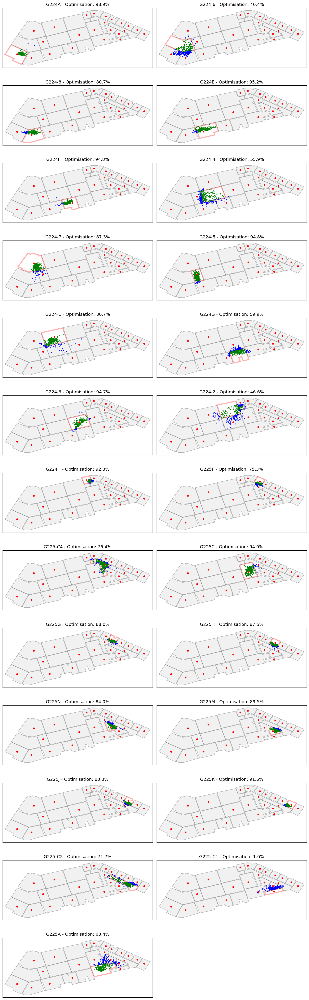

Overall Accuracy: 77.22%


,Room_name,Total_Points,Inside_Points,Accuracy
0,G224A,276,273,98.913043
1,G224-6,317,128,40.378549
2,G224-8,264,213,80.681818
3,G224E,289,275,95.155709
4,G224F,267,253,94.756554
5,G224-4,333,186,55.855856
6,G224-7,331,289,87.311178
7,G224-5,286,271,94.755245
8,G224-1,331,287,86.706949
9,G224G,269,161,59.851301


In [52]:
plot_building_with_zone_accuracy(df_rooms, results_optimiation, pred_col="Predicted_Optimisation")

In [53]:
vote5= compute_centroids_by_window(df_sorted, window_sizes=range(1, 11))


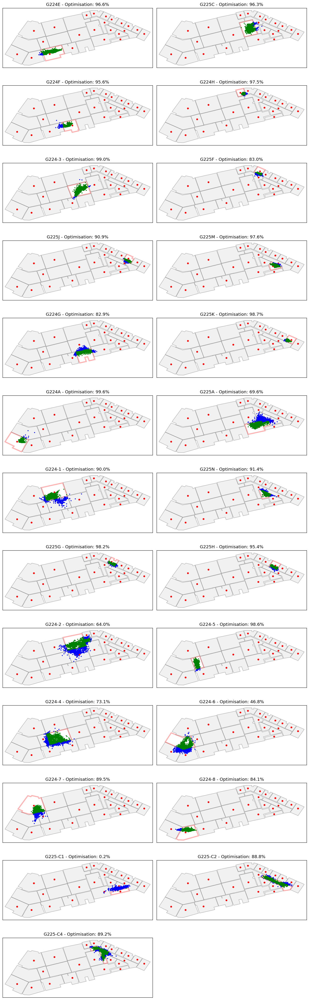

Overall Accuracy: 84.46%


In [54]:
v5 = plot_building_with_zone_accuracy(df_rooms, vote5, pred_col="Predicted_Optimisation")


In [55]:
v5.Accuracy.mean()

84.65292303110488

In [56]:
result.Zone_id.nunique()

25

In [57]:
vote5.head(1)

,Zone_id,Room_name,Window_Size,Predicted_Optimisation
0,37963,G224E,1,"[38.03091456952092, -78.49754761374595]"


In [70]:
def add_distance_error(results_df, df_rooms):
    """
    Adds distance error (to nearest room boundary), Correct flag, 
    and distance to room centroid for a results DataFrame.

    Parameters:
    - results_df: DataFrame with columns ['Room_name', 'Predicted_Optimisation', ...]
    - df_rooms: DataFrame with room polygons (x1,y1,...,x24,y24)

    Returns:
    - results_df: with new columns 
        'Distance_To_Boundary_m', 'Correct', 'Distance_To_Centroid_m'
    """
    import math
    import ast
    from shapely.geometry import Point, Polygon as ShapelyPolygon
    import numpy as np

    # Convert lat/lon to local meters
    def latlon_to_meters(lat_ref, lon_ref, lat, lon):
        R = 6378137
        dlat = math.radians(lat - lat_ref)
        dlon = math.radians(lon - lon_ref)
        lat_mean = math.radians((lat + lat_ref) / 2)
        x = R * dlon * math.cos(lat_mean)
        y = R * dlat
        return x, y

    # Reference point
    lat_ref = df_rooms.filter(like="y").min().min()
    lon_ref = df_rooms.filter(like="x").min().min()

    # Build polygons in meters
    room_coords_dict = {}
    for _, row in df_rooms.iterrows():
        coords_m = []
        for i in range(1, 25):
            xcol, ycol = f"x{i}", f"y{i}"
            if xcol in row and ycol in row:
                x, y = row[xcol], row[ycol]
                if pd.notnull(x) and pd.notnull(y):
                    xm, ym = latlon_to_meters(lat_ref, lon_ref, y, x)
                    coords_m.append((xm, ym))
        if len(coords_m) >= 3:
            poly = ShapelyPolygon(coords_m)
            room_coords_dict[row["Room_name"]] = poly

    # Compute distance errors
    distances_to_boundary = []
    correct_flags = []
    distances_to_centroid = []

    for _, row in results_df.iterrows():
        room_name = row["Room_name"]
        pred_coord = row["Predicted_Optimisation"]
        if isinstance(pred_coord, str):
            pred_coord = ast.literal_eval(pred_coord)
        lon, lat = float(pred_coord[1]), float(pred_coord[0])
        x_m, y_m = latlon_to_meters(lat_ref, lon_ref, lat, lon)
        pt = Point(x_m, y_m)

        if room_name not in room_coords_dict:
            distances_to_boundary.append(np.nan)
            correct_flags.append(0)
            distances_to_centroid.append(np.nan)
            continue

        polygon = room_coords_dict[room_name]

        # Distance to boundary
        if pt.within(polygon):
            distances_to_boundary.append(0.0)
            correct_flags.append(1)
        else:
            distances_to_boundary.append(polygon.exterior.distance(pt))
            correct_flags.append(0)

        # Distance to centroid
        centroid = polygon.centroid
        distances_to_centroid.append(pt.distance(centroid))

    results_df = results_df.copy()
    results_df["Distance_To_Boundary_m"] = distances_to_boundary
    results_df["Correct"] = correct_flags
    results_df["Distance_To_Centroid_m"] = distances_to_centroid

    return results_df

In [71]:
result_vote = add_distance_error(vote5, df_rooms)
result_vote.head(1)

,Zone_id,Room_name,Window_Size,Predicted_Optimisation,Distance_To_Boundary_m,Correct,Distance_To_Centroid_m
0,37963,G224E,1,"[38.03091456952092, -78.49754761374595]",0.0,1,2.932588


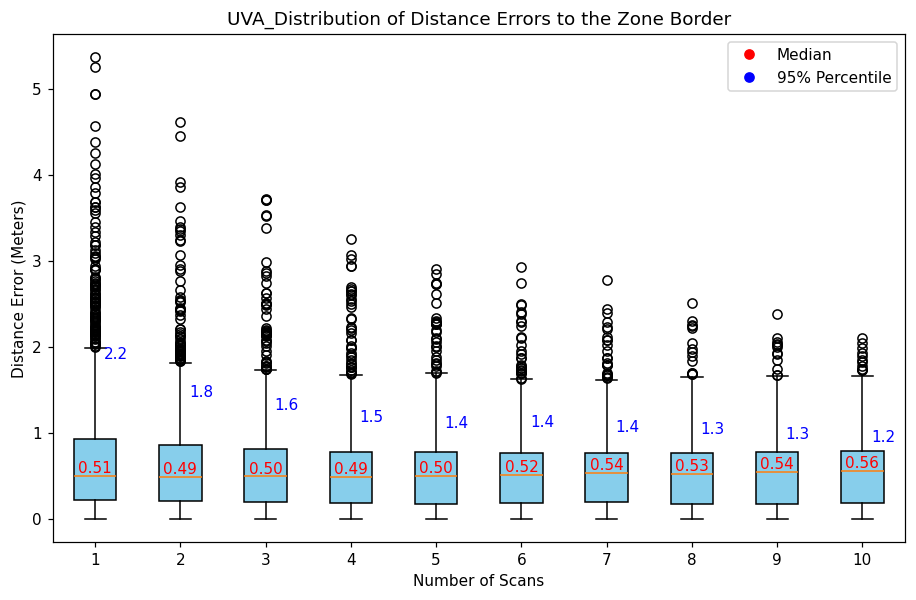

In [72]:
from matplotlib.lines import Line2D

outside_points = result_vote[result_vote['Distance_To_Boundary_m'] > 0]

grouped = outside_points.groupby('Window_Size')['Distance_To_Boundary_m']
data_to_plot = [group.values for _, group in grouped]
window_sizes = [str(w) for w, _ in grouped]

plt.figure(figsize=(10,6))
box = plt.boxplot(data_to_plot, labels=window_sizes, showfliers=True, patch_artist=True)

# Optional: color boxes
for patch in box['boxes']:
    patch.set_facecolor('skyblue')

# Annotate median values + 95th percentile
for i, (median_line, values) in enumerate(zip(box['medians'], data_to_plot)):
    # Median (centered)
    median = median_line.get_ydata()[0]
    plt.text(i+1, median, f"{median:.2f}",
             horizontalalignment='center',
             verticalalignment='bottom',
             color='red')

    # 95th percentile (shifted right + downward offset 0.2m)
    p95 = np.percentile(values, 95)
    plt.text(i+1 + 0.1, p95 - 0.2, f"{p95:.1f}",
             horizontalalignment='left',
             verticalalignment='top',
            
             color='blue')

# Add legend for text colors
legend_elements = [
    Line2D([0], [0], color='red', marker='o', linestyle='None', label='Median'),
    Line2D([0], [0], color='blue', marker='o', linestyle='None', label='95% Percentile')
]
plt.legend(handles=legend_elements, loc='upper right')

plt.xlabel("Number of Scans")
plt.ylabel("Distance Error (Meters)")
plt.title("UVA_Distribution of Distance Errors to the Zone Border")
plt.grid(False)
plt.show()


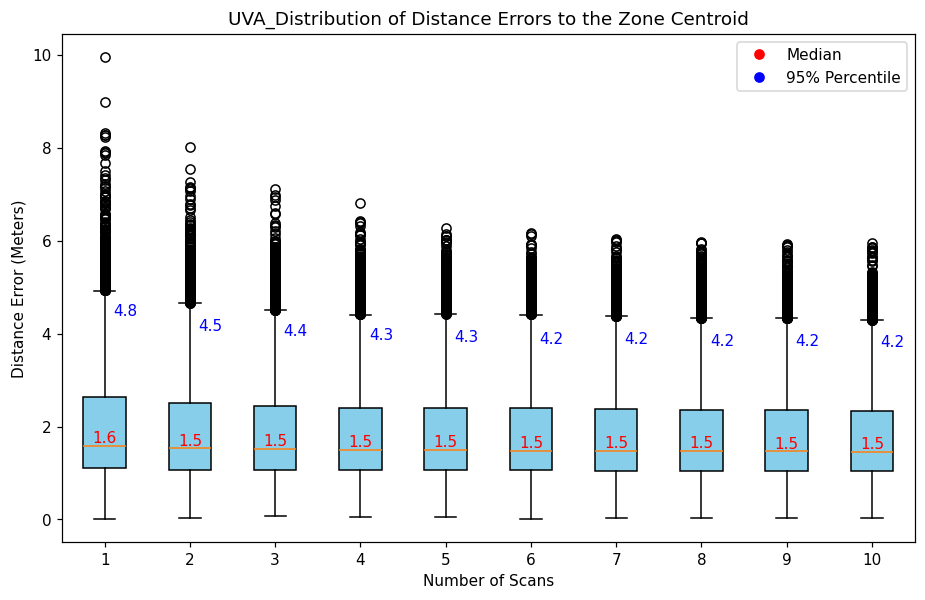

In [73]:
outside_points = result_vote[result_vote['Distance_To_Centroid_m'] > 0]

grouped = outside_points.groupby('Window_Size')['Distance_To_Centroid_m']
data_to_plot = [group.values for _, group in grouped]
window_sizes = [str(w) for w, _ in grouped]

plt.figure(figsize=(10,6))
box = plt.boxplot(data_to_plot, labels=window_sizes, showfliers=True, patch_artist=True)

# Optional: color boxes
for patch in box['boxes']:
    patch.set_facecolor('skyblue')

# Annotate median values + 95th percentile
for i, (median_line, values) in enumerate(zip(box['medians'], data_to_plot)):
    # Median (centered)
    median = median_line.get_ydata()[0]
    plt.text(i+1, median, f"{median:.1f}",
             horizontalalignment='center',
             verticalalignment='bottom',
             color='red')

    # 95th percentile (shifted right + downward offset 0.2m)
    p95 = np.percentile(values, 95)
    plt.text(i+1 + 0.1, p95 - 0.2, f"{p95:.1f}",
             horizontalalignment='left',
             verticalalignment='top',
            
             color='blue')

# Add legend for text colors
legend_elements = [
    Line2D([0], [0], color='red', marker='o', linestyle='None', label='Median'),
    Line2D([0], [0], color='blue', marker='o', linestyle='None', label='95% Percentile')
]
plt.legend(handles=legend_elements, loc='upper right')

plt.xlabel("Number of Scans")
plt.ylabel("Distance Error (Meters)")
plt.title("UVA_Distribution of Distance Errors to the Zone Centroid")
plt.grid(False)
plt.show()

In [75]:
import ast
from shapely.geometry import Point, Polygon as ShapelyPolygon

def compute_zone_window_accuracy(df_rooms, results_df, pred_col="Predicted_Optimisation"):

    # --- Build polygons for each room ---
    room_coords_dict = {}
    for _, row in df_rooms.iterrows():
        coords = []
        for i in range(1, 25):  # assuming up to 24 vertices
            xcol, ycol = f"x{i}", f"y{i}"
            if xcol in row and ycol in row:
                x, y = row[xcol], row[ycol]
                if pd.notnull(x) and pd.notnull(y):
                    coords.append((float(x), float(y)))
        if len(coords) >= 3:
            room_coords_dict[row['Room_name']] = ShapelyPolygon(coords)

    summary_records = []

    # --- Iterate over each row in results_df ---
    for _, row in results_df.iterrows():
        room_name = row["Room_name"]
        zone_id = row["Zone_id"]
        window_size = row["Window_Size"]
        coord = row[pred_col]

        if isinstance(coord, str):
            try:
                coord = ast.literal_eval(coord)
            except Exception:
                coord = None

        if coord is None or not isinstance(coord, (list, tuple)) or len(coord) != 2:
            continue

        # coords are stored as [lat, lon] -> swap to (lon, lat)
        lon, lat = float(coord[1]), float(coord[0])

        inside_flag = False
        if room_name in room_coords_dict:
            polygon = room_coords_dict[room_name]
            if polygon.is_valid and Point(lon, lat).within(polygon):
                inside_flag = True

        summary_records.append({
            "Zone_id": zone_id,
            "Room_name": room_name,
            "Window_Size": window_size,
            "Inside": int(inside_flag),
            "Total": 1
        })

    # --- Aggregate results ---
    if not summary_records:
        return pd.DataFrame(columns=["Zone_id", "Room_name", "Window_Size", "Accuracy"])

    summary_df = pd.DataFrame(summary_records)
    grouped = (
        summary_df.groupby(["Zone_id", "Room_name", "Window_Size"])
        .agg({"Inside": "sum", "Total": "sum"})
        .reset_index()
    )
    grouped["Accuracy"] = grouped["Inside"] / grouped["Total"] * 100

    return grouped


In [76]:
result_vote= compute_zone_window_accuracy(df_rooms, vote5, pred_col="Predicted_Optimisation").\
            merge(zones[["Room_name", "Room_Type"]], on ="Room_name", how="left")

zone_no_beacon= ['G224-2', 'G224-4', 'G224-6', 'G224G']
result_vote['Has_Beacon'] = result_vote['Room_name'].apply(lambda x: "No" if x in zone_no_beacon else "Yes")
result_vote.head()

,Zone_id,Room_name,Window_Size,Inside,Total,Accuracy,Room_Type,Has_Beacon
0,37963,G224E,1,275,289,95.155709,Room,Yes
1,37963,G224E,2,276,288,95.833333,Room,Yes
2,37963,G224E,3,276,287,96.167247,Room,Yes
3,37963,G224E,4,277,286,96.853147,Room,Yes
4,37963,G224E,5,274,285,96.140351,Room,Yes


In [77]:
result_vote.groupby(["Window_Size","Has_Beacon"]).Accuracy.mean()

Window_Size  Has_Beacon
1            No            50.669154
             Yes           82.451565
2            No            60.354529
             Yes           86.123550
3            No            64.094723
             Yes           87.386599
4            No            66.027444
             Yes           87.880746
5            No            67.913219
             Yes           88.319562
6            No            70.125826
             Yes           88.996632
7            No            71.224075
             Yes           89.649694
8            No            71.259477
             Yes           89.666118
9            No            72.062055
             Yes           90.032460
10           No            73.743939
             Yes           90.462843
Name: Accuracy, dtype: float64

In [79]:
result_vote.groupby(["Window_Size","Has_Beacon", "Room_Type"]).Accuracy.mean()

Window_Size  Has_Beacon  Room_Type
1            No          Open         47.608438
                         Room         59.851301
             Yes         Open         76.954586
                         Room         86.574299
2            No          Open         56.094595
                         Room         73.134328
             Yes         Open         80.692516
                         Room         90.196826
3            No          Open         59.492090
                         Room         77.902622
             Yes         Open         81.682467
                         Room         91.664698
4            No          Open         60.718297
                         Room         81.954887
             Yes         Open         82.420597
                         Room         91.975858
5            No          Open         62.752217
                         Room         83.396226
             Yes         Open         82.565856
                         Room         92.634841
6    

In [63]:
result_vote[(result_vote.Has_Beacon=="No") & (result_vote.Window_Size==1)].Accuracy.mean()

50.66915373947641

In [64]:
zone_no_beacon= ['G224-2', 'G224-4', 'G224-6', 'G224G']

In [65]:
def plot_accuracy_by_window(summary_df):
    
    overall = summary_df.groupby("Window_Size").apply(
        lambda x: (x["Inside"].sum() / x["Total"].sum()) * 100
    ).reset_index(name="Accuracy")

    plt.figure(figsize=(10, 6))
    plt.plot(overall["Window_Size"], overall["Accuracy"], marker="o", label="Overall Accuracy", linewidth=2, color="black")
    
    # --- Accuracy per Room_Type + Has_Beacon ---
    room_types = summary_df["Room_Type"].unique()
    for rt in room_types:
        for beacon_status in ["Yes", "No"]:
            df_rt = summary_df[(summary_df["Room_Type"] == rt) & (summary_df["Has_Beacon"] == beacon_status)]
            if df_rt.empty:
                continue
            acc_rt = df_rt.groupby("Window_Size").apply(
                lambda x: (x["Inside"].sum() / x["Total"].sum()) * 100
            ).reset_index(name="Accuracy")
            label = f"{rt} - {'Has Beacon' if beacon_status=='Yes' else 'No Beacon'}"
            plt.plot(acc_rt["Window_Size"], acc_rt["Accuracy"], marker="o", label=label)
    
    plt.xlabel("Number of Data Packets")
    plt.ylabel("Accuracy (%)")
    plt.title("Accuracy vs Number of Data Packets")
    plt.xticks(overall["Window_Size"].unique())
#     plt.ylim(60, 100)
    plt.grid(True, linestyle="--", alpha=0.5)
    plt.legend()
    plt.tight_layout()

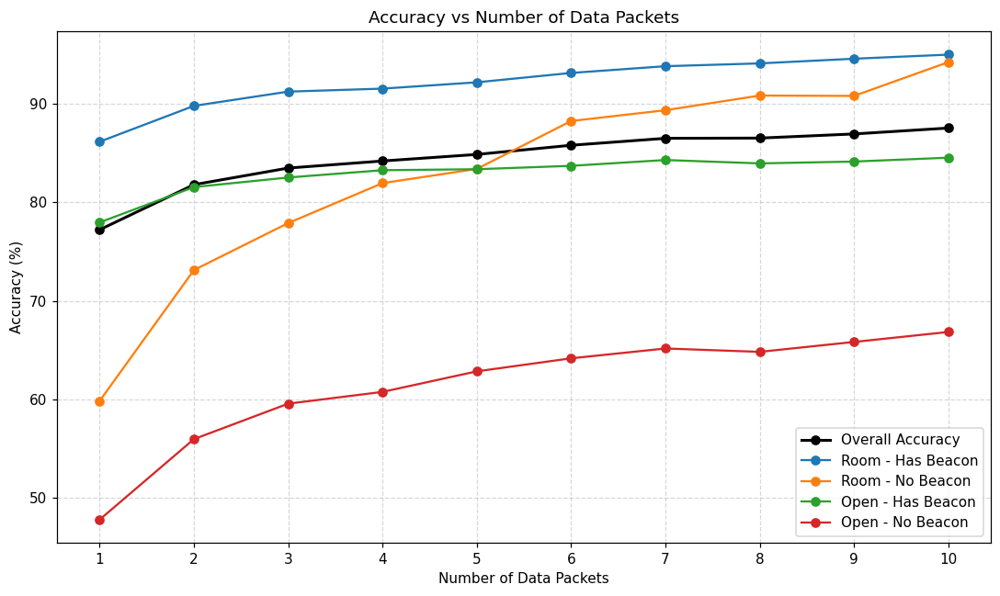

In [66]:
plot_accuracy_by_window(result_vote)

In [69]:
result_vote.to_csv("result_vote_uva.csv", index= False)

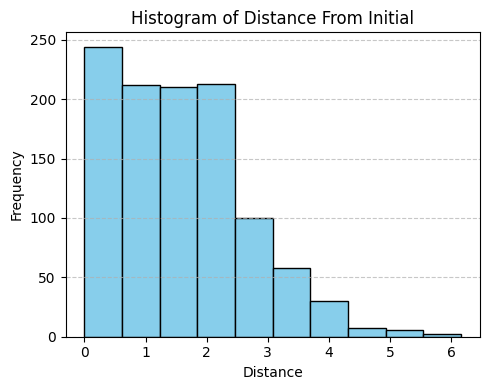

In [ ]:
# Plot the histogram
plt.figure(figsize=(5, 4))
plt.hist(results['Distance_From_Initial'], bins=10, edgecolor='black', color='skyblue')
plt.title('Histogram of Distance From Initial')
plt.xlabel('Distance')
plt.ylabel('Frequency')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()

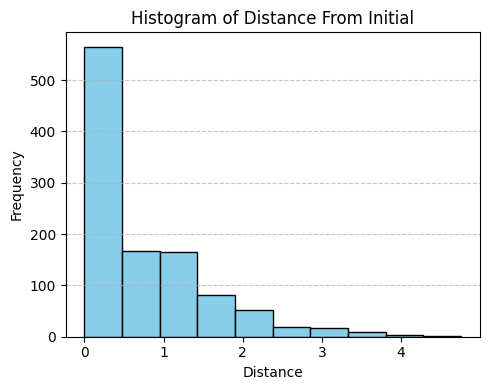

In [ ]:
# Plot the histogram
plt.figure(figsize=(5, 4))
plt.hist(results_df['Refinement_Shift'], bins=10, edgecolor='black', color='skyblue')
plt.title('Histogram of Distance From Initial')
plt.xlabel('Distance')
plt.ylabel('Frequency')
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()